<a href="https://colab.research.google.com/github/Mike-Pits/NU-Stazhirovki-Qazaq/blob/main/Final_Pipeline.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Загрузка библиотек**

In [ ]:
%%capture
!pip install autokeras
!pip install deskew
!pip install easyocr
!pip install ultralytics
!pip install -q transformers

import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as patches

import re
import cv2
import json
import math
import time
import os
import shutil
import random
import easyocr
import torch
import logging

from collections import Counter
from copy import deepcopy
from deskew import determine_skew
from autokeras import CUSTOM_OBJECTS
from ultralytics import YOLO
from IPython.display import clear_output, display_html, display
from transformers import AutoModelForObjectDetection, DetrImageProcessor, TableTransformerForObjectDetection
from PIL import Image
from torchvision import transforms
from matplotlib.patches import Patch
from functools import wraps

In [ ]:
import gdown

from google.colab import drive # Подключаем google диск
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# **Скачивание моделей и добавление путей в env**

In [ ]:
# Создаем необходимые директории
folders_dict = {'model':            '/content/models_weights/',
                'easyocr/model':    '/content/EasyOCR/model/',
                'easyocr/network':  '/content/EasyOCR/user_network/',}

for folder in folders_dict.values():
    os.makedirs(folder, exist_ok=True)

# Загрузка весов для всех моделей и добавление путей в переменные окружения
models_paths_dict = {
    'ROT_MODEL':["rotate_model.h5", folders_dict['model'], "https://drive.google.com/uc?id=1-55CTgo7vJAh0Pv2M_dFwAp-ytKf84lF"],
    'YOLO_B':   ['best_B.pt',       folders_dict['model'],"https://drive.google.com/uc?id=1BKVf2jXVi7d5FdfrvHypzbWwLMDGlhCP"],
    'YOLO_B20': ['best_B_20.pt',    folders_dict['model'],"https://drive.google.com/uc?id=13gNfoWcSBIV0Vc6zAwP8i4HnwsuOP7l8"],
    'YOLO_B22': ['best_B_22.pt',    folders_dict['model'],"https://drive.google.com/uc?id=1fZY35T0ZFknj2f8nqxOhcqiPI52cLP06"],
    'YOLO_TABLE':['best_cell.pt',   folders_dict['model'],"https://drive.google.com/uc?id=1U8pq3hIdIdlpRdRzcpGdaACZKjIAeigY"],
    'EASYOCR_YAML':['custom_ocr.yaml', folders_dict['easyocr/network'], 'https://drive.google.com/uc?id=14DLULWAkr4qXX1YnsoN5vK-nNk9Cwbz5'],
    'EASYOCR_CUSTOM_PY':["custom_ocr.py", folders_dict['easyocr/network'], 'https://drive.google.com/uc?id=1dP1OepFEaLEI2YJkz0HQZzijIkhNhqVX'],
    'EASYOCR_MODEL':['custom_ocr.pth', folders_dict['easyocr/model'], 'https://drive.google.com/uc?id=1ah6UJnx6WSpv5l9trVydHl7l-qa_jhio'],
}

In [ ]:
# Копирование моделей с google-диска
# Названия файлов должны соответсвовать названиям из models_paths_dict!!!
models_folder = '/content/drive/MyDrive/Модели/'   # Добавление моделей с диска

def copy_file_to_folder(file_path, destination_folder):
    try:
        # Получаем только имя файла из полного пути
        file_name = os.path.basename(file_path)

        # Создаем полный путь для нового файла в папке
        destination_path = os.path.join(destination_folder, file_name)

        # Копируем файл
        shutil.copy2(file_path, destination_path)

        print(f"Файл '{file_name}' успешно скопирован в '{destination_folder}'.")
    except FileNotFoundError:
        print("Ошибка: Указанный файл не найден.")
    except IsADirectoryError:
        print("Ошибка: Указанный путь - это директория, а не файл.")
    except Exception as e:
        print(f"Произошла ошибка: {str(e)}")

# Проходимся по списку файлов
for filename in os.listdir(models_folder):
    for model_name, model_list in models_paths_dict.items():
        if filename == model_list[0]:   # Если название файла совпадает
            copy_file_to_folder(models_folder + filename, model_list[1])

Файл 'custom_ocr.py' успешно скопирован в '/content/EasyOCR/user_network/'.
Файл 'custom_ocr.pth' успешно скопирован в '/content/EasyOCR/model/'.
Файл 'custom_ocr.yaml' успешно скопирован в '/content/EasyOCR/user_network/'.
Файл 'best_cell.pt' успешно скопирован в '/content/models_weights/'.
Файл 'best_B.pt' успешно скопирован в '/content/models_weights/'.
Файл 'best_B_20.pt' успешно скопирован в '/content/models_weights/'.
Файл 'best_B_22.pt' успешно скопирован в '/content/models_weights/'.
Файл 'rotate_model.h5' успешно скопирован в '/content/models_weights/'.


In [ ]:
# Скачивание моделей (ошибка gdown)
# for env_name, link_name_list in models_paths_dict.items():
#     i = 1
#     while i != 3:
#         print(f'{env_name} (Попытка #{i})')
#         try:
#             gdown.download(link_name_list[2], link_name_list[1] + link_name_list[0], fuzzy=True)
#             os.environ[env_name] = link_name_list[1] + link_name_list[0]
#             clear_output()
#             break
#         except:
#             time.sleep(1.5)
#             clear_output()
#             i += 1

In [ ]:
# добавляем только пути в env
for env_name, link_name_list in models_paths_dict.items():
    os.environ[env_name] = link_name_list[1] + link_name_list[0]

In [ ]:
# Добавляем значение о наличии gpu
os.environ['EASYOCR_GPU'] = 'GPU available' if tf.test.gpu_device_name() else ''
print('GPU: {}'.format(tf.test.gpu_device_name() if bool(os.environ.get('EASYOCR_GPU')) else 'Не обнаружен'))

GPU: /device:GPU:0


# **Классы**

## ModelsHub, ImageDTO, Context и др.

In [ ]:
# Синглтон для однократной загрузки моделей
# Данный класс будет инициироваться при старте приложения
# И далее не будет требоваться время на загрузку моделей
# Каждый раз при создании экземпляра класса возвращается один объект
# Можно расширять, сколько надо, подгружая модели
# open–closed principle, OCP
class ModelsHub:
    _instance = None

    def __new__(cls):
        if cls._instance is None:
            cls._instance = super(ModelsHub, cls).__new__(cls)

            # Инициализация моделей здесь
            cls._instance.rotate_model = cls.load_rotate_model()
            cls._instance.yolo_b = cls.load_yolo_model('YOLO_B')
            cls._instance.yolo_b20 = cls.load_yolo_model('YOLO_B20')
            cls._instance.yolo_b22 = cls.load_yolo_model('YOLO_B22')
            cls._instance.yolo_table = cls.load_yolo_model('YOLO_TABLE')
            cls._instance.ocr_reader = cls.load_ocr_reader()
            cls._instance.transformer_table_detection = cls.load_table_transformer_detection()
            cls._instance.transformer_structure_recognition = cls.load_table_structure_recognition()

            # Если есть gpu, то следует перенести модель на графический процессор
            device = "cuda" if torch.cuda.is_available() else "cpu"
            cls._instance.transformer_table_detection.to(device)
            cls._instance.transformer_structure_recognition.to(device)

        return cls._instance

    @staticmethod
    def load_rotate_model():
        weights_path = os.environ.get('ROT_MODEL')
        return tf.keras.models.load_model(weights_path, custom_objects=CUSTOM_OBJECTS)

    @staticmethod
    def load_yolo_model(env_name):
        model_path = os.environ.get(env_name)
        return YOLO(model_path)

    @staticmethod
    def load_ocr_reader():
        reader_ocr = easyocr.Reader(['en'],
            model_storage_directory='EasyOCR/model',
            user_network_directory='EasyOCR/user_network',
            recog_network='custom_ocr',
            gpu=bool(os.environ.get('EASYOCR_GPU')),
            verbose=False,
            )

        return reader_ocr

    @staticmethod
    def load_table_transformer_detection():
        model_name = "microsoft/table-transformer-detection"
        return AutoModelForObjectDetection.from_pretrained(model_name, revision="no_timm")

    @staticmethod
    def load_table_structure_recognition():
        model_name = "microsoft/table-structure-recognition-v1.1-all"
        return TableTransformerForObjectDetection.from_pretrained(model_name)

    def iterate_models(self, model_names):
        return [getattr(self, model_name) for model_name in model_names if hasattr(self, model_name)]

In [ ]:
# Контекст является объектом хранящим данных и конфигурации
# И изменяемым в процессе прохождения через пайплайн
class Context:
    def __init__(self, models, images, processing_params = {}, metadata = {}):
    # def __init__(self, models: ModelsHub, images: List[ImageDTO], processing_params: dict = {}, metadata: dict = {}):
        self.images = images
        self.models = models
        self.processing_params = processing_params
        self.metadata = metadata

  # может содержать методы сигнализирующие об ошибке обработки
  # а также методы агрегирующие разультат
  # напириер конечный результат после завершения обработки

In [ ]:
# Data Transfer Object (DTO)
# Объект изображения включающий все методы по работе с изображением
class ImageDTO:
    # переменные которые нельзя менять через set_attr
    PROTECTED_ATTRIBUTES = ['path', 'name', 'prepared_img', 'raw']

    def __init__(self, path, name):
        self.path = path
        self.name = name
        self.raw = cv2.imread(path + name, cv2.IMREAD_UNCHANGED)
        self.raw_preprocessed = None
        self.prepared_img = None

        self.preprocessed_rotation_angle = None
        self.time_to_process = dict()   # Для сохранения времени на обработку

    @staticmethod
    def preprocess_for_rot_model(img):
        """Функция предобработки изображения для модели нахождения поворота."""
        target_size = (224, 224)

        if len(img.shape) == 3: # Если изображение цветное
            img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        img = cv2.resize(img, target_size, interpolation=cv2.INTER_AREA)
        img = img / 255.0

        # Увеличиваем размерности
        img = np.expand_dims(img, axis=2)
        img = np.expand_dims(img, axis=0)

        return img

    @staticmethod
    def get_img_for_yolo(img):
        if img is not None:
            return np.stack((img,)*3, axis=-1)
        else:
            return None

    def get_crop_array(self, box):
        x1, y1, x2, y2 = box
        return self.raw_preprocessed[int(y1):int(y2), int(x1):int(x2)]

    # метод установки значения атрибутов
    def set_attr(self, attribute_name, value):
        if attribute_name in ImageDTO.PROTECTED_ATTRIBUTES:
            print(f"Ошибка: Нельзя изменять атрибут '{attribute_name}'.")
            return
        setattr(self, attribute_name, value)

    def __str__(self):
        variable_names = '\n'.join(vars(self).keys())
        return f"Variables:\n{variable_names}"

In [ ]:
class CodeTimer:
    def __enter__(self):
        self.start_time = time.time()
        return self

    def __exit__(self, exc_type, exc_val, exc_tb):
        self.end_time = time.time()
        self.execution_time = self.end_time - self.start_time

    def get_execution_time(self):
        return self.execution_time

## Классы пайплайна (процессоры)

In [ ]:
# Класс BaseProcessor служит в качестве абстрактного базового класса для всех процессоров
# в системе обработки данных.
# Он определяет обязательный метод process, который должен быть реализован во всех классах-наследниках.
# Этот метод принимает объект context, который содержит все необходимые данные и состояния, передаваемые между процессорами.
class BaseProcessor:
    def __init__(self, logger):
        self.logger = logger

    def process(self, context):
        raise NotImplementedError("Each processor must implement the 'process' method.")

    def start_process(self, context):
        self.logger.info(f"Начало обработки в {self.__class__.__name__}.")
        context = self.process(context)
        self.logger.info(f"Обработка в {self.__class__.__name__} завершена.")

        return context

In [ ]:
class PreProcessor(BaseProcessor):
    """
    Конвертирует изображение в .png формат.
    Поворачивает изображение на найденный угол через модель нахождения поворота
    и deskew.
    Устанавливает размер по высоте 3508 px, и пропорционально увеличивает ширину.
    Сохраняет изображение в папке output_folder.
    """
    def __init__(self, logger):
        super().__init__(logger)

    def process(self, context):
        for img_idx, img_cls in enumerate(context.images):
            with CodeTimer() as timer:
                if img_cls.raw is None:
                    print(f'Ошибка при чтении файла по пути {img_cls.path}{img_cls.name}')
                    continue

                # Конвертируем в .png
                _, img = cv2.imencode('.png', img_cls.raw)
                img = cv2.imdecode(img, cv2.IMREAD_UNCHANGED)

                # Нахождение угла поворота на изображении 0°,90°,-90°,180°
                img_for_rot_model = img_cls.preprocess_for_rot_model(img)
                rot_model_result = context.models.rotate_model.predict(img_for_rot_model, verbose=False)
                instant_angle_model = [0, 90, -90, 180][np.argmax(rot_model_result)]

                # Находим ширину, высоту и соотношение сторон
                height, width = img.shape[0], img.shape[1]
                aspect_ratio = width / height

                # Поворот на 90°,-90°,180°
                if instant_angle_model in [90,-90]:
                    height, width = width, height

                instant_angle_cv2 = {90:cv2.ROTATE_90_CLOCKWISE, -90:cv2.ROTATE_90_COUNTERCLOCKWISE, 180:cv2.ROTATE_180}
                if instant_angle_model != 0:
                    img = cv2.rotate(img, instant_angle_cv2[instant_angle_model])

                # Нахождения угла поворота -45° - 45°
                deskew_angle = determine_skew(img)

                if deskew_angle != 0:
                    # Выравнивание, поворот в пределах -45° - 45°
                    rotate_matrix = cv2.getRotationMatrix2D(center=(width/2, height/2), angle=deskew_angle, scale=1)
                    img = cv2.warpAffine(src=img, M=rotate_matrix, dsize=(width, height), flags=cv2.INTER_LINEAR)

                # Определение новой высоты и ширины изображения
                new_height = 3508
                width = int(new_height * aspect_ratio)

                # Изменение размера с сохранением пропорций
                interpolation_mode = cv2.INTER_AREA if height > new_height else cv2.INTER_CUBIC
                img = cv2.resize(img, (width, new_height), interpolation=cv2.INTER_AREA)

                # Преобразовываем в чёрно-белый формат
                if len(img.shape) == 3: # Если изображение цветное
                    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

                # Сохраняем предобработанное изображение и угол поворота
                img_cls.set_attr('raw_preprocessed', img)
                img_cls.set_attr('preprocessed_rotation_angle', {'deskew':deskew_angle, 'rot_model':instant_angle_model})

                context.images[img_idx] = img_cls   # Заменяем объект в контексте

            img_cls.time_to_process['PreProcessor'] = timer.get_execution_time()

        return context

In [ ]:
class NeuralNetworkPredictor(BaseProcessor):
    """
    Находит боксы моделями yolo_b, yolo_b20, yolo_b22,
    а также бокс таблицы моделью transformer_table_detection
    """

    def __init__(self, logger):
        super().__init__(logger)

        self.model_names = ['transformer_table_detection', "yolo_b", "yolo_b20", "yolo_b22"]
        self.classes_for_models = {"yolo_b20":"20 Top Block", "yolo_b22":"22 Bottom Block"}

        # Ожидаемые классы от моделей
        self.expected_classes = {
            'yolo_b':["20 Top Block","21 Middle Block", "22 Bottom Block"],
            'yolo_b20':["01 Receipt","04-01 Counterparty 1", "04-02 Counterparty 2",
                        "06 Our Company","07 Counterparty Bank BIC",
                        "08 Counterparty Current Account IIC",
                        "09 Counterparty Payment Purpose Code"],
            'yolo_b22':["05 Contract", "06 Our Company","10 Items Table",
                        "10-01 Item", "10-02 Unit","10-03 Quantity",
                        "10-04 Price", "10-05 Amount"],}

        # Названия классов которые нужно расширить по всей длинне изображения
        self.long_boxes_names = ["01 Receipt", "06 Our Company", "04-02 Counterparty 2", "05 Contract"]

        # Отступ для бокса таблицы из модели table_transformer
        self.table_box_padding = 35


    def resize_box(self, box, orig_img_box):
        x1 = box[0] + orig_img_box[0]
        y1 = box[1] + orig_img_box[1]
        x2 = box[2] + orig_img_box[0]
        y2 = box[3] + orig_img_box[1]

        return [x1, y1, x2, y2]

    def get_boxes_xy(self, result):
        try:
            box_xy = list(result.boxes.numpy().xyxy)
        except:
            box_xy = list(result.boxes.cpu().numpy().xyxy)

        return box_xy

    def preprocess_yolo_boxes(self, models, img_cls, model_name):
        """
        Функция для предобработки боксов для всех моделей. Если модель нашла больше
        одного бокса на класс, то выбирает бокс с максимальным confidence. Расширяет
        определённые боксы по длинне всего изображения.

        Входные данные:
        models: класс Context
        img_cls: объект изображения ImageDTO.
        model_name: название модели YOLOv8 из списка ['yolo_b','yolo_b20','yolo_b22'] (str).

        Выходные данные:
        img_cls: объект изображения ImageDTO.
        """

        result = getattr(img_cls, model_name + '_result')

        # Получаем информацию о найденных боксах и их классах
        all_classes = getattr(models, model_name).names                     # Названия всех классов
        detected_classes = [int(i) for i in result.boxes.cls]               # Классы найденных боксов на изображении (индекс)
        detected_classes_names = [all_classes[i] for i in detected_classes] # Классы найденных боксов на изображении (название класса)
        detected_confidence = [float(i) for i in result.boxes.conf]         # Confidence найденных боксов на изображении

        reports = {'Найденные yolo классы':Counter(detected_classes_names)}

        # Получаем координаты боксов
        boxes_xy = self.get_boxes_xy(result)

        # Оставляем кропы с самым большим confidence по классам
        for class_name in all_classes.values():
            indices = [index for index, value in enumerate(detected_classes_names) if value == class_name]

            # Если найдено больше одиного экземпляра класса
            if len(indices) > 1:
                # Находим максимальный confidence
                confidence_list = [detected_confidence[i] for i in indices]
                max_confidence = max(confidence_list)
                best_confidence_idx = detected_confidence.index(max_confidence)
                del_idx_list = [i for i in indices if i != best_confidence_idx]

                # Оставляем только нужные боксы c большим confidence
                detected_classes_names = [val for i, val in enumerate(detected_classes_names) if i not in del_idx_list]
                detected_confidence = [val for i, val in enumerate(detected_confidence) if i not in del_idx_list]
                boxes_xy = [val for i, val in enumerate(boxes_xy) if i not in del_idx_list]

        # Находим нужные значения для отчёта
        reports['Финальные классы'] = dict(Counter(detected_classes_names))
        reports['Ожидаемое число классов'] = len(self.expected_classes[model_name])
        reports['Пропущенные классы'] = [class_name for class_name in self.expected_classes[model_name] if class_name not in reports['Финальные классы']]
        reports['Финальное число классов'] = len(self.expected_classes[model_name]) - len(reports['Пропущенные классы'])

        # Делаем кропы боксов
        expanded_boxes = [] # Список для расширенных боксов

        # Расширяем определённые боксы
        if model_name != 'yolo_b' and len(result) > 0:
            yolo_b_boxes = getattr(img_cls, 'yolo_b_boxes')
            crop_box = yolo_b_boxes[self.classes_for_models[model_name]][0]
            img_width = crop_box[2] - crop_box[0]

            for class_n in self.long_boxes_names:
                if class_n in detected_classes_names:
                    box_index = detected_classes_names.index(class_n)
                    boxes_xy[box_index][0] = 0
                    boxes_xy[box_index][2] = img_width
                    expanded_boxes.append(class_n)

        reports['Расширенные боксы'] = expanded_boxes

        # Сохраняем координаты боксов в словарь
        boxes_dict = {detected_classes_names[i]:box_xy for i, box_xy in enumerate(boxes_xy)}

        # Переводим боксы к формату исходного изображения
        if model_name != 'yolo_b':
            boxes_dict = {class_name:self.resize_box(box, yolo_b_boxes[self.classes_for_models[model_name]][0]) for class_name, box in boxes_dict.items()}

        boxes = {class_name:[boxes_dict[class_name], confidence] for class_name, confidence in zip(detected_classes_names, detected_confidence)}
        additional_boxes = dict()

        # Расширяем бокс "22 Bottom Block", если модель table-transformer'а нашла нижнюю таблицу
        if model_name == 'yolo_b':
            tab_result = getattr(img_cls, 'transformer_table_detection_result')

            if tab_result is not None and len(tab_result) > 0:
                if "22 Bottom Block" in boxes:
                    additional_boxes["22 Bottom Block orig"] = deepcopy(boxes["22 Bottom Block"])

                    # Находим лучший бокс для модели transformer_table
                    best_tab_box = FinalBoxConstructor.get_best_bottom_table_box(tab_result, boxes["22 Bottom Block"][0])
                    if best_tab_box != None:
                        best_tab_box, best_tab_box_conf = best_tab_box['10 Items Table 2']

                        # Добавляем padding боксу '10 Items Table 2'
                        best_tab_box = FinalBoxConstructor.get_box_with_padding(best_tab_box, img_cls.raw_preprocessed.shape, padding=self.table_box_padding)
                        additional_boxes["Bottom Table"] = [np.array(best_tab_box), best_tab_box_conf]

                        boxes["22 Bottom Block"][0] = FinalBoxConstructor.get_merged_table_box(boxes["22 Bottom Block"][0], best_tab_box)
                        reports['Бокс "22 Bottom Block"'] = 'Расширен по боксу модели table-transformer'

                    else:
                        reports['Бокс "22 Bottom Block"'] = 'Без изменений. (table-transformer не нашёл таблицу)'

                else:
                    # Получаем лучший бокс таблицы
                    best_tab_box = FinalBoxConstructor.get_best_table_box(tab_result)

                    # Добавляем padding боксу '10 Items Table 2'
                    best_tab_box = FinalBoxConstructor.get_box_with_padding(best_tab_box, img_cls.raw_preprocessed.shape, padding=self.table_box_padding)

                    boxes["22 Bottom Block"] = {"22 Bottom Block":[best_tab_box, best_tab_box_conf]} # Добавляем бокс, если его небыло
                    reports['Бокс "22 Bottom Block"'] = 'Добавлен из модели table-transformer'

            else:
                reports['Бокс "22 Bottom Block"'] = 'Без изменений. (table-transformer не нашёл таблицу)'


        # Добавляем новые значения в ImageDTO
        img_cls.set_attr(model_name + '_boxes', boxes)
        img_cls.set_attr(model_name + '_report', reports)
        img_cls.time_to_process[model_name + '_find_boxes'] = result.speed

        if not hasattr(img_cls, 'additional_boxes'):
            img_cls.set_attr('additional_boxes', additional_boxes)
        else:
            img_cls.additional_boxes.update(additional_boxes)

        return img_cls

    def table_detection_predict(self, imgs, table_detection_model):
        def get_resized_image(image, max_size=800, pillow_img=True):
            if pillow_img:  # PILLOW
                width, height = image.size
            else:  # NUMPY CV2
                height, width, _ = image.shape

            current_max_size = max(width, height)
            scale = max_size / current_max_size
            resized_image = image.resize((int(round(scale * width)), int(round(scale * height))))

            return resized_image

        detection_transform = transforms.Compose([
                    lambda img: get_resized_image(img, max_size=800),
                    transforms.ToTensor(),
                    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
                ])

        def prepare_images_for_model(image):
            transformed_images = torch.stack([detection_transform(image)])
            return transformed_images

        def box_cxcywh_to_xyxy(x):
            x_c, y_c, w, h = x.unbind(-1)
            b = [(x_c - 0.5 * w), (y_c - 0.5 * h), (x_c + 0.5 * w), (y_c + 0.5 * h)]
            return torch.stack(b, dim=1)

        def rescale_bboxes(out_bbox, size):
            img_w, img_h = size
            b = box_cxcywh_to_xyxy(out_bbox)
            b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
            return b

        def outputs_to_objects(outputs, image, id2label):
            if isinstance(image, type(np.ndarray((0,)))):
                img_size = image.shape[:2]  # array
                img_size = (img_size[1], img_size[0])
            else:
                img_size = image.size       # pillow

            if hasattr(outputs, 'logits'):
                m = outputs.logits.softmax(-1).max(-1)
            elif hasattr(outputs, 'encoder_last_hidden_state'):
                m = outputs.encoder_last_hidden_state.softmax(-1).max(-1)
            else:
                return []

            pred_labels = list(m.indices.detach().cpu().numpy())[0]
            pred_scores = list(m.values.detach().cpu().numpy())[0]
            pred_bboxes = outputs['pred_boxes'].detach().cpu()[0]
            pred_bboxes = [elem.tolist() for elem in rescale_bboxes(pred_bboxes, img_size)]

            objects = []
            for label, score, bbox in zip(pred_labels, pred_scores, pred_bboxes):
                class_label = id2label[int(label)]
                if not class_label == 'no object':
                    objects.append({'label': class_label, 'score': float(score),
                                    'bbox': [float(elem) for elem in bbox]})

            return objects

        # Получаем метки классов для составления словаря с результатами модели
        id2label = table_detection_model.config.id2label
        id2label[len(table_detection_model.config.id2label)] = "no object"

        # Предобработка изображения
        imgs = [Image.fromarray(np.uint8(img)) for img in imgs.values()]
        device = "cuda" if torch.cuda.is_available() else "cpu"
        detection_time = []
        pixel_values = list()

        for idx, img in enumerate(imgs):
            pixel_values.append(prepare_images_for_model(img).to(device))

            # Предсказание с отключением градиента для уменьшения количества потребляемой памяти
            with CodeTimer() as timer:
                with torch.no_grad():
                    pixel_values[idx] = table_detection_model(pixel_values[idx])
            detection_time.append({'Table-Transformer Detection':timer.get_execution_time()})

        # Переводим результаты в вид словаря
        for idx, px_val in enumerate(pixel_values):
            pixel_values[idx] = outputs_to_objects(px_val, imgs[idx], id2label)

        return pixel_values, detection_time


    def process(self, context):
        for model_idx, model in enumerate(context.models.iterate_models(self.model_names)):
            model_name = self.model_names[model_idx] # Название модели

            # Получаем изображения
            if model_name in self.classes_for_models:
                crop_cls = self.classes_for_models[model_name]
                imgs = {img_idx:img_cls.get_img_for_yolo(img_cls.get_crop_array(img_cls.yolo_b_boxes[crop_cls][0])) for img_idx, img_cls in enumerate(context.images) if crop_cls in img_cls.yolo_b_boxes}
            else:
                imgs = {img_idx:img_cls.get_img_for_yolo(img_cls.raw_preprocessed) for img_idx, img_cls in enumerate(context.images)}

            # Находим боксы
            if model_name == 'transformer_table_detection':
                model_results, detection_time = self.table_detection_predict(imgs, context.models.transformer_table_detection)
            else:
                model_results = model.predict(source=list(imgs.values()))

            # Добавляем новые значения в context
            for idx, img_idx in enumerate(imgs.keys()):
                context.images[img_idx].set_attr(model_name + '_result', model_results[idx])
                if model_name == 'transformer_table_detection':
                    context.images[img_idx].time_to_process.update(detection_time[idx])
                    continue

                context.images[img_idx] = self.preprocess_yolo_boxes(context.models, context.images[img_idx], model_name)

        return context

In [ ]:
class FinalBoxConstructor(BaseProcessor):
    """Создаёт словарь со всеми боксами для распознания ocr."""
    def __init__(self, logger):
        super().__init__(logger)

    def merge_boxes(self, box1, box2):
        x1 = min(box1[0], box2[0])
        y1 = min(box1[1], box2[1])
        x2 = max(box1[2], box2[2])
        y2 = max(box1[3], box2[3])

        return np.array([x1, y1, x2, y2], dtype=np.int32)

    def get_best_box(self, box1, box2, merge_min_confidence=0.86, merge_min_difference=0.035):
        """
        Объеденяет боксы, если:
        - confidence обоих боксов больше чем merge_min_confidence;
        - разница в confidence обоих боксов меньше, чем merge_min_difference.
        """
        if box1[1] > merge_min_confidence and box2[1] > merge_min_confidence:
            return [self.merge_boxes(box1[0], box2[0]), (box1[1] + box2[1]) / 2]

        elif merge_min_difference >= abs(box1[1] - box2[1]):
            return [self.merge_boxes(box1[0], box2[0]), (box1[1] + box2[1]) / 2]

        elif box1[1] >= box2[1]:
            return box1

        elif box1[1] < box2[1]:
            return box2

    @staticmethod
    def get_best_table_box(tab_res):
        labels = [tab_r['label'] for tab_r in tab_res]
        scores = [tab_r['score'] for tab_r in tab_res]
        bboxes = [tab_r['bbox'] for tab_r in tab_res]

        max_score = max(scores)
        best_i = scores.index(max_score)

        return {'10 Items Table 2': [bboxes[best_i], max_score]}

    @staticmethod
    def get_best_bottom_table_box(tab_res, yolo_b_bottom_block_box):
        min_y = yolo_b_bottom_block_box[1] # y1

        # Находим только те таблицы, которые находятся в нижнем боксе (с нижней таблицей)
        tab_res_filtred = [result for result in tab_res if result['bbox'][3] >= min_y]

        if len(tab_res_filtred) == 0:
            return None

        labels = [tab_r['label'] for tab_r in tab_res_filtred]
        scores = [tab_r['score'] for tab_r in tab_res_filtred]
        bboxes = [tab_r['bbox'] for tab_r in tab_res_filtred]

        max_score = max(scores)
        best_i = scores.index(max_score)

        return {'10 Items Table 2': [bboxes[best_i], max_score]}

    @staticmethod
    def get_merged_table_box(box1, box2):
        box = [box1[0], box1[1], max(box1[2], box2[2]), max(box1[3], box2[3])]
        return box

    @staticmethod
    def get_box_with_padding(bbox, img_size, padding=30):
        """Добавляет padding боксам с учётом размера изображения"""
        x1, y1, x2, y2 = bbox
        bbox = [max(x1-padding, 0), max(y1-padding, 0),
                min(x2+padding, img_size[1]), min(y2, img_size[0])]

        return bbox

    def get_final_boxes(self, img_cls):
        final_boxes = dict()    # Словарь для боксов со всех моделей

        ignore_classes = ['20 Top Block', '22 Bottom Block','10-01 Item',
                            '10-02 Unit', '10-03 Quantity','10-04 Price',
                            '10-05 Amount', '04-01 Counterparty 1']

        avaliable_model_boxes = [getattr(img_cls, model_name) for model_name in ['yolo_b_boxes', 'yolo_b20_boxes', 'yolo_b22_boxes'] if hasattr(img_cls, model_name)]

        # Находим все боксы и выбираем лучшие, если есть повторяющиеся
        for model_boxes in avaliable_model_boxes:
            for class_name, box in model_boxes.items():
                if class_name in ignore_classes:
                    continue

                if class_name in final_boxes:
                    best_box = self.get_best_box(box, final_boxes[class_name])
                    final_boxes[class_name] = best_box

                elif class_name == '04-02 Counterparty 2' and "21 Middle Block" in final_boxes:
                    best_box = self.get_best_box(box, final_boxes["21 Middle Block"])
                    final_boxes[class_name] = best_box
                    final_boxes.pop("21 Middle Block")

                elif class_name not in final_boxes:
                    final_boxes.update({class_name:box})

        if "Bottom Table" in img_cls.additional_boxes:
            final_boxes['10 Items Table 2'] = img_cls.additional_boxes["Bottom Table"]

        elif '10 Items Table' in final_boxes:
            final_boxes['10 Items Table 2'] = FinalBoxConstructor.get_box_with_padding(final_boxes['10 Items Table'][0], img_cls.raw_preprocessed.shape)
            final_boxes['10 Items Table 2'] = [final_boxes['10 Items Table 2'], 1]

        # Удаляем значение confidence
        final_boxes = {key:val[0] for key, val in final_boxes.items()}

        return final_boxes


    def process(self, context):
        for img_idx, img_cls in enumerate(context.images):
            with CodeTimer() as timer:
                img_cls.set_attr('final_boxes', self.get_final_boxes(img_cls))
            img_cls.time_to_process['FinalBoxConstructor'] = timer.get_execution_time()

            context.images[img_idx] = img_cls

        return context

In [ ]:
class TextRecognizer(BaseProcessor):
    """Находит текст в найденных боксах."""

    def __init__(self, logger):
        super().__init__(logger)

        # Список выводимых символов для OCR
        self.allow_list = """0123456789!\"#$%&()*+,-./:;<=>?@[\\]№_{}~ €₽«»°
            ABCDEFGHIJKLMNOPQRSTUVWXYZabcdefghijklmnopqrstuvwxyzАБВГДЕЁ
            ЖЗИЙКЛМНОПРСТУФХЦЧШЩЪЫЬЭЮЯабвгдеёжзийклмнопрстуфхцчшщъыьэюя"""

        self.current_table_cls = ''

    def ocr_process(self, image, reader):
        '''
        Функция распознавания текста на ч\б изображении
        выход: все распознанные слова через пробел
        '''

        result = reader.readtext(image, detail = 0, allowlist=self.allow_list,)

        # Формирование финального текста
        words = ' '.join(result)

        return words

    def ocr_process_transformer(self, cropped_table, cell_coordinates, ocr_reader):
        """
        Функция для распознания текста в ячейках для
        координат ячеек из Table-Transformer.
        """
        data = dict()
        max_num_columns = 0
        for idx, row in enumerate(cell_coordinates):
            row_text = []
            for cell in row["cells"]:
                # Вырезаем ячейку
                x1, y1, x2, y2 = cell["cell"]
                if isinstance(cropped_table, type(np.array((0,)))):
                    cell_image = np.array(cropped_table[int(y1):int(y2), int(x1):int(x2)])
                else:
                    cell_image = np.array(cropped_table.crop(cell["cell"]))

                if cell_image.shape[0] == 0:
                    row_text.append('')
                    continue
                # cell_image = np.array(cropped_table.crop(cell["cell"]))
                # Применяем ocr
                result = ocr_reader.readtext(np.array(cell_image))
                if len(result) > 0:
                    text = " ".join([x[1] for x in result])
                    row_text.append(text)
                else:
                    row_text.append('')

            if len(row_text) > max_num_columns:
                max_num_columns = len(row_text)

            data[idx] = row_text

        # дополняем строки, которые не имеют элементов max_num_columns
        # чтобы убедиться, что все строки имеют одинаковое количество столбцов
        for row, row_data in data.copy().items():
            if len(row_data) != max_num_columns:
                row_data = row_data + ["" for _ in range(max_num_columns - len(row_data))]
            data[row] = row_data

        return data

    def get_table_boxes_transformer(self, table_crop, ocr_reader, table_structure_model):
        def get_resized_image(image, max_size=1000, pillow_img=True):
            if pillow_img:  # PILLOW
                width, height = image.size
            else:  # NUMPY CV2
                height, width, _ = image.shape

            current_max_size = max(width, height)
            scale = max_size / current_max_size
            resized_image = image.resize((int(round(scale * width)), int(round(scale * height))))

            return resized_image

        detection_transform = transforms.Compose([
                    lambda img: get_resized_image(img, max_size=800),
                    transforms.ToTensor(),
                    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
                ])

        def prepare_images_for_model(image):
            transformed_images = torch.stack([detection_transform(image)])
            return transformed_images

        def box_cxcywh_to_xyxy(x):
            x_c, y_c, w, h = x.unbind(-1)
            b = [(x_c - 0.5 * w), (y_c - 0.5 * h), (x_c + 0.5 * w), (y_c + 0.5 * h)]
            return torch.stack(b, dim=1)

        def rescale_bboxes(out_bbox, size):
            img_w, img_h = size
            b = box_cxcywh_to_xyxy(out_bbox)
            b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
            return b

        def outputs_to_objects(outputs, image, id2label):
            if isinstance(image, type(np.ndarray((0,)))):
                img_size = image.shape[:2]  # array
                img_size = (img_size[1], img_size[0])
            else:
                img_size = image.size       # pillow

            if hasattr(outputs, 'logits'):
                m = outputs.logits.softmax(-1).max(-1)
            elif hasattr(outputs, 'encoder_last_hidden_state'):
                m = outputs.encoder_last_hidden_state.softmax(-1).max(-1)
            else:
                return []

            pred_labels = list(m.indices.detach().cpu().numpy())[0]
            pred_scores = list(m.values.detach().cpu().numpy())[0]
            pred_bboxes = outputs['pred_boxes'].detach().cpu()[0]
            pred_bboxes = [elem.tolist() for elem in rescale_bboxes(pred_bboxes, img_size)]

            objects = []
            for label, score, bbox in zip(pred_labels, pred_scores, pred_bboxes):
                class_label = id2label[int(label)]
                if not class_label == 'no object':
                    objects.append({'label': class_label, 'score': float(score),
                                    'bbox': [float(elem) for elem in bbox]})

            return objects

        def get_cell_coordinates_by_row(table_data):
            # Извлечение строк и столбцов
            rows = [entry for entry in table_data if entry['label'] == 'table row']
            columns = [entry for entry in table_data if entry['label'] == 'table column']

            # Сортировка строк и столбцов по координатам y и x
            rows.sort(key=lambda x: x['bbox'][1])
            columns.sort(key=lambda x: x['bbox'][0])

            # Функция для поиска координат ячейки
            def find_cell_coordinates(row, column):
                cell_bbox = [column['bbox'][0], row['bbox'][1], column['bbox'][2], row['bbox'][3]]
                return cell_bbox

            # Генерация координат ячеек и подсчитывание ячеек в каждой строке
            cell_coordinates = []

            for row in rows:
                row_cells = []
                for column in columns:
                    cell_bbox = find_cell_coordinates(row, column)
                    row_cells.append({'column': column['bbox'], 'cell': cell_bbox})

                # Сортировка ячеек в строке по координате x
                row_cells.sort(key=lambda x: x['column'][0])

                # Добавляем информацию о строке в cell_coordinates
                cell_coordinates.append({'row': row['bbox'], 'cells': row_cells, 'cell_count': len(row_cells)})

            # Сортировка строк сверху вниз
            cell_coordinates.sort(key=lambda x: x['row'][1])

            return cell_coordinates

        # Получаем метки классов для составления словаря с результатами модели
        structure_id2label = table_structure_model.config.id2label
        structure_id2label[len(structure_id2label)] = "no object"

        # Предобработка изображения
        img = Image.fromarray(np.uint8(np.stack((table_crop,)*3, axis=-1)))
        device = "cuda" if torch.cuda.is_available() else "cpu"
        pixel_values = prepare_images_for_model(img).to(device)

        # Предсказание с отключением градиента для уменьшения количества потребляемой памяти
        with CodeTimer() as timer:
            with torch.no_grad():
                pixel_values = table_structure_model(pixel_values)
        detection_time = {'Table-Transformer Table Structure':timer.get_execution_time()}

        # Переводим результаты в вид словаря
        cells = outputs_to_objects(pixel_values, img, structure_id2label)

        # Находим координаты ячеек
        cell_coordinates = get_cell_coordinates_by_row(cells)

        # Применяем ocr к ячейкам
        text_rows = self.ocr_process_transformer(table_crop, cell_coordinates, ocr_reader)

        # Переводим в dataframe
        df = self.get_df_from_text_rows(text_rows)

        return df, cells

    def is_null_area(self, box):
        """Проверяет бокс на нулевую площадь."""
        box = np.array(box)
        if box.shape[0] == 0 or box.shape[1] == 0:
            return True
        else:
            return False

    def get_table_boxes_yolo(self, table_crop, model_yolo_table):
        """Находит ячейки в таблице при помощи модели YOLO."""

        def yolotable_process_cells(img, yolo_table):
            """
            Получает на вход изображение с вырезанной таблицей и
            выдает координаты боксов ячеек в виде таблицы по строкам
            """
            results = yolo_table(img, conf = 0.8)
            boxes = results[0].boxes
            bbox_coordinates = boxes.xyxy.tolist()                # выделяем  bbox в список

            bounding_boxes = sorted(bbox_coordinates, key=lambda x: x[1])

            rows = []
            if len(bounding_boxes) > 0:
                current_row = [ bounding_boxes[0] ]
                for bounding_box in bounding_boxes[1:]:
                    current_bounding_box_y = bounding_box[1]
                    previous_bounding_box_y = current_row[-1][1]
                    distance_between_bounding_boxes = abs(current_bounding_box_y - previous_bounding_box_y)
                    if distance_between_bounding_boxes <= 10:
                        current_row.append(bounding_box)
                    else:
                        rows.append(current_row)
                        current_row = [ bounding_box ]

                rows.append(current_row)

                # каждый полученный ряд соритруем по "x"
                for row in rows:
                    row.sort(key=lambda x: x[0])

            return rows

        def yolotable_fix_cells(rows):
            rows_out = []

            for row in rows:
                out = [row[0]]
                sr1 = [r[3] for r in row]
                sr = sr1[0]
                for r in sr1:
                    if abs(r - sr) < 10:
                        sr = (sr + r) // 2

                for cell in row[1:]:

                    xs2, ys2, xe2, ye2 = cell
                    xs1, ys1, xe1, ye1 = out[-1]
                    # ячейки с одинаковым началом
                    if abs(xs1-xs2)<20:
                        continue

                    # ячейки идут последовательно и нет пропусков, если есть рисуем между ними пропущенную
                    if ((xe1<xs2) and (xs2-xe1) < 5) or ((xe1>xs2) and (xe1-xs2) < 40):
                        out.append(cell)
                    else:
                        out.append((xe1,ys1,xs2,ye2))
                        out.append(cell)

                rows_out.append(out)

            return rows_out

        def yolotable_check_cell(rows):
            # функция проверяет полученные ячейки и определяет наиболее подходящее количество ячеек в строке
            # возвращает одинаково ли количество ячеек True или False сколько ячеек считать правильным и номер ряда разбиение которого считать правильным
            target_rows = 6  # обычное количество столбцов
            same = True
            ll = {}
            t0 = len(rows[0])
            tl = ll.get(t0, 0)
            ll[t0] = tl + 1

            for row in rows[1:]:
                t = len(row)
                tl = ll.get(t, 0)
                ll[t] = tl + 1
                if t0 != t:
                    same = False

            sll = sorted(ll.items(), key=lambda x: x[1], reverse=True)

            if sll[0][1] == 1:
                close = 100
                for nr in sll:
                    if abs(nr[0] - target_rows) < close:
                        close = abs(nr[0] - target_rows)
                        need_row = nr[0]
            else:
                need_row = sll[0][0]

            for i, row in enumerate(rows):
                if need_row == len(row):
                    break

            return same, need_row, i

        def yolotable_fix_cells2(rows, rnum, cell_num):
            # получает на вход номер эталонного ряда из функции check_cell и количество ячеек
            # возвращает ряды
            rows_out = []
            rows2 = []

            # выкинем одинарные
            for row in rows:
                if len(row) == 1:
                    continue
                rows2.append(row)

            etalon = rows[rnum]

            for i, row in enumerate(rows2):
                out = []
                for k in range(cell_num):
                    exs, eys, exe, eye = etalon[k]

                    if i == 0:
                        ys = 0
                    else:
                        ys = rows_out[-1][k][3] - 5

                    if (i + 1) == len(rows2):
                        if k < len(rows2[i]):
                            ye = rows2[i][k][3] + 5
                        else:
                            ye = rows2[i][-1][3] + 5
                    else:
                        if k < len(rows2[i + 1]):
                            ye = rows2[i + 1][k][1] + 5
                        else:
                            ye = rows2[i + 1][-1][1] + 5
                    out.append((exs, ys, exe, ye))
                rows_out.append(out)

            return rows_out

        table_crop = cv2.cvtColor(table_crop, cv2.COLOR_GRAY2RGB)
        table_boxes = yolotable_process_cells(table_crop, model_yolo_table)
        table_boxes = yolotable_fix_cells(table_boxes)

        if len(table_boxes) > 0:
            ok, cell_num, rnum = yolotable_check_cell(table_boxes)
            if ok == False:
                table_boxes = yolotable_fix_cells2(table_boxes, rnum, cell_num)

        return table_boxes


    def is_bad_table(self, table_boxes):
        """Проверяет боксы таблицы на правильность."""
        rows_lenghts_count = Counter([len(i) for i in table_boxes])

        # Если в строчках не одинаковое количество ячеек
        if len(rows_lenghts_count) != 1:
            return True

        # Если все строчки таблицы пустые
        elif 0 in rows_lenghts_count:
            return True

        return False


    def ocr_table_cells(self, table_boxes, table_crop, ocr_reader):
        """Находит текст в боксах таблицы через OCR."""
        boxes_content = []

        # Находим текст в ячейках
        for table_row in table_boxes:
            row_content = []
            for box in table_row:
                x1, y1, x2, y2 = box
                cell_crop = table_crop[int(y1):int(y2), int(x1):int(x2)]

                # Если пустая площадь ячейки
                if self.is_null_area(cell_crop):
                    row_content.append('')
                    continue

                row_content.append(self.ocr_process(cell_crop, ocr_reader))

            boxes_content.append(row_content)

        return boxes_content


    def get_df_from_recognized_boxes(self, table_boxes):
        """Создаёт датафрейм из списка с текстом ячеек таблицы."""
        # Создаём датафрейм
        if len(table_boxes) >= 2:
            df = pd.DataFrame(table_boxes[1:], columns=table_boxes[0])
        elif len(table_boxes) == 1:
            df = pd.DataFrame(data=[], columns=table_boxes[0])
        else:
            df = pd.DataFrame()

        return df


    def get_df_from_text_rows(self, data):
        df = pd.DataFrame(data).T
        df.columns = df.iloc[0]
        df = df[1:]
        df.reset_index(drop=True, inplace=True)

        return df


    def get_text_from_boxes(self, img_cls, ocr_reader, structure_recognizer):
        recognized_boxes = dict()

        for class_name, box in img_cls.final_boxes.items():
            crop = img_cls.get_crop_array(box)

            if self.is_null_area(crop):
                recognized_boxes[class_name] = ''
                continue

            elif class_name == '10 Items Table' or class_name == '10 Items Table 2':
                # Если в первом боксе таблицы были найдены датафреймы, то не ищем во втором боксе
                if '10 Items Table' in recognized_boxes:
                    if not isinstance(recognized_boxes['10 Items Table'], str) and \
                       not isinstance(recognized_boxes['10 Items Table transformer'], str):
                       continue

                # Название для аттрибута с сохранёнными боксами ячеек
                cells_attr_name = 'table_boxes' if class_name == '10 Items Table' else 'table_boxes_2'
                yolo_attr_name = cells_attr_name + '_yolo'
                transformer_attr_name = cells_attr_name + '_transformer'

                # Обработка через yolo
                # Получаем боксы ячеек из таблицы
                table_boxes = self.get_table_boxes_yolo(crop, context.models.yolo_table)

                # Проверяем их на правильность
                if self.is_bad_table(table_boxes):
                    recognized_boxes[class_name] = ''
                    img_cls.set_attr(yolo_attr_name, '')
                    continue

                # Сохраняем боксы ячеек таблицы, для отображения
                img_cls.set_attr(yolo_attr_name, table_boxes)

                # Находим текст в ячейках через OCR
                table_boxes = self.ocr_table_cells(table_boxes, crop, ocr_reader)

                # Переводим в датафрейм и сохраняем
                recognized_boxes[class_name] = self.get_df_from_recognized_boxes(table_boxes)

                # Обработка через Table-Transfomer
                recognized_boxes[class_name + ' transformer'], cells = self.get_table_boxes_transformer(crop, ocr_reader, structure_recognizer)
                img_cls.set_attr(transformer_attr_name, cells) # Сохраняем боксы ячеек таблицы, для отображения

            else:
                recognized_boxes[class_name] = self.ocr_process(crop, ocr_reader)

        img_cls.set_attr('recognized_text', recognized_boxes)

        return img_cls


    def process(self, context):

        for img_idx, img_cls in enumerate(context.images):
            with CodeTimer() as timer:
                img_cls = self.get_text_from_boxes(img_cls, context.models.ocr_reader, context.models.transformer_structure_recognition)
            img_cls.time_to_process['TextRecognizer'] = timer.get_execution_time()

            context.images[img_idx] = img_cls

        return context

In [ ]:
class FinalClassesExtractor(BaseProcessor):

    def __init__(self, logger):
        super().__init__(logger)

        # Ожидаемый список классов, которые должны быть в распознном тексте
        self.expected_classes_list = ['01 Receipt','04-02 Counterparty 2',
                '05 Contract','06 Our Company','07 Counterparty Bank BIC',
                '08 Counterparty Current Account IIC',
                '09 Counterparty Payment Purpose Code','10 Items Table']

        # Регулярные выражения для нахождения нужных значений из определённых классов.
        self.class_regex = {
            'File Name': ['.*'],
            '01 Receipt Number': [r'\d{2,11}', r'\b\d+-\d+\b'],
            '02 Receipt Date': [r'(\d{1,2}\s*(январ(ь|я)|феврал(ь|я)|март(а)*|апрел(я|ь)|ма(й|я)|июн(я|ь)|июл(я|ь)|август(а)*|сентябр(я)*|октябр(ь|я)|ноябр(ь|я)|декабр(я|ь))\s*\d{4}\s*(г\.)*)'],
            '04-01 Name': [r'\d{8,12}\s?,?\s?(.*?),', r'Поставщик\s?,?:?\s?(.*?)\s?,?\s?БИН', r'(.*?)\s?,?\s?БИН', 'ИИН\s?,?\s?(.*?)\s?,?\s?\d', r'\d{8,12}\s?,?\s?(.+)'],
            '04-02 BIN': [r'\d{12}', r'\d{8,12}'],
            '05 Contract': [r'(((?<=Договор:)|(?<=Основание)|(?<=На основании)|(?<=Примечание)|(?<=По договору)|(?<=Договор №)).*)'],      # ([Бб]ез\sдоговора)|(?<=Договор).*|(?<=Договор).*
            '06 Our Company BIN': [r'\d{12}'],
            '07-01 Bank BIC': [r'[A-Z]{8}', r'[A-ZА-Я]{8}'],
            '07-02 Current Account IIC': [r'KZ\d{18}', r'[KК][Z2]\d{15,18}','KZ[\d\w]{18}'],
            '09 Counterparty Payment Purpose Code': [r'\d{3}'],
            '10-01 Item': [r'.*'],
            '10-02 Unit': [r'.*'],
            '10-03 Quantity': [r'.*'],
            '10-04 Price': [r'.*'],
            '10-05 Amount': [r'.*'],
            }

        # Регулярные выражения для нахождения классов столбцов в датафрейме таблицы
        self.table_columns_regex = {
            "10-01 Item": r'([Нн]?аимен[ао]вание|[Тт]овар[ы]?|[Уу]?слуг[аи]?)',
            "10-02 Unit": r'^(\b(ед\.?)\b)',
            "10-03 Quantity": r'(кол[\.-]?\s?(ичество|во)?)',
            "10-04 Price": r'(\bцена[\s,]?\s?(\(тенге\)|\(для профилей за п\.м\.\)|\(БЕЗ НДС\)|(за|с|без))?\s?(НДС,?\s?(тенге)?|ед\.)?)|(^\s*ена\s*$)',
            "10-05 Amount": r'([сс]?ум[нм]а(,?\s?\(?([cс]|без)\s?ндс\)?)?)',
            }

        # Список классов, которые нужно искать с конца столбцов датафрейма
        # т.к. определённые классы обычно распологаются в конце списка столбцов
        self.revese_search_list = ["10-02 Unit", "10-05 Amount"]

    def add_classes_as_necessary(self, recognized_text):
        """Добавляет пустые значения классов, если их нет в словаре."""
        for cls_name in self.expected_classes_list:
            if cls_name not in recognized_text:
                recognized_text[cls_name] = ''

        return recognized_text

    def get_structured_dict(self, rt, filename, final_table):
        json_dict = {"01 Receipt Number": rt['01 Receipt'],
                    "02 Receipt Date": rt['01 Receipt'],
                    "04 Counterparty":[{
                        "04-01 Name": rt['04-02 Counterparty 2'],
                        "04-02 BIN":  rt['04-02 Counterparty 2'],
                        }],
                    "05 Contract":  rt['05 Contract'],
                    "06 Our Company BIN": rt['06 Our Company'],
                    "07 Counterparty Bank":{
                        "07-01 Bank BIC": rt['07 Counterparty Bank BIC'],
                        "07-02 Current Account IIC": rt['08 Counterparty Current Account IIC']},
                    "09 Counterparty Payment Purpose Code": rt['09 Counterparty Payment Purpose Code'],
                    "10 Items Table": self.get_list_strings_from_df(final_table),
                    "File Name": filename,
                    }

        return json_dict

    def get_list_strings_from_df(self, df):
        """
        Составляет список значений из датафрейма найденной таблицы.
        Находит нужные классы в названиях колонок, через регулярные выражения.
        """

        def seach_class_idx(regex, col_list, class_name):
            """Находит индекс столбца, через регулярные выражения."""
            # У определённых классов нужные столбцы обычно распологаются в конце списка
            revese_search_list = ["10-02 Unit", "10-05 Amount"]

            if class_name in revese_search_list:
                col_list = col_list[::-1]

            for idx, col in enumerate(col_list):
                match_obj = re.findall(regex, col, re.I)

                if match_obj == None:
                    continue

                if len(match_obj) > 0:
                    return len(col_list) - idx - 1 if class_name in revese_search_list else idx

            return None

        final_list = []

        if isinstance(df, type(pd.DataFrame())):
            # Находим столбцы
            col_list = list(df.columns)

            # Находим колонки для индексов классов по датафрейму
            curr_df_founded_columns = {i:None for i in self.table_columns_regex.keys()}

            for class_name, regex in self.table_columns_regex.items():
                curr_df_founded_columns[class_name] = seach_class_idx(regex, col_list, class_name)

                # Повторная проверка другой регуляркой, если нужный класс в другом столбце (совмещённые столбцы)
                if class_name == "10-02 Unit" and curr_df_founded_columns["10-02 Unit"] == None:
                    curr_df_founded_columns[class_name] = seach_class_idx(self.table_columns_regex["10-03 Quantity"], col_list, class_name)

            # Составляем финальный список со строками
            for i in range(len(df)):
                one_string = {}
                for class_name, class_idx in curr_df_founded_columns.items():
                    if class_idx == None:
                        continue

                    one_string[class_name] = df.iloc[i][col_list[class_idx]]

                final_list.append(one_string)

        return final_list


    def prepare_with_regex(self, result_dict):
        """
        Проходит по словарю с результатами OCR и в каждом классе находит
        только нужную информацию, при помощи регулярных выражений.
        """

        def remove_extra_words(text):
            """
            Функция для удаления лишних слов, которые могут остаться после регулярных
            выражений (могут быть вызваны ошибками OCR, или отсутствием запятых в
            исходном тексте).
            """
            # Преобразование строки в нижний регистр и удаление лишних пробелов
            cleaned_text = ' '.join(text.lower().split())

            # Проверка наличия слов в конце строки
            extra_names = ["республика казахстан", "республика", "казахстан"]
            for e_word in extra_names:
                if cleaned_text.endswith(e_word):
                    # Удаление найденного слова из строки, если оно находится отдельным словом с пробелом перед ним
                    index = cleaned_text.rfind(e_word)
                    if index > 0 and cleaned_text[index - 1] == ' ':
                        cleaned_text = cleaned_text[:index - 1]
                    break

            # Восстановление оригинальной строки с сохранением регистра
            result = text[:len(cleaned_text)].rstrip() if cleaned_text else text
            return result

        def test_for_extra_output(match_str)->bool:
            """
            Проверка на то, есть ли лишние слова в выводе после регулярок.
            Если они есть, то следует использовать следующее регулярное выражение
            для нахождения нужных значений.
            """
            except_list = ['Поставщик', 'Адрес', 'Поставшик',]

            for exc_val in except_list:
                if exc_val.lower() in match_str.lower():
                    return False

            return True

        def proc_class(value, class_name=None):
            # Если строка
            if isinstance(value, str) and class_name != None:
                for i, pattern in enumerate(self.class_regex[class_name]):
                    match_list = re.findall(pattern, value, re.I)

                    if len(match_list) != 0 and match_list[0] not in ['', None]:
                        match_str = match_list[0]

                        # Отдельная проверка для класса '04-01 Name'
                        if class_name == '04-01 Name':
                            if test_for_extra_output(match_str):
                                return remove_extra_words(match_str)
                        else:
                            return match_str

                return value

            # Если словарь
            elif isinstance(value, dict):
                dict_obj = value
                for key, val in dict_obj.items():
                    dict_obj[key] = proc_class(value=val, class_name=key)

                return dict_obj

            # Если список
            elif isinstance(value, list):
                list_obj = value
                for i, val in enumerate(list_obj):
                    list_obj[i] = proc_class(val)

                return list_obj

        for class_name, value in result_dict.items():
            res = proc_class(value, class_name)
            result_dict[class_name] = res[0] if isinstance(res, tuple) else res

        return result_dict

    def prepare_table_df(self, recognized_text):
        """Выбирает лучший результат распознания таблицы из имеющихся результатов."""

        def fill_empty_cells(df1, df2):
            """Заменяет значения пустые значения из df1 значениями из df2 и возвращает df1."""
            empty_values = [None, "", " ", "  "]

            for col in df1.columns:
                for index, value in enumerate(df1[col]):
                    if value in empty_values and col in list(df2.columns):
                        if str(df2.at[index, col]) not in empty_values:
                            try:
                                df1.at[index, col] = df2.at[index, col]
                            except:
                                pass # Могут быть колонки с одинаковым названием

            return df1

        def count_non_empty_values(series):
            # Список значений, которые считаются пустыми
            empty_values = [None, "", " ", "  "]

            # Фильтрация значений в серии, исключая пустые значения
            non_empty_values = series[~series.isin(empty_values)]

            # Возвращаем количество непустых значений
            return len(non_empty_values)

        def del_last_row_or_not(series):
            # Если меньше 3-х не пустых значений, то удаляем последнюю строчку
            non_empty_vals = count_non_empty_values(series_row)
            if non_empty_vals < 3:
                return True
            else:
                False


        def use_table_transformer_df(df2):
            cols = [i.lower().strip() for i in df2.columns]
            if 'количество' in cols:
                return True

            needed_cls = ['Цена, без НДС', 'Сумма, без НДС', 'НДС, %']
            needed_cls = [i.lower() in cols for i in needed_cls]
            if all(needed_cls):
                return True

            return False


        table_cls = ['10 Items Table', '10 Items Table transformer']
        table_cls_reserve = ['10 Items Table 2', '10 Items Table 2 transformer']
        final_table = None

        # Удаляем пустые значения
        for cls_name in table_cls + table_cls_reserve:
            if cls_name in recognized_text:
                if isinstance(recognized_text[cls_name], str):
                    recognized_text.pop(cls_name)

        # Если есть все таблицы из первого бокса
        if all([cls_name in recognized_text for cls_name in table_cls]):
            df1 = deepcopy(recognized_text['10 Items Table'])
            df1_shape = df1.shape
            df2 = deepcopy(recognized_text['10 Items Table transformer'])
            df2_shape = df2.shape

            if df2_shape[0] > df1_shape[0]:
                # Проверяем последнюю строчку в transformer, так как может быть лишней
                series_row = df2.iloc[-1]

                # Если меньше 3-х не пустых значений, то удаляем последнюю строчку
                if del_last_row_or_not(series_row):
                    df2 = df2[:-1]

            # Берём за главный датафрейм у которого больше столбцов или количество в столбцах
            if df2_shape[1] > df1_shape[1] or use_table_transformer_df(df2):
                df1, df2 = df1, df2
                df1_shape, df2_shape = df2_shape, df1_shape

            if df1_shape[0] == df2_shape[0]:
                # Заполняем пропущенные ячейки в датафрейме
                final_table = fill_empty_cells(df1, df2)
            else:
                final_table = df1

        # Если нет ни одной таблицы из первого бокса
        elif any([cls_name not in recognized_text for cls_name in table_cls]):

            # Если есть нет таблиц из второго бокса
            if all([cls_name not in recognized_text for cls_name in table_cls]):

                if all([cls_name not in recognized_text for cls_name in table_cls_reserve]):
                    final_table = ''
                    return recognized_text, final_table

                # Если есть все таблицы из второго бокса
                elif all([cls_name in recognized_text for cls_name in table_cls_reserve]):

                    df1 = deepcopy(recognized_text['10 Items Table 2'])
                    df1_shape = df1.shape
                    df2 = deepcopy(recognized_text['10 Items Table 2 transformer'])
                    df2_shape = df2.shape

                    # Проверяем, что у датафреймов одинаковое кол-во строчек
                    if df2_shape[0] > df1_shape[0]:
                        # Проверяем последнюю строчку в transformer, так как может быть лишней
                        series_row = df2.iloc[-1]

                        # Если меньше 3-х не пустых значений, то удаляем последнюю строчку
                        if del_last_row_or_not(series_row):
                            df2 = df2[:-1]

                    # Берём за главный датафрейм у которого больше столбцов
                    if df2_shape[1] > df1_shape[1]:
                        df1, df2 = df1, df2
                        df1_shape, df2_shape = df2_shape, df1_shape

                    if df1_shape[0] == df2_shape[0]:
                        # Заполняем пропущенные ячейки в датафрейме
                        final_table = fill_empty_cells(df1, df2)
                    else:
                        final_table = df1

                # Если есть одна таблица из второго бокса
                else:
                    if '10 Items Table 2' in recognized_text:
                        final_table = recognized_text['10 Items Table 2']

                    elif '10 Items Table 2 transformer' in recognized_text:
                        final_table = recognized_text['10 Items Table 2 transformer']

        return recognized_text, final_table


    def remove_empty_rows(self, df):
        """Удаляет пустые строчки в конце датафрейма"""
        # Итерируемся по строкам с конца
        for i in range(len(df) - 1, -1, -1):
            # Проверяем, все ли значения в строке являются пустыми строками
            if all(df.iloc[i] == ''):
                # Удаляем последнюю строку, если все значения являются пустыми строками
                df = df.drop(df.index[i])
            else:
                # Прерываем цикл, если встречается непустая строка
                break

        return df


    def get_final_dict(self, img_cls):
        # Добавляем пропущенные классы, если такие есть
        classes_values = self.add_classes_as_necessary(img_cls.recognized_text)

        # Выбираем лучшую таблицу, из имеющихся
        classes_values, final_table = self.prepare_table_df(classes_values)

        # Удаляем пустые строчки в датафрейме
        final_table = self.remove_empty_rows(final_table)

        # Добавляем лучшую таблицу в img_cls
        img_cls.set_attr('final_bottom_table', final_table)

        # Получаем структурированный словарь
        classes_values = self.get_structured_dict(classes_values, img_cls.name, img_cls.final_bottom_table)

        img_cls.set_attr('result_json_raw', classes_values) # Сохраняем для показа результатов

        # Находим нужный текст через регулярные выражения
        classes_values = self.prepare_with_regex(deepcopy(classes_values))

        # Создаём нужные значения в классе ImageDTO
        img_cls.set_attr('result_json', classes_values)

        return img_cls


    def process(self, context):

        for img_idx, img_cls in enumerate(context.images):
            with CodeTimer() as timer:
                img_cls = self.get_final_dict(img_cls)
            img_cls.time_to_process['FinalClassesExtractor'] = timer.get_execution_time()

            context.images[img_idx] = img_cls

        return context

In [ ]:
class Pipeline:
    def __init__(self, logger):
        self.logger = logger
        self.pipeline = self._create_pipeline()

    def _create_pipeline(self):
        # Список классов
        processor_classes = [
            PreProcessor,
            NeuralNetworkPredictor,
            FinalBoxConstructor,
            TextRecognizer,
            FinalClassesExtractor,
        ]
        return [processor_class(self.logger) for processor_class in processor_classes]

    def run(self, context):
        self.logger.info(f"Начало работы {self.__class__.__name__}.")

        for processor in self.pipeline:
            context = processor.start_process(context)

        self.logger.info(f"Конец работы {self.__class__.__name__}.")
        return context

# **Пример работы пайплайна**

## Создаём список путей к файлам для проверки

In [ ]:
def get_filepaths(directory:str) -> list:
    """Функция для создания списка путей к файлам в папке directory."""
    return [directory + i for i in os.listdir(directory)]

# Путь к папке с файлами
FILES_FOLDER = '/content/drive/MyDrive/Colab/Базы/Стажировка 2023/Распознавание информации на платежных поручениях/Scans/'
original_files_paths = get_filepaths(FILES_FOLDER)   # Пути ко всем файлам

In [ ]:
# # Берём определённый файл или несколько файлов (по индексу)
# batch_indexes = [1,234,1234,220] # до 5979
# batch_files = [original_files_paths[i] for i in batch_indexes]

# print(f'Итого: {len(batch_files)} файл(а/ов)', '\nТестовые файлы:', *[re.findall('[^\\/]+$', i)[0] for i in batch_files], sep='\n')

In [ ]:
filenames = ['2023_6_4_17_59_49_d05aca5d-fbdd-420e-b082-ebaf317347d3.jpg', '2022_5_22_12_38_15_1cbd465e-6e2f-4af7-abe5-2cf355c01605',
             'invoice_21_24.01.2019_170240000298_540329300437.jpg', 'invoice_2085_05.08.2019_051040013647_080240009202',
             '2022_10_23_12_9_46_fa518ebf-b3cc-481c-acc0-f8cd1cef60b8', 'abed9be4-c710-4187-98f1-1af29f77af33',
             '2022_0_26_12_32_56_699dcd92-6b36-42a8-9ac2-41f3379c2073', '2021_9_22_15_12_19_c0c1dd55-e327-4a8f-9bb4-1b25f6713f24',
             '2022_11_28_9_46_31_310f0990-ef42-4319-9b8c-9654132d082d', 'invoice_2098_21.02.2018_051040013647_150440004056',
             '2023_0_10_16_9_45_718c6260-83b9-45c9-86f4-03cb8e6bf904', '2023_2_13_16_5_50_b0fc91ad-1772-4bfa-a80c-3c8c301914be.jpg',
             '10729f2a-7fdc-48bd-8f3b-759519f2ec06', '2023_1_22_16_59_44_824705e6-aaa2-4a28-b124-4798e3c89e71', '2022_0_11_14_41_5_8e9d8a78-4a37-4b72-8b78-537153228c53',
             '2022_10_10_12_49_47_87e1e506-003e-40a8-81f9-a40d881b1ae0', '2022_4_26_14_36_31_e87cd19c-cb7f-459c-94ab-49c7c7d21007.jpg']
batch_files = [i for i in original_files_paths if any([fn in i for fn in filenames])]
print(len(batch_files))

17


In [ ]:
# Класс для различных методов с применением регулярных выражений (в пайплайне не используется)
class RegEx:
    @staticmethod
    def get_file_folder(string):
        """Возвращает путь к папке файла"""
        return string[:-1*len(RegEx.get_filename(string))]

    @staticmethod
    def get_filename(string):
        """Возвращает название файла"""
        return re.findall('[^\\/]+$', string)[0]

## Запуск пайплайна и создание логгера

In [ ]:
# Создаём логгер
def create_logger(name):
    logger = logging.getLogger(name)
    logger.handlers.clear()
    formatter = logging.Formatter('%(asctime)s - %(name)s - %(levelname)s - %(message)s')
    handler = logging.StreamHandler()
    handler.setFormatter(formatter)
    logger.addHandler(handler)
    logger.setLevel(logging.INFO)
    logger.propagate = False

    return logger

logger = create_logger('pipeline_logger')

In [ ]:
# Создаём класс Context
models = ModelsHub()
images = [ImageDTO(RegEx.get_file_folder(img_path), RegEx.get_filename(img_path)) for img_path in batch_files[:2]]
context = Context(models, images)

# Создаём класс Pipeline и прогоняем контекст
pipe = Pipeline(logger)
context = pipe.run(context)

2024-01-25 17:08:17,959 - pipeline_logger - INFO - Начало работы Pipeline.
2024-01-25 17:08:17,961 - pipeline_logger - INFO - Начало обработки в PreProcessor.
2024-01-25 17:08:22,865 - pipeline_logger - INFO - Обработка в PreProcessor завершена.
2024-01-25 17:08:22,867 - pipeline_logger - INFO - Начало обработки в NeuralNetworkPredictor.
2024-01-25 17:08:25,576 - pipeline_logger - INFO - Обработка в NeuralNetworkPredictor завершена.
2024-01-25 17:08:25,577 - pipeline_logger - INFO - Начало обработки в FinalBoxConstructor.
2024-01-25 17:08:25,581 - pipeline_logger - INFO - Обработка в FinalBoxConstructor завершена.
2024-01-25 17:08:25,583 - pipeline_logger - INFO - Начало обработки в TextRecognizer.
2024-01-25 17:08:29,579 - pipeline_logger - INFO - Обработка в TextRecognizer завершена.
2024-01-25 17:08:29,581 - pipeline_logger - INFO - Начало обработки в FinalClassesExtractor.
2024-01-25 17:08:29,596 - pipeline_logger - INFO - Обработка в FinalClassesExtractor завершена.
2024-01-25 17:

In [ ]:
print(context.images[0])

Variables:
path
name
raw
raw_preprocessed
prepared_img
preprocessed_rotation_angle
time_to_process
transformer_table_detection_result
yolo_b_result
yolo_b_boxes
yolo_b_report
additional_boxes
yolo_b20_result
yolo_b20_boxes
yolo_b20_report
yolo_b22_result
yolo_b22_boxes
yolo_b22_report
final_boxes
table_boxes_yolo
table_boxes_transformer
recognized_text
final_bottom_table
result_json_raw
result_json


**Новые переменные в классе ImageDTO:**
* path - путь до изображения;
* name - название файла;
* raw - изображение в виде массива;
* raw_preprocessed - Подготовленное изображение для нахождения боксов;
* preprocessed_rotation_angle - Угол поворота, на который было повёрнуто изображение на этапе препроцессинга;
* time_to_process - Время на выполнение каждого этапа пайплайна;
* ***Название модели***_result - объект результатов с модели yolo;
* ***Название модели***_boxes - словарь с координатами боксов и их confidence;
* ***Название модели***_report - отчёт о работе модели для показа;
* transformer_table_detection_result - словарь с результатами найденных таблиц через Table-Transformer;
* final_boxes - Финальный словарь с боксами для ocr, после всех предобработок и выбора нужных боксов;
* additional_boxes - Дополнительные боксы, которые могут понадобится, если что-то пойдёт не так;
* table_boxes_yolo - координаты боксов ячеек таблицы на первом боксе таблицы для ocr, найденные через модель yolo;
* table_boxes_2_yolo - координаты боксов ячеек таблицы на втором (расширенном) боксе таблицы для ocr, найденные через модель yolo;
* table_boxes_transformer - координаты боксов ячеек таблицы на первом боксе таблицы для ocr, найденные через модель Table-Transformer;
* table_boxes_2_transformer - координаты боксов ячеек таблицы на втором (расширенном) боксе таблицы для ocr, найденные через модель Table-Transformer;
* recognized_text - словарь с распоспознанным текстом по классам, как в final_boxes;
* final_bottom_table - Финальный датафрейм нижней таблицы;
* result_json_raw - словарь, до обработки регулярными выражениями;
* result_json - Финальный json (словарь).


# **Показ результатов**

## *Класс ResultDisplay*

In [ ]:
class ResultDisplay:

    def __init__(self):
        # Цвета боксов
        self.colors = {
            '20 Top Block':'#fcd0c2',
            '21 Middle Block':'#e3cb6b',
            '22 Bottom Block':'#84e889',

            '01 Receipt':'#c6541a',
            '04-01 Counterparty 1':'#a28e34',
            '04-02 Counterparty 2':'#85a640',
            '05 Contract':'#54bc4b',
            '06 Our Company':'#26b969',
            '07 Counterparty Bank BIC':'#369c8b',
            '08 Counterparty Current Account IIC':'#417da3',
            '09 Counterparty Payment Purpose Code':'#4a59b6',
            '10 Items Table':'#5a0dce',
            '10-01 Item':'#5632db',
            '10-02 Unit':'#340dce',
            '10-03 Quantity':'#0d0dce',
            '10-04 Price':'#0d33ce',
            '10-05 Amount':'#0d5ace',

            'table':'#ff0072',
            'table rotated':'#f29819',

            "22 Bottom Block orig":'#5da860',
            '10 Items Table 2':'#ff6471',
            'Bottom Table':'#ff6471',
            }

        # Настройки отображения боксов
        self.box_line_alpha = 0.88    # Прозрачность линий бокса
        self.text_box_alpha = 0.8   # Прозрачность прямоугольника с текстом
        self.text_alpha = 0.99       # Прозрачность текста
        self.text_fontsize = 9       # Размер текста для подписей классов

        self.model_names = ['yolo_b', 'yolo_b20', 'yolo_b22']
        self.classes_for_models = {"yolo_b20":"20 Top Block", "yolo_b22":"22 Bottom Block"}

    @staticmethod
    def preprocess_results(img_cls, figsize=(22,15)):
        # Открываем файлы
        img1 = img_cls.raw
        img1_shape = '\n' + str(img1.shape)
        img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)

        img2 = img_cls.raw_preprocessed
        img2_shape = '\n' + str(img2.shape)
        img2 = cv2.cvtColor(img2, cv2.COLOR_GRAY2RGB)

        # Создаем subplot для двух изображений
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=figsize)

        # Отображаем первое изображение
        ax1.imshow(img1)
        ax1.set_title('Оригинал' + img1_shape)  # Устанавливаем подпись для первого изображения
        ax1.axis('off')  # Убираем оси для первого изображения

        # Отображаем второе изображение
        ax2.imshow(img2)
        title_text = 'Предобработка' + img2_shape
        title_text += '{:<34} {:3}'.format('\nУгол модели (0°,90°,180°,270°):', str(img_cls.preprocessed_rotation_angle['rot_model']))
        title_text += '{:<40} {:3.3}'.format('\nУгол deskew (-45° - 45°):', str(img_cls.preprocessed_rotation_angle['deskew']))
        ax2.set_title(title_text)  # Устанавливаем подпись для второго изображения
        ax2.axis('off')  # Убираем оси для второго изображения

        # Установка серого фона для графика
        fig.patch.set_facecolor('lightgrey')

        # Добавляем название для всего графика
        fig.suptitle(f'Результат предобработки изображения\n{img_cls.name}', fontsize=14 if figsize[0] < 14 else 14 + int(figsize[0] / 4), fontweight='bold')

        plt.show()


    def show_yolo_boxes_preprocessed_difference(self, img_cls, model_name='yolo_b'):
        print('{:=^125}'.format(f' Найденные боксы моделью {model_name} и результат их обработки '))

        # Загрузка изображения
        image = img_cls.raw_preprocessed
        image = cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)

        # Затемнение области изображения, которое вне видемости модели
        if model_name in ['yolo_b20', 'yolo_b22']:
            model_orig_img_class = self.classes_for_models[model_name]

            if model_orig_img_class not in img_cls.yolo_b_boxes:
                print(f'*Класс "{model_orig_img_class}" не был найден*\n')
                return False

            bbox = img_cls.yolo_b_boxes[model_orig_img_class][0]
            x1, y1, x2, y2 = [round(i) for i in bbox]

            # Создание маски для области за пределами бокса
            mask = np.ones_like(image) * 50  # Новое значение яркости (можно настроить)
            mask[y1:y2, x1:x2] = image[y1:y2, x1:x2]

            # Понижение яркости области за пределами бокса
            image = cv2.addWeighted(image, 0.5, mask, 0.5, 0)

        # Создаем subplot для двух изображений
        figsize = (24, 15)
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=figsize)

        # Отображаем первое изображение
        ax1.imshow(image)
        ax1.set_title(f'Найденные боксы')  # Устанавливаем подпись для первого изображения
        ax1.axis('off')  # Убираем оси для первого изображения

        def prepare_box(box, orig_img_box):
            x1 = box[0] + orig_img_box[0]
            y1 = box[1] + orig_img_box[1]
            x2 = box[2] + orig_img_box[0]
            y2 = box[3] + orig_img_box[1]

            final_box = [x1, y1, x2, y2]
            return final_box

        yolo_result = getattr(img_cls, model_name + '_result')
        if model_name in self.classes_for_models:
            boxes = [prepare_box(i.tolist(), img_cls.yolo_b_boxes[self.classes_for_models[model_name]][0]) for i in yolo_result.boxes.xyxy]
        else:
            boxes = [i.tolist() for i in yolo_result.boxes.xyxy]
        class_names = [yolo_result.names[float(i)] for i in list(yolo_result.boxes.cls)]
        confidences = yolo_result.boxes.conf.tolist()

        # Добавляем бокс таблицы
        if model_name == 'yolo_b':
            cls_to_add = ['Bottom Table']
            additional_boxes = getattr(img_cls, 'additional_boxes')
            additional_boxes = {key:val for key,val in additional_boxes.items() if key in cls_to_add}

            class_names += list(additional_boxes.keys())
            boxes += [i[0] for i in additional_boxes.values()]
            confidences += [i[1] for i in additional_boxes.values()]

        # Добавление боксов на изображение
        for i, box in enumerate(boxes):
            x1, y1, x2, y2 = box
            label = f'{class_names[i]} {confidences[i]:.2f}'
            class_name = class_names[i]
            color = self.colors.get(class_name, 'red')  # Если класс отсутствует в словаре, используем красный цвет
            ax1.add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor=color, facecolor='none', alpha=self.box_line_alpha))
            ax1.text(x1, y1, label, color='white', fontsize=self.text_fontsize, alpha=self.text_alpha, bbox=dict(facecolor=color, alpha=self.text_box_alpha, edgecolor=color, pad=0))

        # Отображаем второе изображение
        ax2.imshow(image)
        ax2.set_title('После обработки')  # Устанавливаем подпись для второго изображения
        ax2.axis('off')  # Убираем оси для второго изображения

        boxes_dict = getattr(img_cls, model_name + '_boxes')
        boxes = [i[0] for i in boxes_dict.values()]
        class_names = [i for i in boxes_dict.keys()]
        confidences = [i[1] for i in boxes_dict.values()]

        # Добавляем оригинальный бокс
        if model_name == 'yolo_b':
            cls_to_add = ['22 Bottom Block orig']
            additional_boxes = getattr(img_cls, 'additional_boxes')
            additional_boxes = {key:val for key,val in additional_boxes.items() if key in cls_to_add}

            class_names = list(additional_boxes.keys()) + class_names
            boxes = [i[0] for i in additional_boxes.values()] + boxes
            confidences = [i[1] for i in additional_boxes.values()] + confidences

        # Добавление боксов на изображение
        for i, box in enumerate(boxes):
            x1, y1, x2, y2 = box
            label = f'{class_names[i]} {confidences[i]:.2f}'
            class_name = class_names[i]
            color = self.colors.get(class_name, 'red')  # Если класс отсутствует в словаре, используем красный цвет
            ax2.add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor=color, facecolor='none', alpha=self.box_line_alpha))
            ax2.text(x1, y1, label, color='white', fontsize=self.text_fontsize, alpha=self.text_alpha, bbox=dict(facecolor=color, alpha=self.text_box_alpha, edgecolor=color, pad=0))

        # Установка серого фона для графика
        fig.patch.set_facecolor('lightgrey')

        # Добавляем заголовок для всего графика
        if model_name == 'yolo_b':
            title = f'Найденные и предобработанные боксы моделей "{model_name}" и "Table-Transformer"\n{img_cls.name}'
        else:
            title = f'Найденные боксы и результат предобработки боксов модели {model_name}\n{img_cls.name}'

        fig.suptitle(title, fontsize=14 if figsize[0] < 14 else 14 + int(figsize[0] / 4), fontweight='bold')

        plt.show()


    def show_final_yolo_boxes(self, img_cls, title='Финальные боксы для OCR'):
        image = img_cls.raw_preprocessed
        boxes = [i for i in img_cls.final_boxes.values()]
        class_names = [i for i in img_cls.final_boxes.keys()]

        # Загрузка изображения
        image = cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)

        # Отображение изображения
        plt.figure(figsize=(22, 15), facecolor='lightgrey')
        plt.imshow(image)

        # Добавление боксов на изображение
        for i, box in enumerate(boxes):
            x1, y1, x2, y2 = box
            label = class_names[i]
            class_name = class_names[i]
            color = self.colors.get(class_name, 'red')  # Если класс отсутствует в словаре, используем красный цвет
            plt.gca().add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1, linewidth=2, edgecolor=color, facecolor='none', alpha=self.box_line_alpha))
            plt.text(x1, y1, label, color='white', fontsize=self.text_fontsize, alpha=self.text_alpha, bbox=dict(facecolor=color, alpha=self.text_box_alpha, edgecolor=color, pad=0))

        plt.title(title)
        plt.axis('off')
        plt.show()


    def show_model_report(self, img_cls, model_name):
        """Показывает отчёт о найденных боксах"""
        print('{:^100}'.format(f'Отчёт о работе модели {model_name}'))

        if not hasattr(img_cls, model_name + '_report'):
            print(f'*Отчёта по модели {model_name} не найдено*\n')
            return False

        report = getattr(img_cls, model_name + '_report')
        boxes = getattr(img_cls, model_name + '_boxes')

        text = '{}/{}'.format(report['Финальное число классов'],report['Ожидаемое число классов'])
        print(f'{"Найденные классы на изображении:":<25} {text}')
        print(f'{"Найденные моделью классы:":<25} {report["Найденные yolo классы"]}')
        print("Лучшие по confidence классы:")
        for cls_name, confidence in boxes.items():
            print(f'{cls_name:.<40} {confidence[1]:.5f}')

        for cls_idx, cls_name in enumerate(['Пропущенные классы', 'Расширенные боксы']):
            if len(report[cls_name]) == 0:
                print(['Пропущенных классов нет.', 'Расширенных боксов нет.'][cls_idx])
            else:
                print(['Пропущенные классы:', 'Расширенные на всю ширину изображения классы:'][cls_idx], report[cls_name])

        print()

    def show_ocr_boxes(self, img_cls):
        """Показывает боксы и распознанный текст"""
        for model_name in self.model_names:
            print('{:=^125}'.format(f' Распознание классов модели {model_name} (OCR) '))
            if not hasattr(img_cls, model_name + '_boxes') \
                or model_name == 'yolo_b' or not hasattr(img_cls, 'recognized_text'):
                print('*Нет боксов для распознания OCR*\n')
                continue

            boxes = getattr(img_cls, model_name + '_boxes')

            for cls_name, box in boxes.items():

                # Не показываем классы, которые не распознавались ocr
                if cls_name not in img_cls.recognized_text:
                    # print(f'{cls_name:^100}')
                    # print('Класс не распазнавался OCR.')
                    continue

                # Таблицу не показываем, так как это делает другая функция
                elif cls_name == '10 Items Table':
                    continue

                print(f'{cls_name:^100}')

                # Показывем изображение
                img = cv2.cvtColor(img_cls.get_crop_array(box[0]), cv2.COLOR_GRAY2RGB)

                if img.shape[0] != 0 and img.shape[1] != 0:
                    # Вычисляем соотношение сторон
                    fixed_hight = 2.5
                    aspect_ratio = img.shape[1] / img.shape[0]
                    figsize = (fixed_hight * aspect_ratio, fixed_hight)
                    plt.figure(figsize=figsize, facecolor='lightgrey') # (10, 6)
                    plt.imshow(img)
                    plt.axis('off')
                    plt.show()
                else:
                    print('*Кроп с нулевой площадью*')

                # Показывем результат ocr
                ocr_r = img_cls.recognized_text[cls_name]
                if isinstance(ocr_r, str):
                    print(ocr_r)
                else:
                    display_html(ocr_r.to_html(), raw=True)

                print()

    def show_boxes_decision(self, img_cls):
        """Информация о совпадающих боксах c разных моделей."""
        img_cls = deepcopy(img_cls)

        print('{:=^175}'.format(f' Отчёт о дублированных боксах '))

        def get_result_dict(model1, model2, cls1, cls2=None, one_cls=False):
            if one_cls == False:
                result_dict = {
                    (True, True): "",
                    (True, False): f'Был найден только один класс - "{cls1}" (модель "{model1}"). Второй класс "{cls2}" не был найден моделью {model2}.\n',
                    (False, True): f'Был найден только один класс - "{cls2}" (модель "{model2}"). Второй класс "{cls1}" не был найден моделью {model1}.\n',
                    (False, False): f'Оба класса не были найдены: {cls1} ({model1}); {cls2} ({model2})\n'
                }

            elif one_cls == True:
                result_dict = {
                    (True, True): "",
                    (True, False): f'Класс "{cls1}" не найден моделью "{model2}"; используется бокс модели из "{model1}".\n',
                    (False, True): f'Класс "{cls1}" не найден моделью "{model1}"; используется бокс модели из "{model2}".\n',
                    (False, False): f'Класс "{cls1}" не найден обоими моделями ({model1}, {model1})\n'
                }

            return result_dict

        def get_show_info_flag(img_cls, model_boxes_avaliable, model_check_list, cls1, cls2=None):
            if all([model_boxes_avaliable[i] for i in model_check_list]):
                result_dict = get_result_dict(model_check_list[0], model_check_list[1], cls1, cls2, one_cls=True if cls2 is None else False)
                val1 = True if cls1 in getattr(img_cls, f'{model_check_list[0]}_boxes') else False
                val2 = (True if cls2 in getattr(img_cls, f'{model_check_list[1]}_boxes') else False) \
                       if cls2 is not None else \
                       (True if cls1 in getattr(img_cls, f'{model_check_list[1]}_boxes') else False)

                result = result_dict.get((val1, val2), "")
                if result == "":
                    return True
                else:
                    print(result)
                    return False

            else:
                for idx, m_name in enumerate(model_check_list):
                    cls_check = cls1 if cls2 is None else [cls1, cls2][idx]
                    print(f'Финальный бокс для класса "{cls_check}" из модели {m_name}' if model_boxes_avaliable[m_name] \
                        else f'Модель yolo_b не нашла бокс для {m_name} c классом "{cls_check}".' )

                return False


        values_to_check = ['06 Our Company', '21 Middle Block', "04-02 Counterparty 2"]
        model_boxes_avaliable = {m_name: hasattr(img_cls, m_name + '_boxes') for m_name in self.model_names}

        # Вывод информации о классе '06 Our Company'
        cls1 = '06 Our Company'
        model_check_list = ['yolo_b20', 'yolo_b22']

        show_info_06 = get_show_info_flag(img_cls, model_boxes_avaliable, model_check_list, cls1)

        # Вывод информации о классах '21 Middle Block' и "04-02 Counterparty 2"
        cls1 = '21 Middle Block'
        cls2 = '04-02 Counterparty 2'
        model_check_list = ['yolo_b', 'yolo_b20']

        show_21_04 = get_show_info_flag(img_cls, model_boxes_avaliable, model_check_list, cls1, cls2)

        # Заканчиваем работу функции, если нечего показывать
        if not show_21_04 and not show_info_06:
            print()
            return False


        def draw_boxes(image, box1, box2, box3, title, legend_label_box1, legend_label_box2, legend_label_box3):
            image = cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)

            # Создаем копию изображения, чтобы не изменять оригинал
            img = image.copy()

            colors = [(0.95, 0.15, 0.15, 0.7), (0, 0.25, 0.9, 0.7), (0.15, 0.95, 0.15, 0.01)]

            # Извлекаем координаты и confidence для каждого бокса
            box1_coords, box1_confidence = box1[0], box1[1]
            box2_coords, box2_confidence = box2[0], box2[1]
            box3_coords = box3

            # Преобразуем координаты к целочисленному типу
            box1_coords = [int(coord) for coord in box1_coords]
            box2_coords = [int(coord) for coord in box2_coords]
            box3_coords = [int(coord) for coord in box3_coords]

            plt.figure(figsize=(16,5), facecolor='lightgrey')

            # Рисуем первый бокс с штриховкой
            rect1 = patches.Rectangle((box1_coords[0], box1_coords[1]),
                                    box1_coords[2] - box1_coords[0],
                                    box1_coords[3] - box1_coords[1],
                                    linewidth=2, edgecolor=colors[0], facecolor='none')
            plt.gca().add_patch(rect1)
            # plt.text(box1_coords[0], box1_coords[1] - 10, f"{legend_label_box1}: {box1_confidence}", color=(0, 1, 0))

            # Рисуем второй бокс с штриховкой
            rect2 = patches.Rectangle((box2_coords[0], box2_coords[1]),
                                    box2_coords[2] - box2_coords[0],
                                    box2_coords[3] - box2_coords[1],
                                    linewidth=2, edgecolor=colors[1], facecolor='none')
            plt.gca().add_patch(rect2)

            rect3 = patches.Rectangle((box3_coords[0], box3_coords[1]),
                                    box3_coords[2] - box3_coords[0],
                                    box3_coords[3] - box3_coords[1],
                                    linewidth=1, edgecolor=colors[2], facecolor=(0.15, 0.95, 0.15, 0.25))
            plt.gca().add_patch(rect3)
            # plt.text(box2_coords[0], box2_coords[3] + 20, f"{legend_label_box2}: {box2_confidence}", color=(0, 0, 1))

            # Отображаем изображение
            plt.imshow(img)
            plt.title(title)
            plt.axis('off')

            # Добавляем легенду
            leg_list = [f"{legend_label_box1}: {box1_confidence}",
                        f"{legend_label_box2}: {box2_confidence}",
                        f"{legend_label_box3}"]
            plt.legend(leg_list, loc='upper center',
                       bbox_to_anchor=(0.5, -0.02), borderaxespad=0)
            plt.show()

        def add_padding(box, img_shape, padding):
            x1 = max(box[0] - padding, 0)
            y1 = max(box[1] - padding, 0)
            x2 = min(box[2] + padding, img_shape[1])
            y2 = min(box[3] + padding, img_shape[0])

            return [x1, y1, x2, y2]

        def merge_boxes(box1, box2, img_shape, padding=30):
            x1 = min(box1[0], box2[0])
            y1 = min(box1[1], box2[1])
            x2 = max(box1[2], box2[2])
            y2 = max(box1[3], box2[3])

            return add_padding([x1, y1, x2, y2], img_shape, padding)

        def resize_box(box, orig_img_box):
            x1 = box[0] - orig_img_box[0]
            y1 = box[1] - orig_img_box[1]
            x2 = box[2] - orig_img_box[0]
            y2 = box[3] - orig_img_box[1]

            return [x1, y1, x2, y2]

        img_shape = img_cls.raw_preprocessed.shape
        padding = 50

        # Словарь со всеми боксами
        boxes = dict()

        if show_info_06:
            print('{:^175}'.format(f' Бокс "06 Our Company" от разных моделей '))
            boxes['06 Our Company'] = img_cls.yolo_b20_boxes['06 Our Company']
            boxes['06 Our Company_2'] = img_cls.yolo_b22_boxes['06 Our Company']
            boxes['06 Our Company final'] = img_cls.final_boxes['06 Our Company']

            # Находим общий бокс для '06 Our Company' из yolo_b20 и yolo_b22
            boxes['06'] = merge_boxes(boxes['06 Our Company'][0], boxes['06 Our Company_2'][0], img_shape, padding)
            boxes['06 Our Company'][0] = resize_box(boxes['06 Our Company'][0], boxes['06'])
            boxes['06 Our Company_2'][0] = resize_box(boxes['06 Our Company_2'][0], boxes['06'])
            boxes['06 Our Company final'] = resize_box(boxes['06 Our Company final'], boxes['06'])

            # Отображаем информацию о боксах '06 Our Company' из yolo_b20 и yolo_b22
            img = img_cls.get_crop_array(boxes['06'])
            title = 'Боксы "06 Our Company" от моделей yolo_b20 и yolo_b22'
            draw_boxes(img, boxes["06 Our Company"], boxes["06 Our Company_2"], boxes['06 Our Company final'], title, 'yolo_b20', 'yolo_b22', 'Финальный бокс')
            print()

        if show_21_04:
            print('{:^175}'.format(f' Боксы "21 Middle Block" и "04-02 Counterparty 2" '))
            boxes['21 Middle Block'] = img_cls.yolo_b_boxes['21 Middle Block']
            boxes['04-02 Counterparty 2'] = img_cls.yolo_b20_boxes['04-02 Counterparty 2']
            boxes['04-02 Counterparty 2 final'] = img_cls.final_boxes['04-02 Counterparty 2']

             # Находим общий бокс для '21 Middle Block' и '04-02 Counterparty 2'
            boxes['21-04-02'] = merge_boxes(boxes['21 Middle Block'][0], boxes['04-02 Counterparty 2'][0], img_shape, padding)
            boxes['21 Middle Block'][0] = resize_box(boxes['21 Middle Block'][0], boxes['21-04-02'])
            boxes['04-02 Counterparty 2'][0] = resize_box(boxes['04-02 Counterparty 2'][0], boxes['21-04-02'])
            boxes['04-02 Counterparty 2 final'] = resize_box(boxes['04-02 Counterparty 2 final'], boxes['21-04-02'])

            # Отображаем информацию о боксах '06 Our Company' из yolo_b20 и yolo_b22
            img = img_cls.get_crop_array(boxes['21-04-02'])
            title = 'Боксы "21 Middle Block" и "04-02 Counterparty 2" от моделей yolo_b и yolo_b22'
            draw_boxes(img, boxes['21 Middle Block'], boxes['04-02 Counterparty 2'], boxes['04-02 Counterparty 2 final'], title, 'yolo_b 21 (Middle Block)', 'yolo_b22 (04-02 Counterparty 2)', 'Финальный бокс')
            print()


    def show_json_difference(self, img_cls):
        """Показывает разницу между 'сырым' и обработанным json файлом"""

        if not hasattr(img_cls, 'result_json_raw'):
            print('*Нет json словаря для показа*')
            return False

        def print_value(value, key=None):
            """
            Печатает значения, в зависимости от типа значения.
            Функция для вывода json файлов.
            """
            if isinstance(value, str):
                print(f'{key:18}: {value}')

            elif isinstance(value, dict):
                if key != None:
                    print(f'{key}:')
                for i, j in value.items():
                    print(f'\t{i:18}: {j}')

            elif isinstance(value, list):
                print(f'{key:18}:')
                for val in value:
                    print_value(val, None)
                    print()

        print('{:═^150}'.format(' Отчёт о постобработке текста из боксов для json файла'))
        print('{:─^150}'.format(' Словарь без обработки '))
        for key, value in img_cls.result_json_raw.items():
            print_value(value, key)

        print('{:▼^150}'.format(' После обработки '))
        for key, value in img_cls.result_json.items():
            print_value(value, key)

        print()

    def show_time_to_work(self, img_cls):
        seconds_total = 0

        print('{:-^100}'.format(f' Время на обработку каждым этапом '))
        for key, val in img_cls.time_to_process.items():
            if isinstance(val, dict):
                val_sum = sum(list(val.values())) / 100
                seconds_total += val_sum

                print(f'{key:.<27}: {val_sum:8.5f}')
                # for k, v in val.items():
                #     v /= 100
                #     print(f'\t{k:11}: {v:8.5f}')
            else:
                seconds_total += val
                print(f'{key:.<27}: {val:8.5f}')

        print('-'*31)
        print('{:}: {:8.3f} с.'.format('Обработано за', seconds_total))
        print()


    def show_detected_table_cells_by_models(self, img_cls):
        """Показывает найденные ячейки в нижней таблице и распознанные датафреймы."""

        def plot_cells_transformer(cells, img, crop_name):
            COLORS = {'table column': [0.000, 0.447, 0.741, 0.65],
                    'table row': [0.850, 0.325, 0.098, 0.65]}
            classes_to_visualize = ['table column', 'table row']

            img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)

            # Получаем размеры изображения
            width, height = img.shape[1], img.shape[0]
            inches_per_pt = 1 / 72.27  # Количество дюймов в одном пункте (точке)
            figsize = (width * inches_per_pt, max([height * inches_per_pt / 2 + 1, 1.5]))

            fig, (ax1, ax2) = plt.subplots(1, 2, figsize=figsize, facecolor='lightgrey')

            # Настроки для первого графика
            ax1.imshow(img)
            ax1.set_title(f'Таблица из класса "{crop_name}"')
            ax1.axis('off')

            # Настроки для второго графика
            ax2.imshow(img)
            ax2.set_title('Результат Table-Transformer')
            ax2.axis('off')

            for cell in cells:
                score = cell["score"]
                bbox = cell["bbox"]
                label = cell["label"]

                if label in classes_to_visualize:
                    xmin, ymin, xmax, ymax = tuple(bbox)
                    color = COLORS[label]

                    # Добавляем боксы
                    ax2.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, fill=False, color=color, linewidth=2.5))

                    # Добавляем текст
                    # text = f'{cell["label"][6:]}: {score:0.2f}'
                    # text = f'{cell["label"][6:]}'
                    # ax.text(xmin, ymin, text, fontsize=8,
                    #     bbox=dict(facecolor='yellow', alpha=0.5))

            legend_elements = [Patch(facecolor=COLORS['table column'], edgecolor=COLORS['table column'],
                                    label='column', alpha=0.3),
                            Patch(facecolor=COLORS['table row'], edgecolor=COLORS['table row'],
                                    label='row', alpha=0.65)]

            # Добавляем легенду
            ax2.legend(handles=legend_elements, bbox_to_anchor=(0.5, -0.02), loc='upper center', borderaxespad=0,
                    fontsize=10, ncol=2)

            fig.suptitle(f'Найденные ячейки таблицы через Table-Transformer', fontsize=14 if figsize[0] < 14 else 14 + int(figsize[0] / 4), fontweight='bold')

            plt.show()


        def plot_cells_yolo(cells, img, crop_name):
            # Подготовка изображения
            img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
            img_orig = img.copy()

            for row in cells:
                for cell in row:
                    cv2.rectangle(img, (int(cell[0]), int(cell[1])), (int(cell[2]), int(cell[3])), (255, 0, 0, 0.75), 3)

            # Получаем размеры изображения
            width, height = img.shape[1], img.shape[0]

            # Задаем размеры фигуры в дюймах
            inches_per_pt = 1 / 72.27  # Количество дюймов в одном пункте (точке)
            figsize = (width * inches_per_pt, max([height * inches_per_pt / 2 + 1, 1.5]))

            # Показываем результаты
            fig, (ax1, ax2) = plt.subplots(1, 2, figsize=figsize)

            ax1.imshow(img_orig)
            ax1.set_title(f'Таблица из класса "{crop_name}"')
            ax1.axis('off')

            ax2.imshow(img)
            ax2.set_title('Результат YOLO')
            ax2.axis('off')

            fig.patch.set_facecolor('lightgrey')

            fig.suptitle(f'Найденные ячейки таблицы через YOLO', fontsize=14 if figsize[0] < 14 else 14 + int(figsize[0] / 4), fontweight='bold')
            plt.show()

        print('{:‒^125}'.format(f' Распазнание ячеек таблицы '))

        # Провеяем, есть ли нужные значения
        if not hasattr(img_cls, 'recognized_text'):
            print('*Нет распознанного текста*\n')
            return False

        cells_attrs = {'10 Items Table':{'YOLO':'table_boxes_yolo', 'Table-Transformer':'table_boxes_transformer'},
                       '10 Items Table 2':{'YOLO':'table_boxes_2_yolo', 'Table-Transformer':'table_boxes_2_transformer'}}
        df_attrs = {'10 Items Table':{'YOLO':'10 Items Table', 'Table-Transformer':'10 Items Table transformer'},
                       '10 Items Table 2':{'YOLO':'10 Items Table 2', 'Table-Transformer':'10 Items Table 2 transformer'}}
        regocnized_text = img_cls.recognized_text

        for crop_name in ['10 Items Table', '10 Items Table 2']:
            img = img_cls.get_crop_array(img_cls.final_boxes[crop_name])
            showed_tables = 0

            print('{:=^125}'.format(f' Распознание таблицы ({crop_name}) '))

            for tab_model in ['YOLO', 'Table-Transformer']:
                print('{:-^125}'.format(f' Распазнание ячеек таблицы через {tab_model} '))
                attr_n = cells_attrs[crop_name][tab_model]

                # Проверяем есть ли найденные ячейки
                if hasattr(img_cls, attr_n):
                    cells = getattr(img_cls, attr_n)

                    # Отображаем график
                    if tab_model == 'YOLO':
                        plot_cells_yolo(cells, img, crop_name)
                    else:
                        plot_cells_transformer(cells, img, crop_name)

                    # Отображаем датафрейм
                    df_attr = df_attrs[crop_name][tab_model]
                    if df_attrs[crop_name][tab_model] in regocnized_text:
                        df = regocnized_text[df_attr]
                        if not isinstance(df, str):
                            display_html(df.to_html(), raw=True)
                        else:
                            print(df)
                    else:
                        print('*OCR не распознал текст на изображении*')

                    showed_tables += 1

                else:
                    print('*Нет найденных ячеек в таблице*')

                print('')

                if showed_tables == 2:
                    break


    def show_final_df(self, img_cls):
        """Показывает финальный датафрейм"""
        print('{:‒^125}'.format(f' Финальный датафрейм таблицы '))
        if hasattr(img_cls, 'final_bottom_table'):
            df = img_cls.final_bottom_table
            if not isinstance(df, str):
                display_html(df.to_html(), raw=True)
            else:
                print(df)
        else:
            print('*Нет финального датафрейма*')

        print()


    def show_all_results(self, img_cls):
        self.preprocess_results(img_cls)
        for model_name in self.model_names:
            self.show_yolo_boxes_preprocessed_difference(img_cls, model_name)
            self.show_model_report(img_cls, model_name)
        self.show_boxes_decision(img_cls)
        self.show_final_yolo_boxes(img_cls)
        self.show_detected_table_cells_by_models(img_cls)
        self.show_final_df(img_cls)
        self.show_ocr_boxes(img_cls)
        self.show_json_difference(img_cls)
        self.show_time_to_work(img_cls)
        print('▰'*210)

        print()

## *Работа класса*

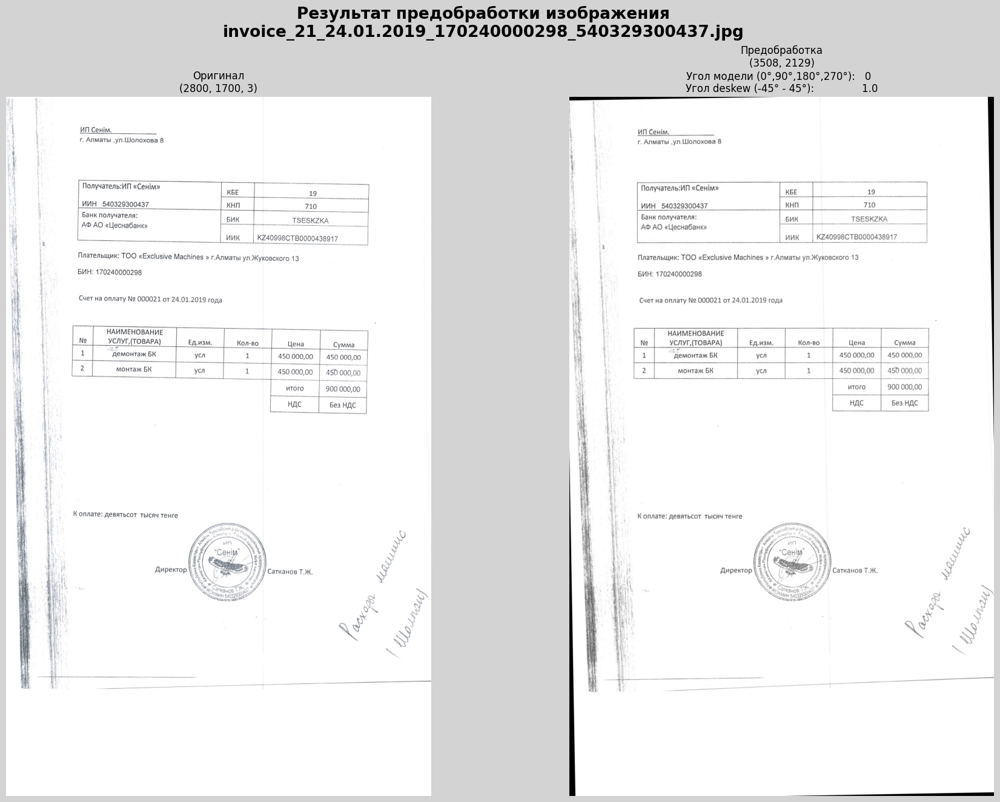

================================== Найденные боксы моделью yolo_b и результат их обработки ==================================


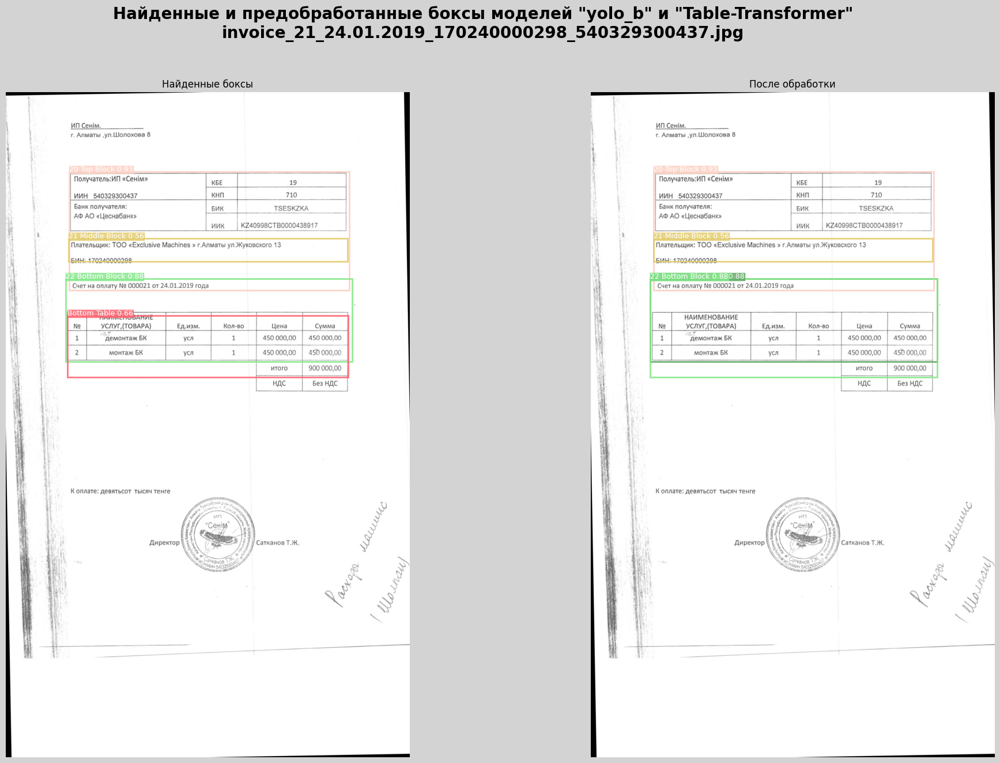

                                    Отчёт о работе модели yolo_b                                    
Найденные классы на изображении: 3/3
Найденные моделью классы: Counter({'20 Top Block': 1, '22 Bottom Block': 1, '21 Middle Block': 1})
Лучшие по confidence классы:
20 Top Block............................ 0.92563
22 Bottom Block......................... 0.88488
21 Middle Block......................... 0.55922
Пропущенных классов нет.
Расширенных боксов нет.

================================= Найденные боксы моделью yolo_b20 и результат их обработки =================================


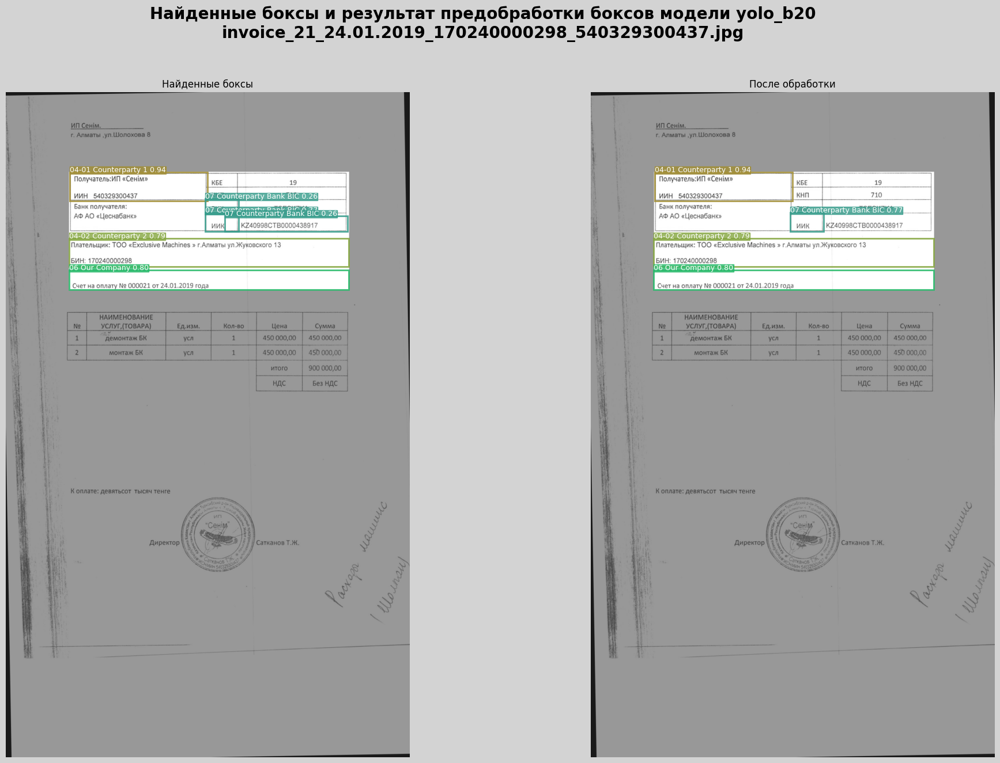

                                   Отчёт о работе модели yolo_b20                                   
Найденные классы на изображении: 4/7
Найденные моделью классы: Counter({'07 Counterparty Bank BIC': 3, '04-01 Counterparty 1': 1, '06 Our Company': 1, '04-02 Counterparty 2': 1})
Лучшие по confidence классы:
04-01 Counterparty 1.................... 0.93926
06 Our Company.......................... 0.80482
04-02 Counterparty 2.................... 0.78809
07 Counterparty Bank BIC................ 0.77252
Пропущенные классы: ['01 Receipt', '08 Counterparty Current Account IIC', '09 Counterparty Payment Purpose Code']
Расширенные на всю ширину изображения классы: ['06 Our Company', '04-02 Counterparty 2']

================================= Найденные боксы моделью yolo_b22 и результат их обработки =================================


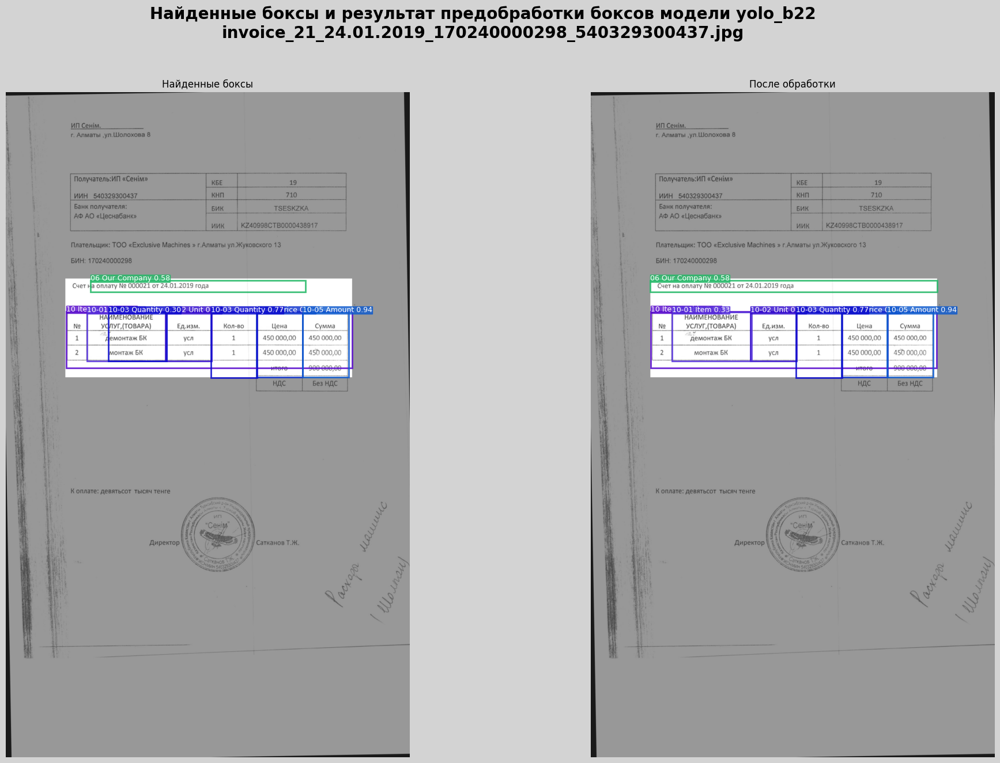

                                   Отчёт о работе модели yolo_b22                                   
Найденные классы на изображении: 7/8
Найденные моделью классы: Counter({'10-03 Quantity': 2, '10-04 Price': 1, '10 Items Table': 1, '10-05 Amount': 1, '10-02 Unit': 1, '06 Our Company': 1, '10-01 Item': 1})
Лучшие по confidence классы:
10-04 Price............................. 0.95303
10 Items Table.......................... 0.94808
10-05 Amount............................ 0.94373
10-02 Unit.............................. 0.92208
10-03 Quantity.......................... 0.77414
06 Our Company.......................... 0.58212
10-01 Item.............................. 0.33264
Пропущенные классы: ['05 Contract']
Расширенные на всю ширину изображения классы: ['06 Our Company']

======================================================================== Отчёт о дублированных боксах =========================================================================
                                          

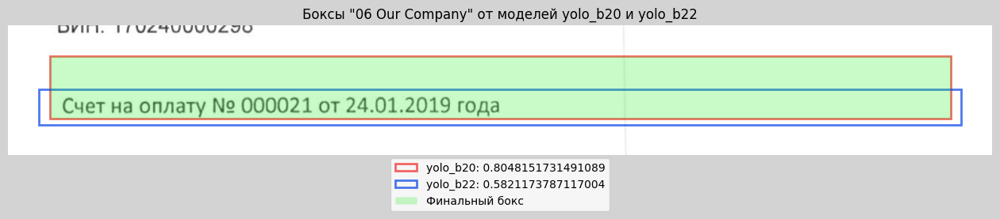


                                                               Боксы "21 Middle Block" и "04-02 Counterparty 2"                                                                


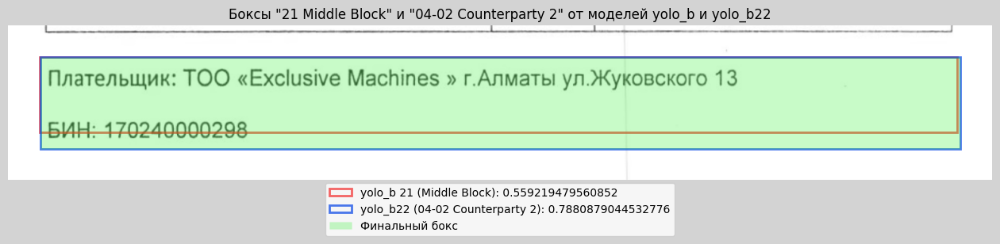

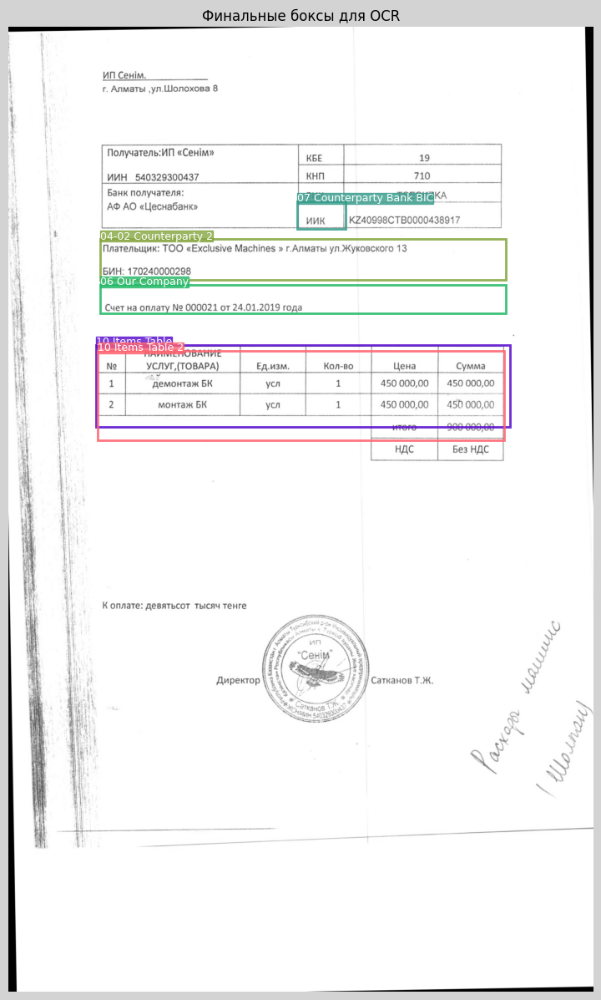

‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒ Распазнание ячеек таблицы ‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒
=========================================== Распознание таблицы (10 Items Table) ============================================
------------------------------------------- Распазнание ячеек таблицы через YOLO --------------------------------------------


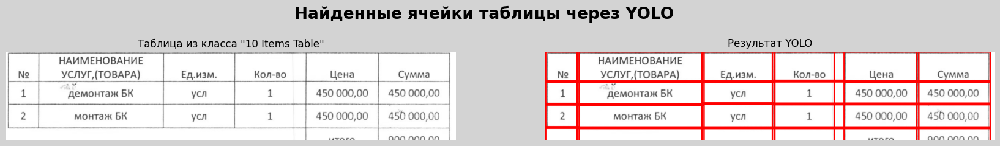

,№,"НАИМЕНОВАНИЕ УСЛУГ,(TOBAРА)",Ед.изм.,Кол-во,,Цена,Сумма
0,1,демонтаж БК,усл,1,,"450 000,00","450 000,00"
1,2,монтаж БК,усл,1,,"450 000,00","450 000,00"
2,,,,,,,



------------------------------------- Распазнание ячеек таблицы через Table-Transformer -------------------------------------


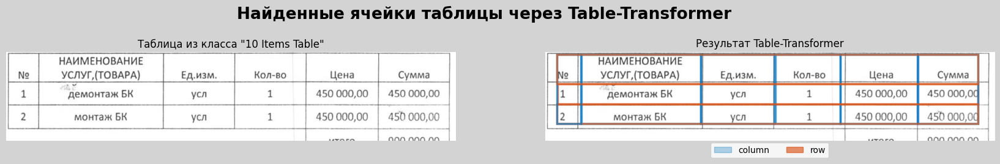

,№,"НАИМЕНОВАНИЕ УСЛУГ,(ТOBАРА)",Ед.изм.,Кол-во,Цена,Сумма
0,1,демонтаж БК,усл,1,"450 000,00","450 000,00"
1,2,монтаж БК,усл,,"450 000,00","450 000,00"



========================================== Распознание таблицы (10 Items Table 2) ===========================================
------------------------------------------- Распазнание ячеек таблицы через YOLO --------------------------------------------
*Нет найденных ячеек в таблице*

------------------------------------- Распазнание ячеек таблицы через Table-Transformer -------------------------------------
*Нет найденных ячеек в таблице*

‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒ Финальный датафрейм таблицы ‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒


,№,"НАИМЕНОВАНИЕ УСЛУГ,(TOBAРА)",Ед.изм.,Кол-во,,Цена,Сумма
0,1,демонтаж БК,усл,1,,"450 000,00","450 000,00"
1,2,монтаж БК,усл,1,,"450 000,00","450 000,00"



========================================== Распознание классов модели yolo_b (OCR) ==========================================
*Нет боксов для распознания OCR*

========================================= Распознание классов модели yolo_b20 (OCR) =========================================
                                           06 Our Company                                           


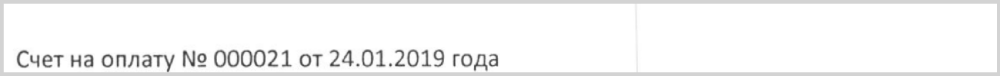

Счет на оплату № 000021 от 24.01.2019 года

                                        04-02 Counterparty 2                                        


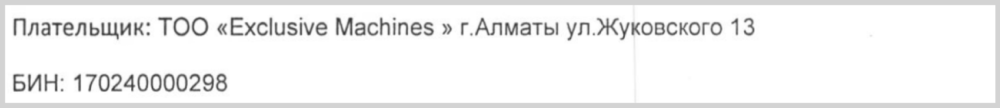

Плательщик: ТOО «Exclusive Machines » г.Алматы ул.Жуковского 13 БИН: 170240000298

                                      07 Counterparty Bank BIC                                      


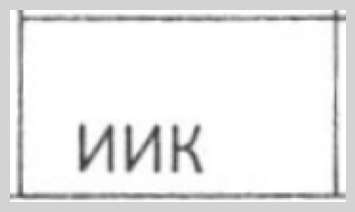

ИИК

========================================= Распознание классов модели yolo_b22 (OCR) =========================================
                                           06 Our Company                                           


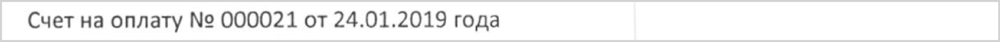

Счет на оплату № 000021 от 24.01.2019 года

════════════════════════════════════════════════ Отчёт о постобработке текста из боксов для json файла════════════════════════════════════════════════
─────────────────────────────────────────────────────────────── Словарь без обработки ────────────────────────────────────────────────────────────────
01 Receipt Number : 
02 Receipt Date   : 
04 Counterparty   :
	04-01 Name        : Плательщик: ТOО «Exclusive Machines » г.Алматы ул.Жуковского 13 БИН: 170240000298
	04-02 BIN         : Плательщик: ТOО «Exclusive Machines » г.Алматы ул.Жуковского 13 БИН: 170240000298

05 Contract       : 
06 Our Company BIN: Счет на оплату № 000021 от 24.01.2019 года
07 Counterparty Bank:
	07-01 Bank BIC    : ИИК
	07-02 Current Account IIC: 
09 Counterparty Payment Purpose Code: 
10 Items Table    :
	10-01 Item        : демонтаж БК
	10-02 Unit        : усл
	10-03 Quantity    : 1
	10-04 Price       : 450 000,00
	10-05 Amount      : 450 000,00

	10-01 Item        :

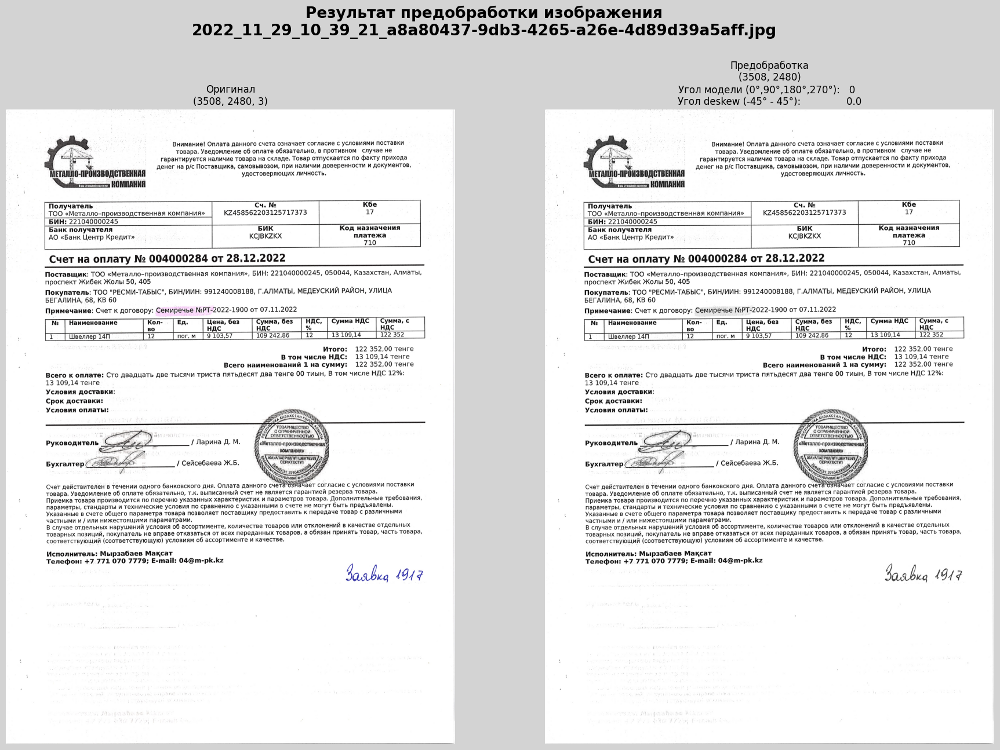

================================== Найденные боксы моделью yolo_b и результат их обработки ==================================


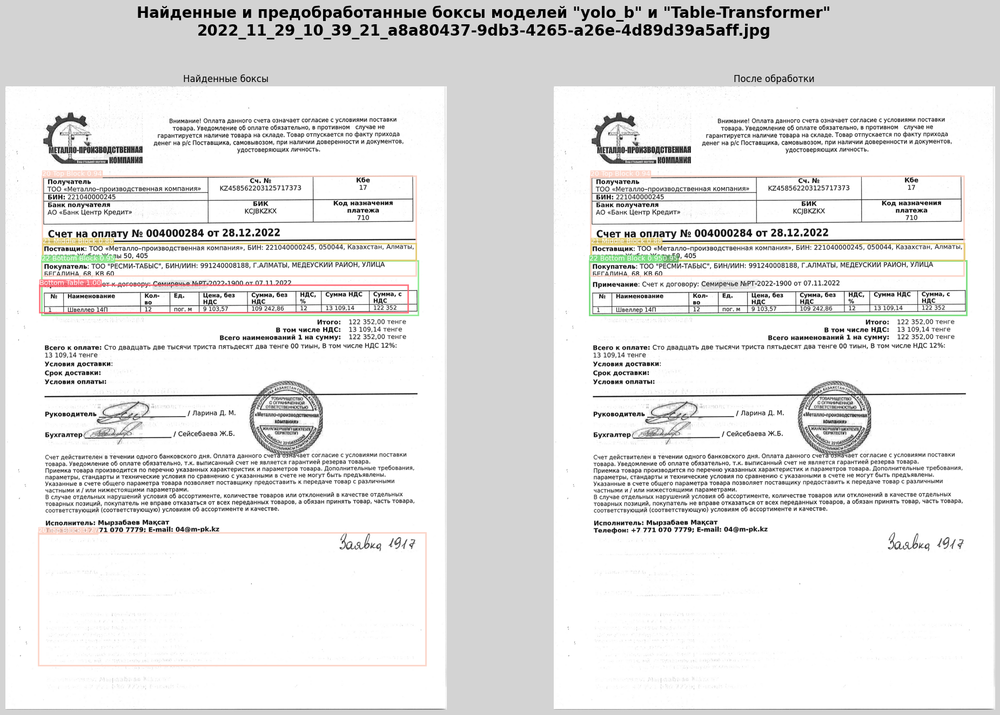

                                    Отчёт о работе модели yolo_b                                    
Найденные классы на изображении: 3/3
Найденные моделью классы: Counter({'20 Top Block': 2, '22 Bottom Block': 1, '21 Middle Block': 1})
Лучшие по confidence классы:
22 Bottom Block......................... 0.94686
20 Top Block............................ 0.94408
21 Middle Block......................... 0.87877
Пропущенных классов нет.
Расширенных боксов нет.

================================= Найденные боксы моделью yolo_b20 и результат их обработки =================================


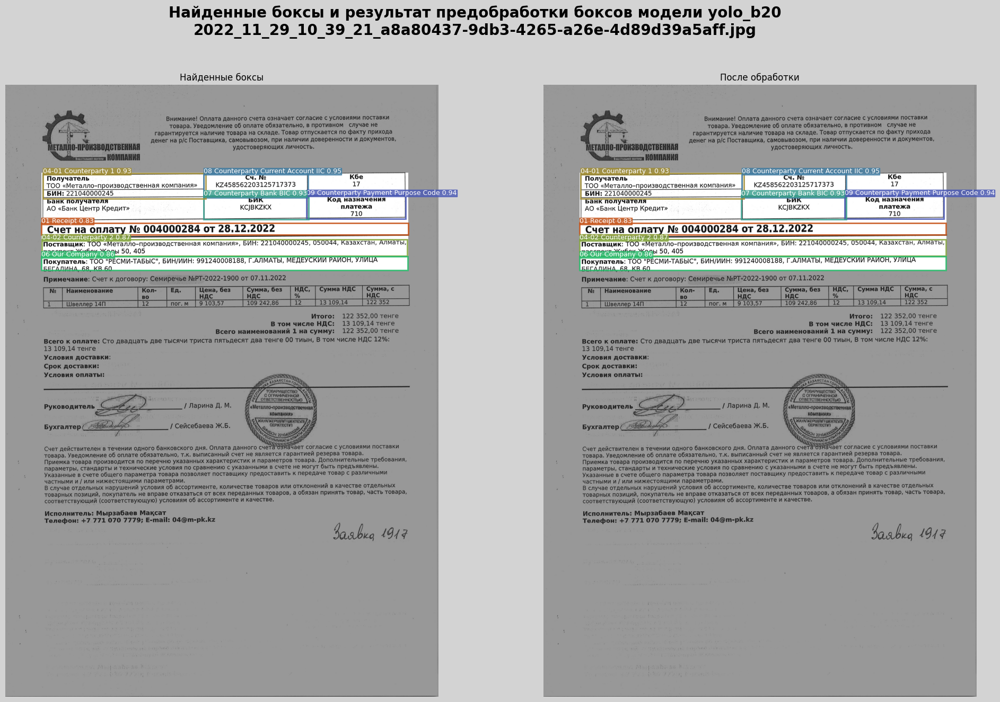

                                   Отчёт о работе модели yolo_b20                                   
Найденные классы на изображении: 7/7
Найденные моделью классы: Counter({'08 Counterparty Current Account IIC': 1, '09 Counterparty Payment Purpose Code': 1, '07 Counterparty Bank BIC': 1, '04-01 Counterparty 1': 1, '04-02 Counterparty 2': 1, '06 Our Company': 1, '01 Receipt': 1})
Лучшие по confidence классы:
08 Counterparty Current Account IIC..... 0.94941
09 Counterparty Payment Purpose Code.... 0.94343
07 Counterparty Bank BIC................ 0.93230
04-01 Counterparty 1.................... 0.93042
04-02 Counterparty 2.................... 0.86717
06 Our Company.......................... 0.86022
01 Receipt.............................. 0.82786
Пропущенных классов нет.
Расширенные на всю ширину изображения классы: ['01 Receipt', '06 Our Company', '04-02 Counterparty 2']

================================= Найденные боксы моделью yolo_b22 и результат их обработки =========================

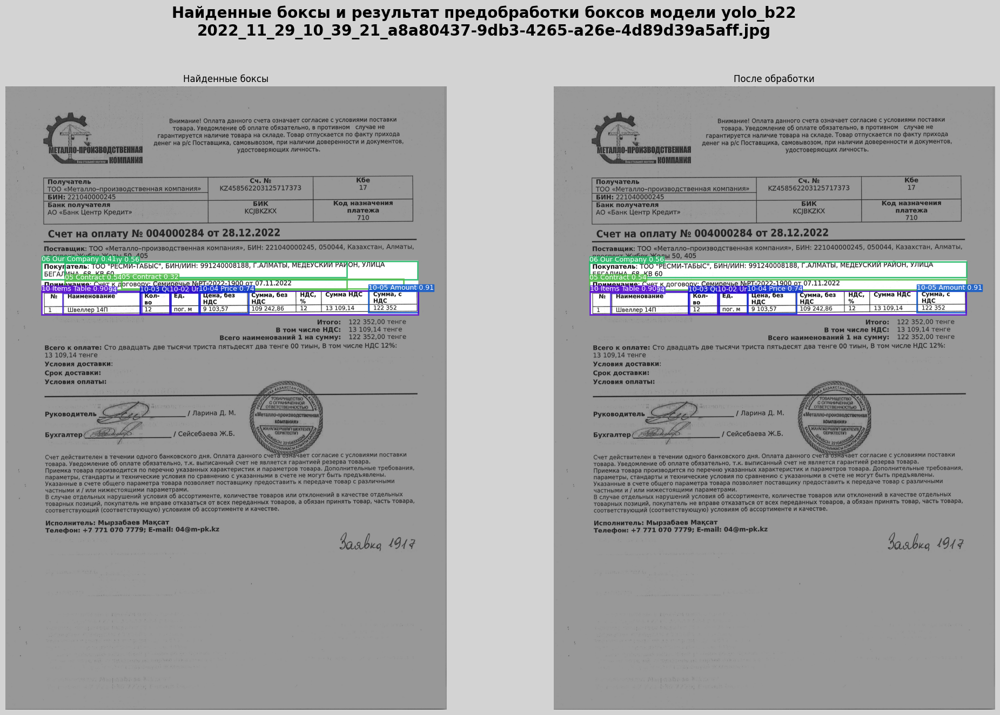

                                   Отчёт о работе модели yolo_b22                                   
Найденные классы на изображении: 8/8
Найденные моделью классы: Counter({'06 Our Company': 2, '05 Contract': 2, '10-01 Item': 1, '10-05 Amount': 1, '10-03 Quantity': 1, '10 Items Table': 1, '10-02 Unit': 1, '10-04 Price': 1})
Лучшие по confidence классы:
10-01 Item.............................. 0.94381
10-05 Amount............................ 0.91044
10-03 Quantity.......................... 0.90925
10 Items Table.......................... 0.90175
10-02 Unit.............................. 0.83025
10-04 Price............................. 0.73971
06 Our Company.......................... 0.55678
05 Contract............................. 0.53606
Пропущенных классов нет.
Расширенные на всю ширину изображения классы: ['06 Our Company', '05 Contract']

======================================================================== Отчёт о дублированных боксах =============================================

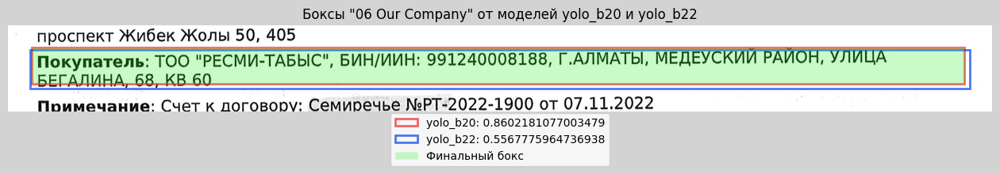


                                                               Боксы "21 Middle Block" и "04-02 Counterparty 2"                                                                


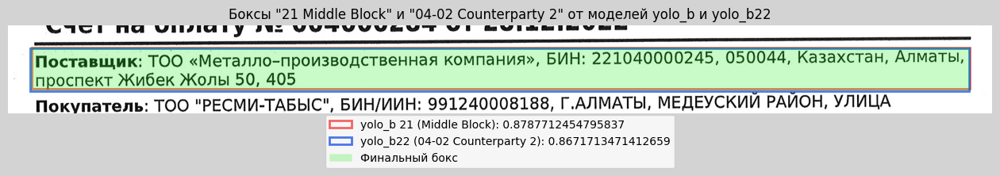

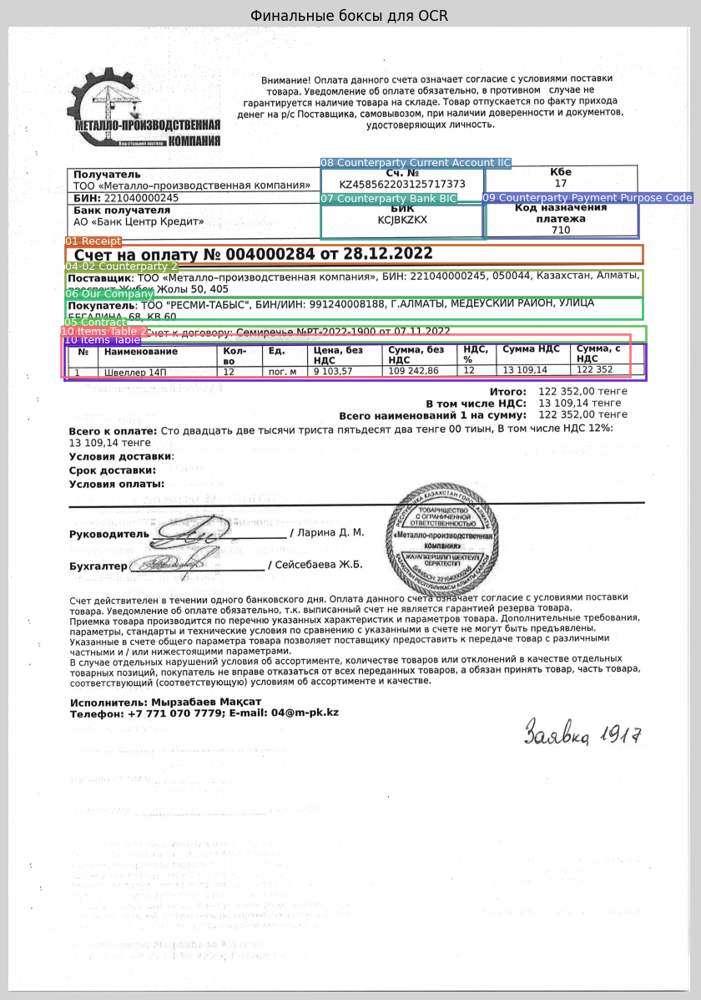

‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒ Распазнание ячеек таблицы ‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒
=========================================== Распознание таблицы (10 Items Table) ============================================
------------------------------------------- Распазнание ячеек таблицы через YOLO --------------------------------------------


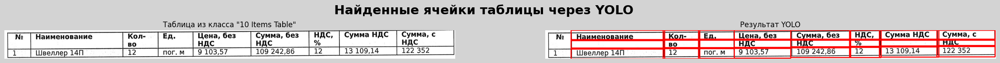

,Наименование,Кол-,Ед.,"Цена, без","Сумма, без","НДС,",Сумма НДС,"Сумма, с"
0,,во,,НДС,НДС,%,,НДС
1,Швеллер 14П,12,пог. м,"9 103,57","109 242,86",12,"13 109,14",122 352



------------------------------------- Распазнание ячеек таблицы через Table-Transformer -------------------------------------


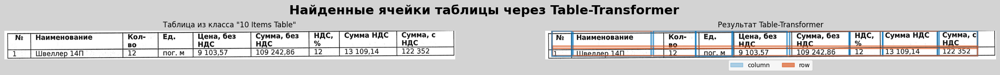

,№,Наименование,Кол- во,Ед.,"Цена, без НДС","Сумма, без НДС","НДС, %",Сумма НДС,"Сумма, НДС"
0,,lвеллер 14П,,пог.м,"г 9 103,57","109 242,86",12,"13 109,14",122 352



========================================== Распознание таблицы (10 Items Table 2) ===========================================
------------------------------------------- Распазнание ячеек таблицы через YOLO --------------------------------------------
*Нет найденных ячеек в таблице*

------------------------------------- Распазнание ячеек таблицы через Table-Transformer -------------------------------------
*Нет найденных ячеек в таблице*

‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒ Финальный датафрейм таблицы ‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒


,Наименование,Кол-,Ед.,"Цена, без","Сумма, без","НДС,",Сумма НДС,"Сумма, с"
0,,во,,НДС,НДС,%,,НДС
1,Швеллер 14П,12,пог. м,"9 103,57","109 242,86",12,"13 109,14",122 352



========================================== Распознание классов модели yolo_b (OCR) ==========================================
*Нет боксов для распознания OCR*

========================================= Распознание классов модели yolo_b20 (OCR) =========================================
                                08 Counterparty Current Account IIC                                 


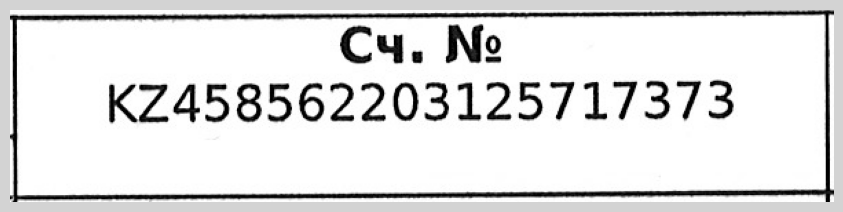

Сч. № KZ458562203125717373

                                09 Counterparty Payment Purpose Code                                


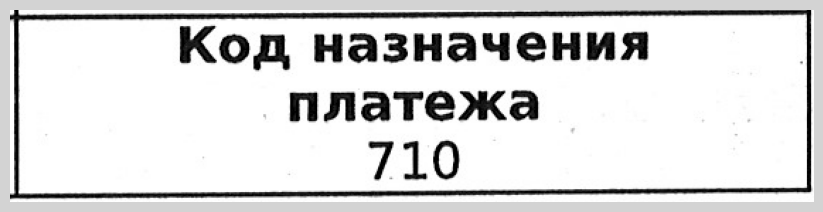

Код назначения платежа 710

                                      07 Counterparty Bank BIC                                      


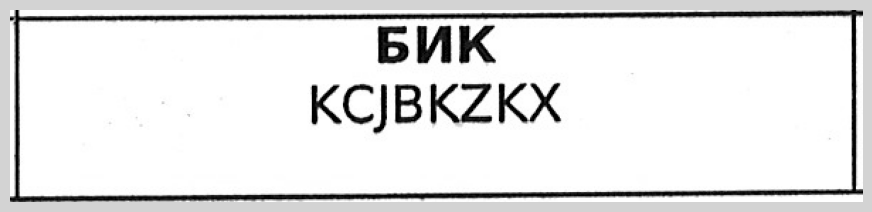

БИК KCJBKZKX

                                        04-02 Counterparty 2                                        


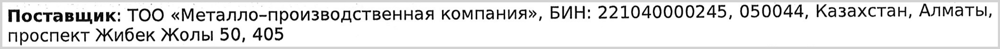

Поставщик: ТОО «Металло-производственная компания», БИН: 221040000245, 050044, Казахстан, Алматы, проспект Жибек Жолы 50, 405

                                           06 Our Company                                           


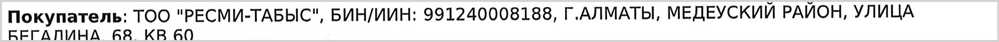

Покупатель: ТОО "РЕСМИ-ТАБЫС", БИН/ИИН: 991240008188, Г.АЛМАТЫ, МЕДЕУСКИЙ РАЙОН, УЛИЦА БЕГА ЛИНА 68 KB 60

                                             01 Receipt                                             


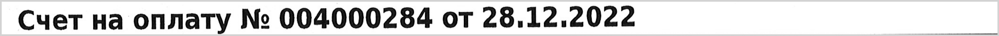

Счет на оплату № 004000284 от 28.12.2022

========================================= Распознание классов модели yolo_b22 (OCR) =========================================
                                           06 Our Company                                           


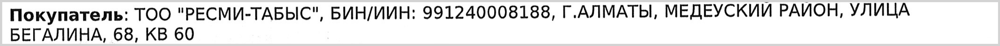

Покупатель: ТОО "РЕСМИ-ТАБЫС", БИН/ИИН: 991240008188, Г.АЛМАТЫ, МЕДЕУСКИЙ РАЙОН, УЛИЦА БЕГА ЛИНА 68 KB 60

                                            05 Contract                                             


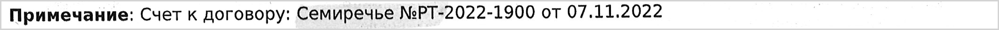

Примечание: Счет к договору: Семиречье №PT-2022-1900 от 07.11.2022

════════════════════════════════════════════════ Отчёт о постобработке текста из боксов для json файла════════════════════════════════════════════════
─────────────────────────────────────────────────────────────── Словарь без обработки ────────────────────────────────────────────────────────────────
01 Receipt Number : Счет на оплату № 004000284 от 28.12.2022
02 Receipt Date   : Счет на оплату № 004000284 от 28.12.2022
04 Counterparty   :
	04-01 Name        : Поставщик: ТОО «Металло-производственная компания», БИН: 221040000245, 050044, Казахстан, Алматы, проспект Жибек Жолы 50, 405
	04-02 BIN         : Поставщик: ТОО «Металло-производственная компания», БИН: 221040000245, 050044, Казахстан, Алматы, проспект Жибек Жолы 50, 405

05 Contract       : Примечание: Счет к договору: Семиречье №PT-2022-1900 от 07.11.2022
06 Our Company BIN: Покупатель: ТОО "РЕСМИ-ТАБЫС", БИН/ИИН: 991240008188, Г.АЛМАТЫ, МЕДЕУСКИЙ РАЙОН, УЛИЦА

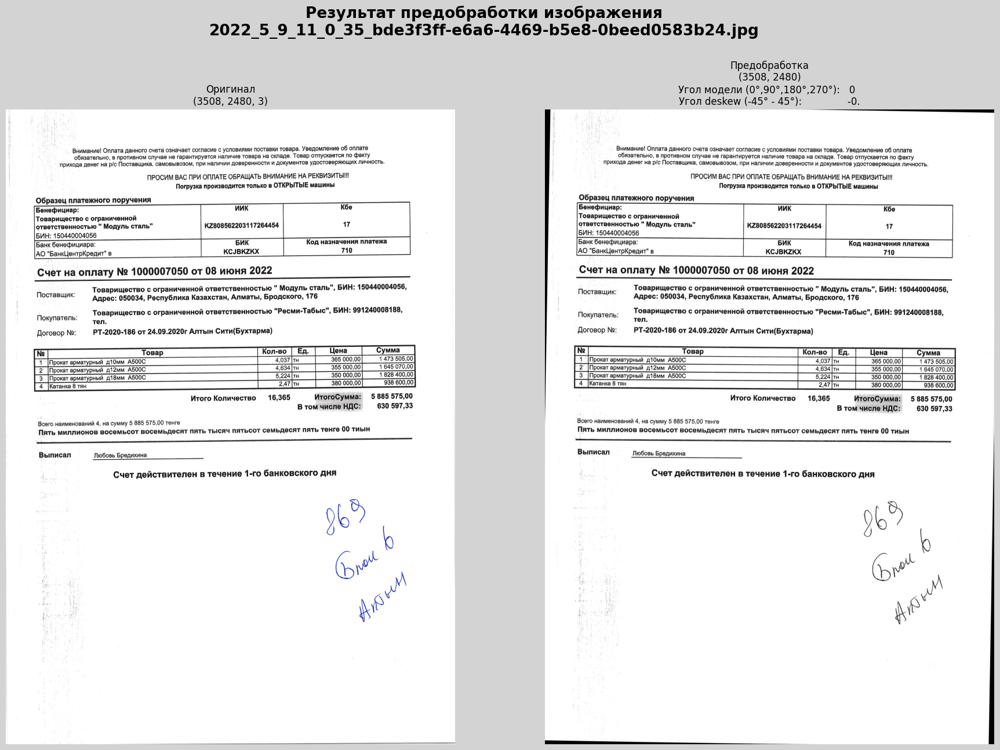

================================== Найденные боксы моделью yolo_b и результат их обработки ==================================


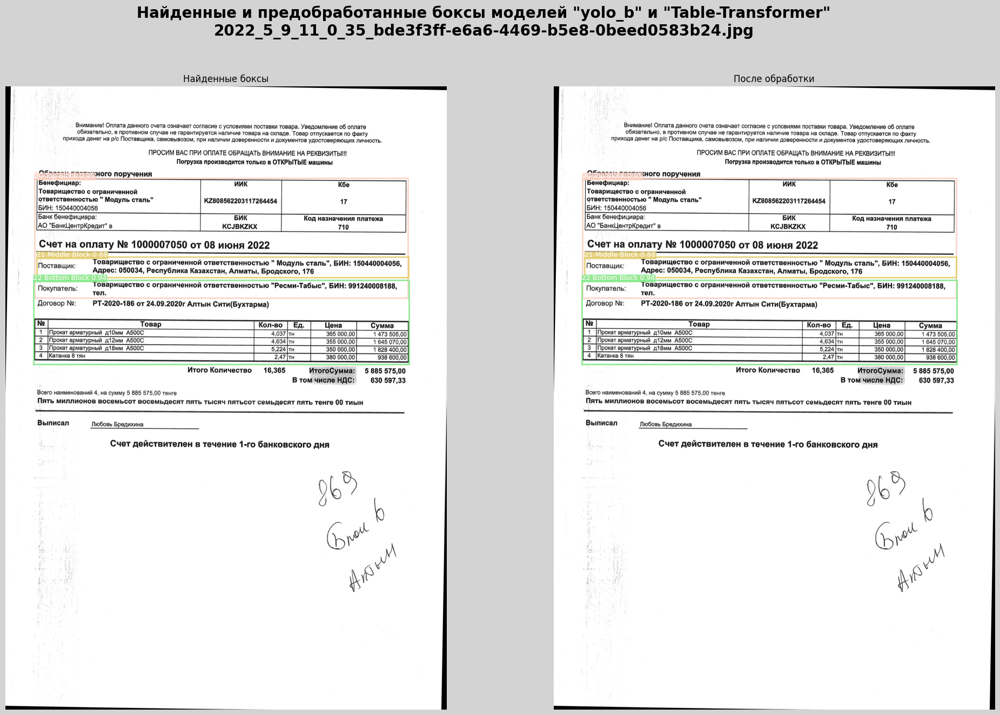

                                    Отчёт о работе модели yolo_b                                    
Найденные классы на изображении: 3/3
Найденные моделью классы: Counter({'20 Top Block': 1, '22 Bottom Block': 1, '21 Middle Block': 1})
Лучшие по confidence классы:
20 Top Block............................ 0.94532
22 Bottom Block......................... 0.94365
21 Middle Block......................... 0.87805
Пропущенных классов нет.
Расширенных боксов нет.

================================= Найденные боксы моделью yolo_b20 и результат их обработки =================================


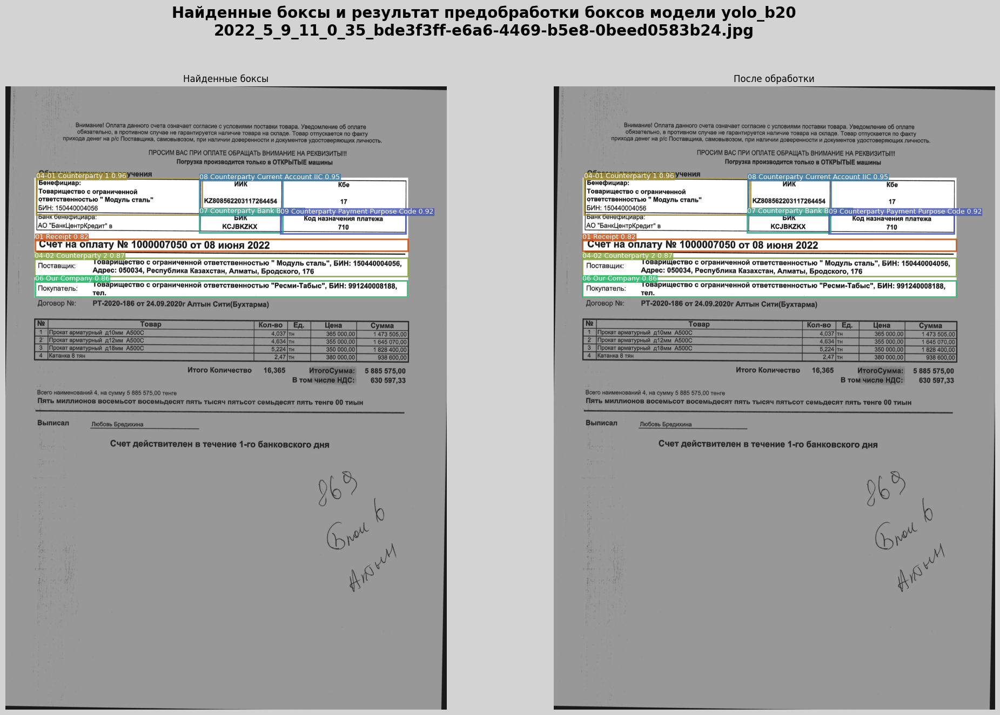

                                   Отчёт о работе модели yolo_b20                                   
Найденные классы на изображении: 7/7
Найденные моделью классы: Counter({'04-01 Counterparty 1': 1, '08 Counterparty Current Account IIC': 1, '07 Counterparty Bank BIC': 1, '09 Counterparty Payment Purpose Code': 1, '04-02 Counterparty 2': 1, '06 Our Company': 1, '01 Receipt': 1})
Лучшие по confidence классы:
04-01 Counterparty 1.................... 0.95793
08 Counterparty Current Account IIC..... 0.95396
07 Counterparty Bank BIC................ 0.93685
09 Counterparty Payment Purpose Code.... 0.91815
04-02 Counterparty 2.................... 0.87406
06 Our Company.......................... 0.85910
01 Receipt.............................. 0.82280
Пропущенных классов нет.
Расширенные на всю ширину изображения классы: ['01 Receipt', '06 Our Company', '04-02 Counterparty 2']

================================= Найденные боксы моделью yolo_b22 и результат их обработки =========================

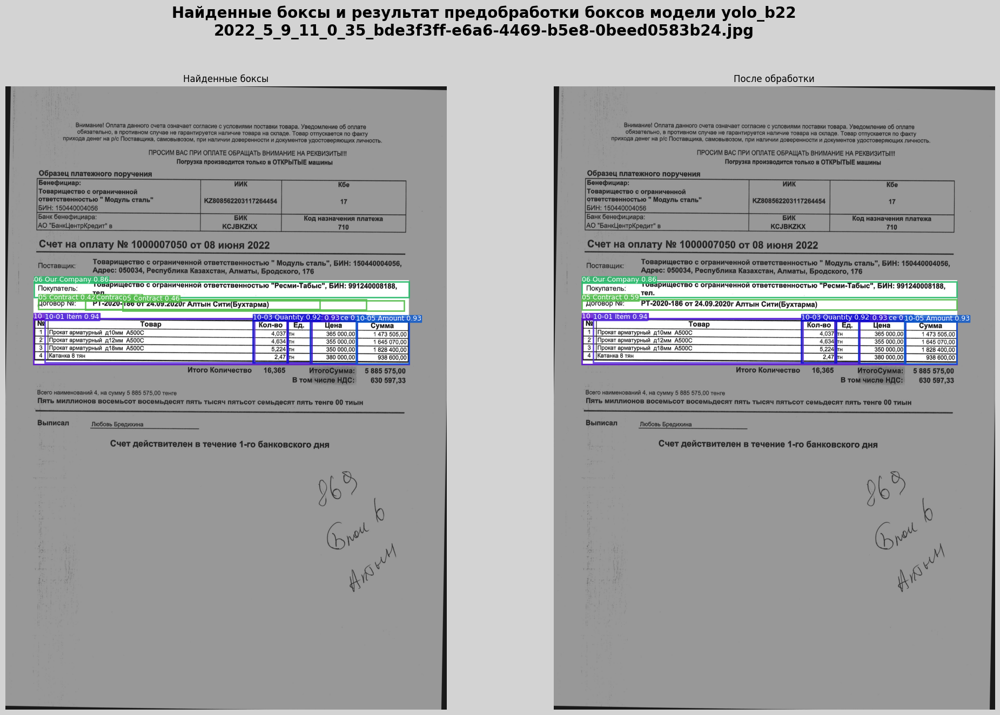

                                   Отчёт о работе модели yolo_b22                                   
Найденные классы на изображении: 8/8
Найденные моделью классы: Counter({'05 Contract': 3, '10 Items Table': 1, '10-04 Price': 1, '10-01 Item': 1, '10-05 Amount': 1, '10-02 Unit': 1, '10-03 Quantity': 1, '06 Our Company': 1})
Лучшие по confidence классы:
10 Items Table.......................... 0.95157
10-04 Price............................. 0.94908
10-01 Item.............................. 0.93900
10-05 Amount............................ 0.93182
10-02 Unit.............................. 0.92679
10-03 Quantity.......................... 0.92350
06 Our Company.......................... 0.85522
05 Contract............................. 0.59403
Пропущенных классов нет.
Расширенные на всю ширину изображения классы: ['06 Our Company', '05 Contract']

======================================================================== Отчёт о дублированных боксах =============================================

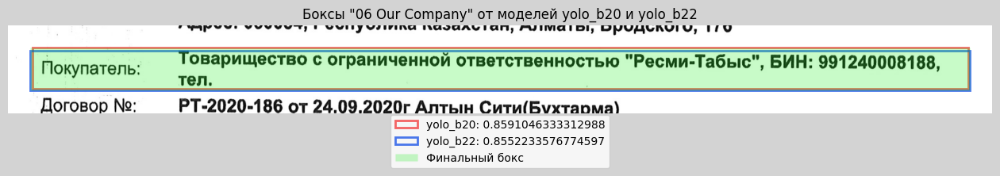


                                                               Боксы "21 Middle Block" и "04-02 Counterparty 2"                                                                


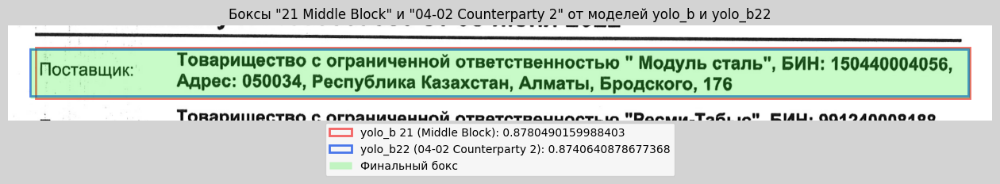

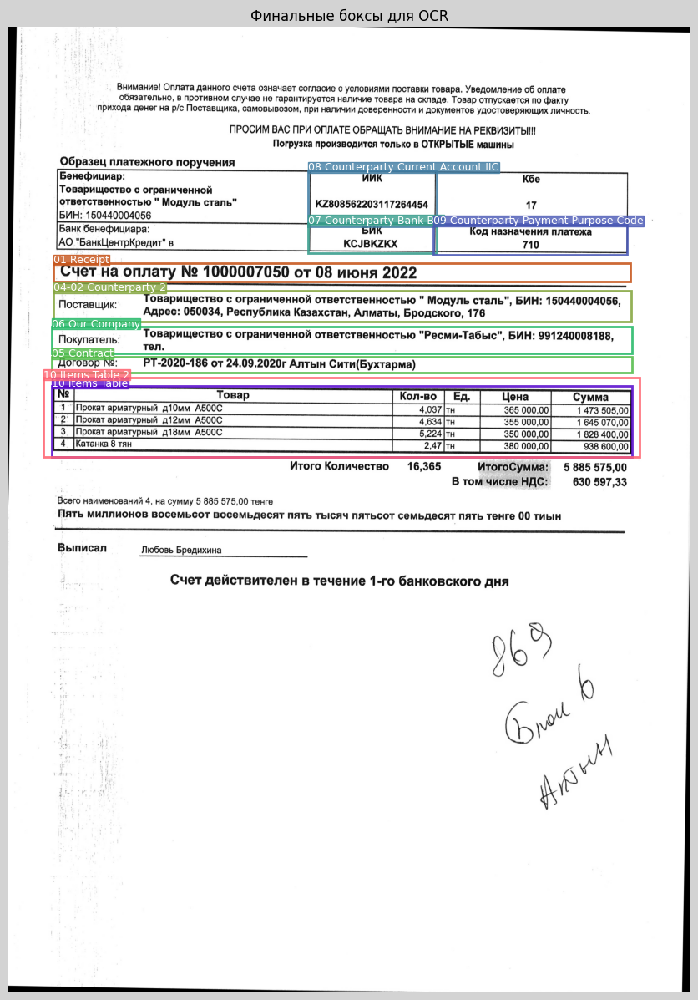

‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒ Распазнание ячеек таблицы ‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒
=========================================== Распознание таблицы (10 Items Table) ============================================
------------------------------------------- Распазнание ячеек таблицы через YOLO --------------------------------------------


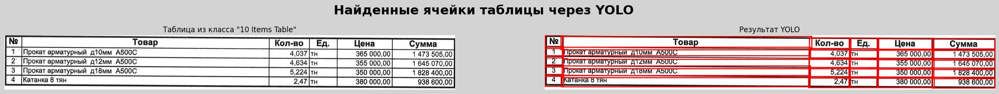

,№,Товар,Кол-во,Ед.,Цена,Сумма
0,,Прокат арматурный д10мм А500C,"4,037",тн,"365 000,00","1 473 505,00"
1,2,Прокат арматурный д12мм А500C,"4,634",тн,"355 000,00","645 070,00"
2,3,Прокат арматурный д18мм А500C,"5,224",тн,"350 000,00","828 400,00"
3,4,Катанка 8 тян,"2,47",тн,"380 000,00","938 600,00"



------------------------------------- Распазнание ячеек таблицы через Table-Transformer -------------------------------------


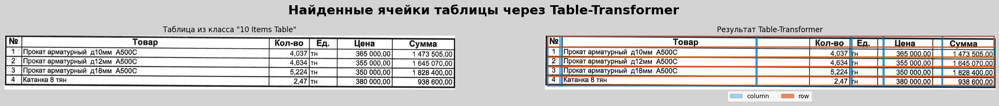

,№,Товар,Кол-во,,Цена,Сумма
0,,Прокат арматурный д10мм А500C,"4,037",тн,"365 000,00","473 505,00"
1,2,Прокат арматурный д12мм А500C,"4,634",тн,"355 000,00","645 070,00"
2,3,Прокат арматурный д18мм А500C,"5,224",тн,"350 000,00","828 400,00"
3,4,Катанка 8 тян,"2,47",тн,"380 000,00","938 600,00"



========================================== Распознание таблицы (10 Items Table 2) ===========================================
------------------------------------------- Распазнание ячеек таблицы через YOLO --------------------------------------------
*Нет найденных ячеек в таблице*

------------------------------------- Распазнание ячеек таблицы через Table-Transformer -------------------------------------
*Нет найденных ячеек в таблице*

‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒ Финальный датафрейм таблицы ‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒


,№,Товар,Кол-во,Ед.,Цена,Сумма
0,,Прокат арматурный д10мм А500C,"4,037",тн,"365 000,00","1 473 505,00"
1,2,Прокат арматурный д12мм А500C,"4,634",тн,"355 000,00","645 070,00"
2,3,Прокат арматурный д18мм А500C,"5,224",тн,"350 000,00","828 400,00"
3,4,Катанка 8 тян,"2,47",тн,"380 000,00","938 600,00"



========================================== Распознание классов модели yolo_b (OCR) ==========================================
*Нет боксов для распознания OCR*

========================================= Распознание классов модели yolo_b20 (OCR) =========================================
                                08 Counterparty Current Account IIC                                 


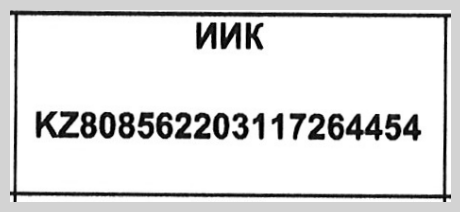

ИИК KZ808562203117264454

                                      07 Counterparty Bank BIC                                      


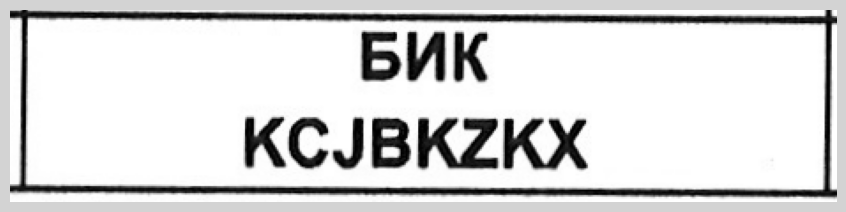

БИК KCJBKZKX

                                09 Counterparty Payment Purpose Code                                


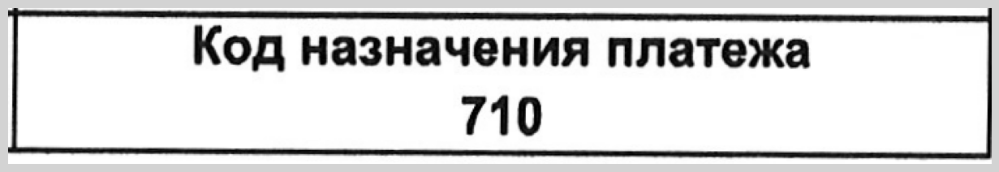

назначения платежа 710 Kод

                                        04-02 Counterparty 2                                        


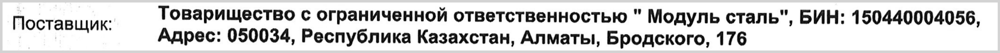

Поставщик: Товарищество с ограниченной ответственностью Модуль сталь БИН: 150440004056, Адрес: 050034, Республика Казахстан, Алматы, Бродского, 176

                                           06 Our Company                                           


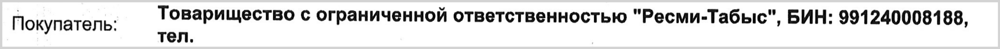

Покупатель: Товарищество с ограниченной ответственностью "Ресми-Табыс", БИН: 991240008188, тел.

                                             01 Receipt                                             


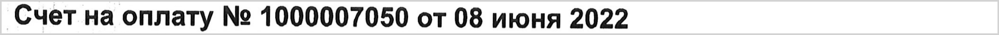

Счет на оплату № 1000007050 от 08 июня 2022

========================================= Распознание классов модели yolo_b22 (OCR) =========================================
                                           06 Our Company                                           


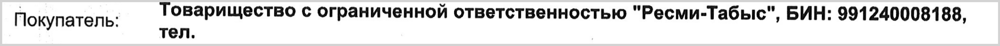

Покупатель: Товарищество с ограниченной ответственностью "Ресми-Табыс", БИН: 991240008188, тел.

                                            05 Contract                                             


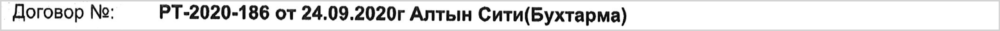

Договор №: РT-2020-186 от 24.09.2020г Алтын Сити(Бухтарма)

════════════════════════════════════════════════ Отчёт о постобработке текста из боксов для json файла════════════════════════════════════════════════
─────────────────────────────────────────────────────────────── Словарь без обработки ────────────────────────────────────────────────────────────────
01 Receipt Number : Счет на оплату № 1000007050 от 08 июня 2022
02 Receipt Date   : Счет на оплату № 1000007050 от 08 июня 2022
04 Counterparty   :
	04-01 Name        : Поставщик: Товарищество с ограниченной ответственностью Модуль сталь БИН: 150440004056, Адрес: 050034, Республика Казахстан, Алматы, Бродского, 176
	04-02 BIN         : Поставщик: Товарищество с ограниченной ответственностью Модуль сталь БИН: 150440004056, Адрес: 050034, Республика Казахстан, Алматы, Бродского, 176

05 Contract       : Договор №: РT-2020-186 от 24.09.2020г Алтын Сити(Бухтарма)
06 Our Company BIN: Покупатель: Товарищество с ограниченной ответственно

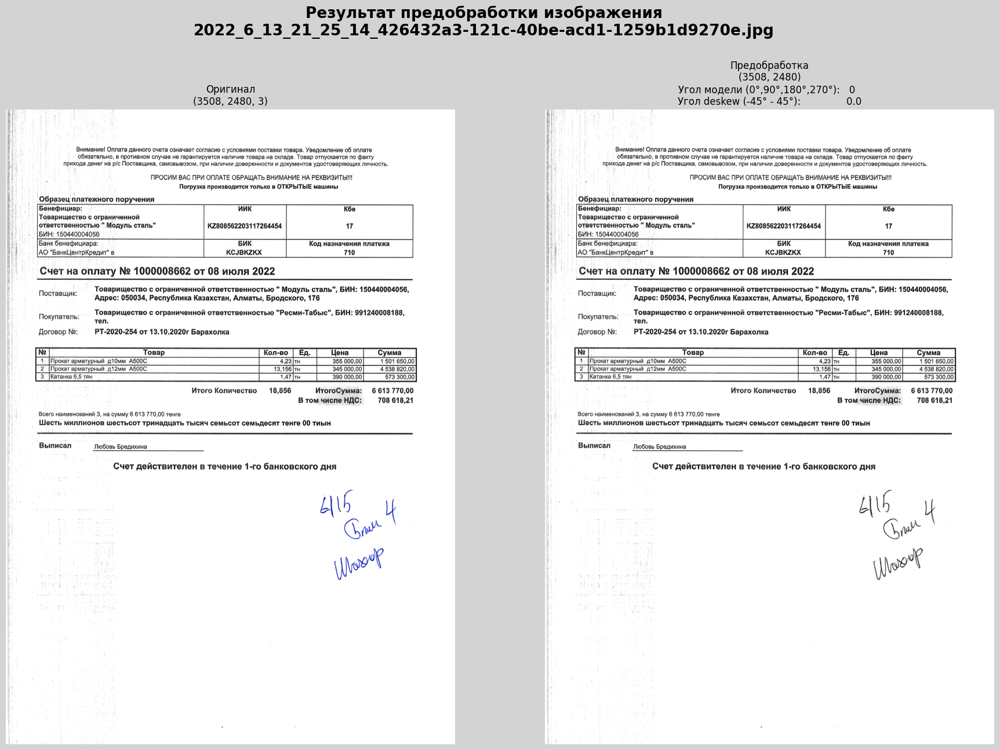

================================== Найденные боксы моделью yolo_b и результат их обработки ==================================


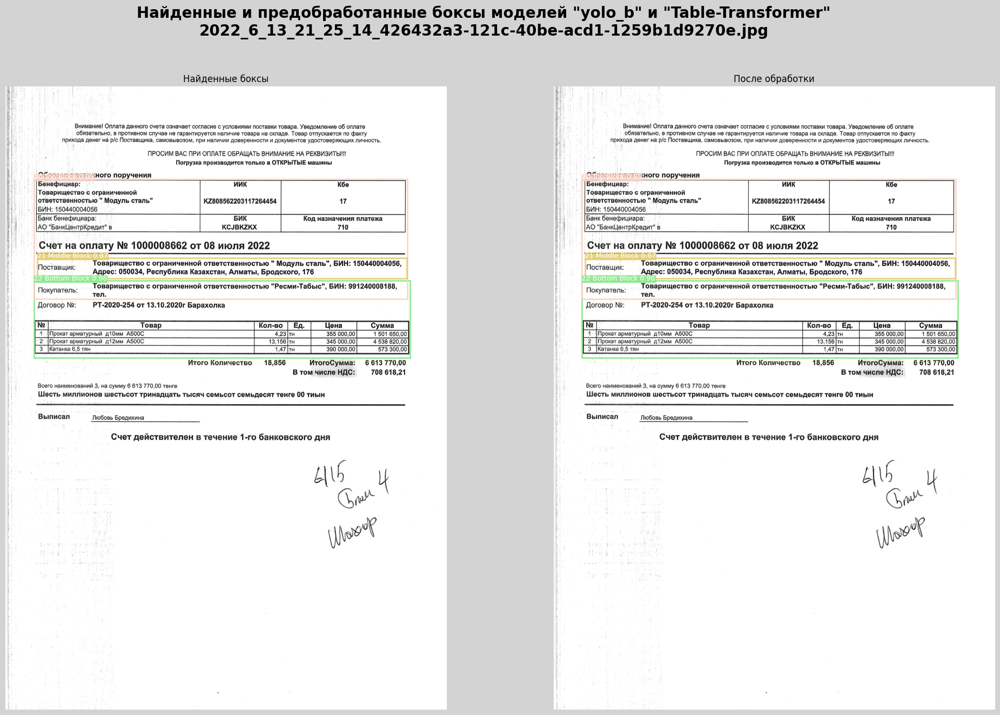

                                    Отчёт о работе модели yolo_b                                    
Найденные классы на изображении: 3/3
Найденные моделью классы: Counter({'22 Bottom Block': 1, '20 Top Block': 1, '21 Middle Block': 1})
Лучшие по confidence классы:
22 Bottom Block......................... 0.96123
20 Top Block............................ 0.94974
21 Middle Block......................... 0.86670
Пропущенных классов нет.
Расширенных боксов нет.

================================= Найденные боксы моделью yolo_b20 и результат их обработки =================================


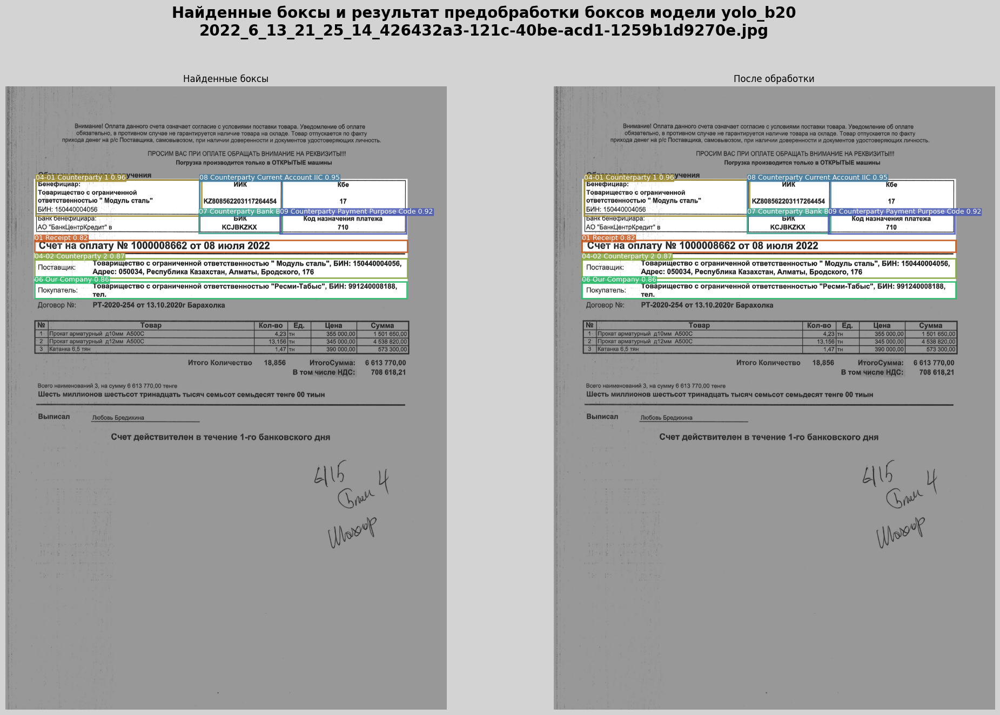

                                   Отчёт о работе модели yolo_b20                                   
Найденные классы на изображении: 7/7
Найденные моделью классы: Counter({'04-01 Counterparty 1': 1, '08 Counterparty Current Account IIC': 1, '07 Counterparty Bank BIC': 1, '09 Counterparty Payment Purpose Code': 1, '04-02 Counterparty 2': 1, '06 Our Company': 1, '01 Receipt': 1})
Лучшие по confidence классы:
04-01 Counterparty 1.................... 0.95889
08 Counterparty Current Account IIC..... 0.95170
07 Counterparty Bank BIC................ 0.92219
09 Counterparty Payment Purpose Code.... 0.92101
04-02 Counterparty 2.................... 0.87186
06 Our Company.......................... 0.86083
01 Receipt.............................. 0.81643
Пропущенных классов нет.
Расширенные на всю ширину изображения классы: ['01 Receipt', '06 Our Company', '04-02 Counterparty 2']

================================= Найденные боксы моделью yolo_b22 и результат их обработки =========================

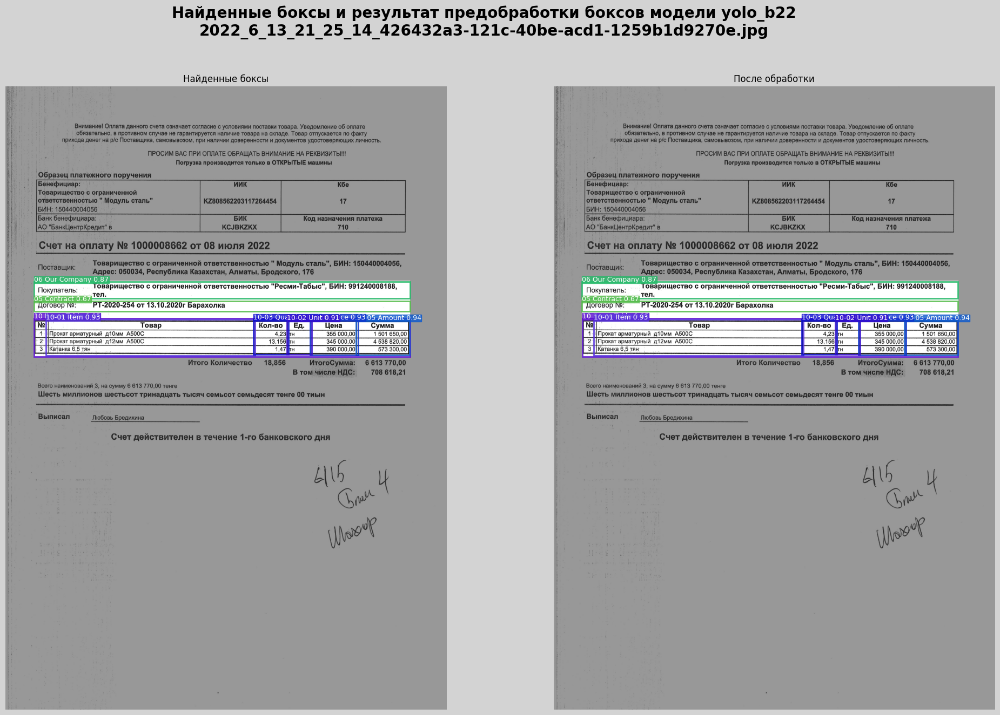

                                   Отчёт о работе модели yolo_b22                                   
Найденные классы на изображении: 8/8
Найденные моделью классы: Counter({'10 Items Table': 1, '10-05 Amount': 1, '10-01 Item': 1, '10-03 Quantity': 1, '10-04 Price': 1, '10-02 Unit': 1, '06 Our Company': 1, '05 Contract': 1})
Лучшие по confidence классы:
10 Items Table.......................... 0.94683
10-05 Amount............................ 0.93611
10-01 Item.............................. 0.93377
10-03 Quantity.......................... 0.93023
10-04 Price............................. 0.92765
10-02 Unit.............................. 0.91456
06 Our Company.......................... 0.86746
05 Contract............................. 0.66709
Пропущенных классов нет.
Расширенные на всю ширину изображения классы: ['06 Our Company', '05 Contract']

======================================================================== Отчёт о дублированных боксах =============================================

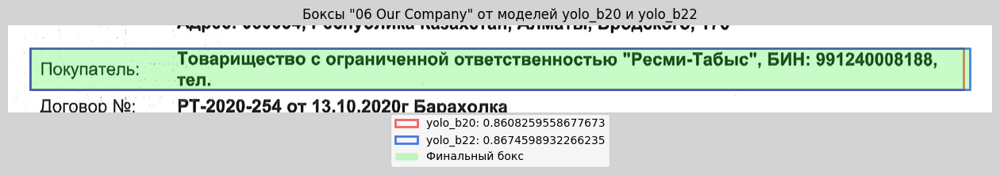


                                                               Боксы "21 Middle Block" и "04-02 Counterparty 2"                                                                


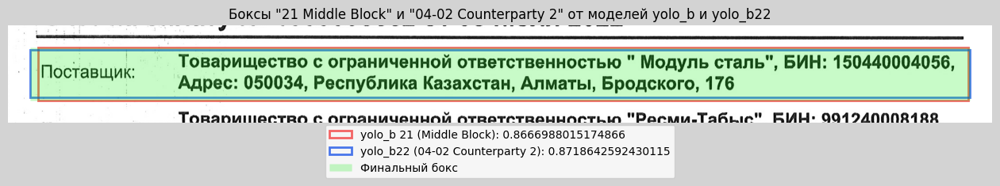

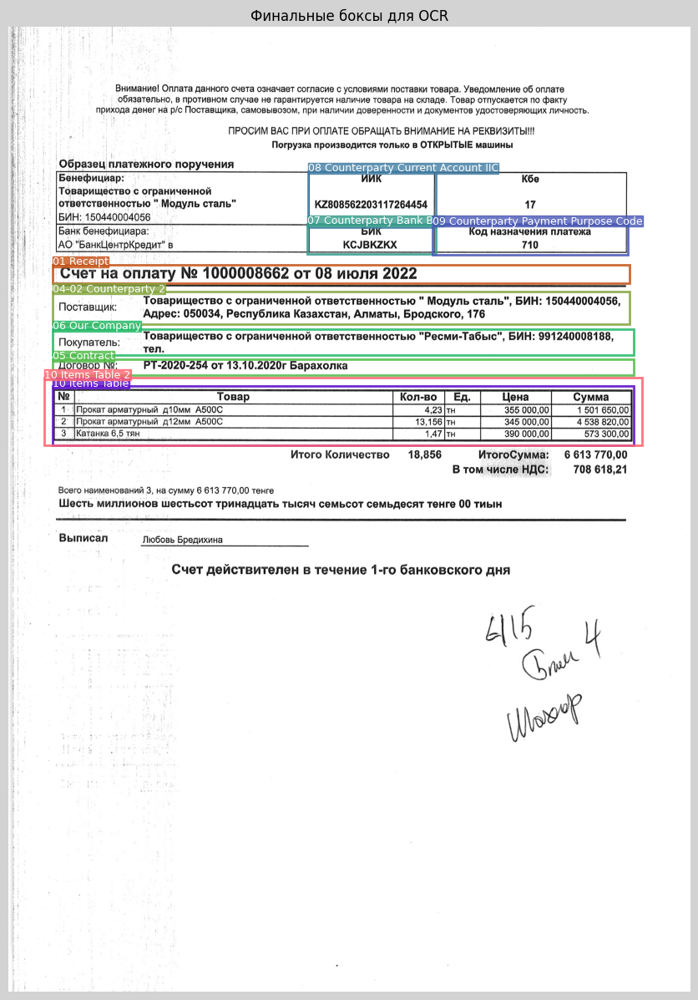

‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒ Распазнание ячеек таблицы ‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒
=========================================== Распознание таблицы (10 Items Table) ============================================
------------------------------------------- Распазнание ячеек таблицы через YOLO --------------------------------------------


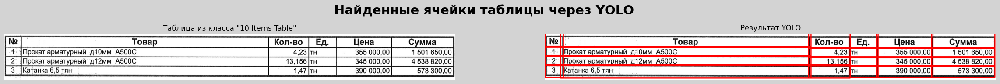

,№,Товар,Кол-во,Ед.,Цена,Сумма
0,,Прокат арматурный д10мм А500C,"4,23",тн,"355 000,00","1 501 650,00"
1,2,Прокат арматурный д12мм А500C,"13,156",тн,"345 000,00","4 538 820,00"
2,3,"Катанка 6,5 тян","1,47",тн,"390 000,00","573 300,00"



------------------------------------- Распазнание ячеек таблицы через Table-Transformer -------------------------------------


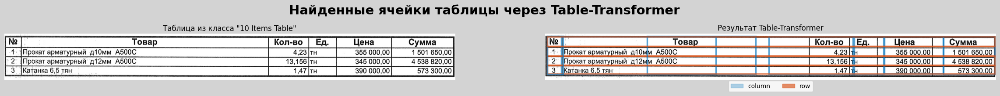

,№,Товар,Товар,Кол-во,Ед.,Цена,Сумма
0,,Прокат арматурный д10мм А500C,м А500C,"4,23 т",-Н,"355 000,00","501 650,00"
1,2,Прокат арматурный д12мм А500C,м А500C,"13,156 т",-Н,"345 000,00","4 538 820,00"
2,3,"Катанка 6,5 тян",,"1,47 т",-Н,"390 000,00","573 300,00"



========================================== Распознание таблицы (10 Items Table 2) ===========================================
------------------------------------------- Распазнание ячеек таблицы через YOLO --------------------------------------------
*Нет найденных ячеек в таблице*

------------------------------------- Распазнание ячеек таблицы через Table-Transformer -------------------------------------
*Нет найденных ячеек в таблице*

‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒ Финальный датафрейм таблицы ‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒


,№,Товар,Кол-во,Ед.,Цена,Сумма
0,,Прокат арматурный д10мм А500C,"4,23",тн,"355 000,00","1 501 650,00"
1,2,Прокат арматурный д12мм А500C,"13,156",тн,"345 000,00","4 538 820,00"
2,3,"Катанка 6,5 тян","1,47",тн,"390 000,00","573 300,00"



========================================== Распознание классов модели yolo_b (OCR) ==========================================
*Нет боксов для распознания OCR*

========================================= Распознание классов модели yolo_b20 (OCR) =========================================
                                08 Counterparty Current Account IIC                                 


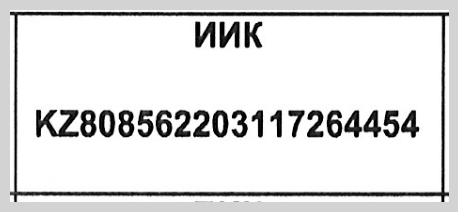

ИИК KZ808562203117264454

                                      07 Counterparty Bank BIC                                      


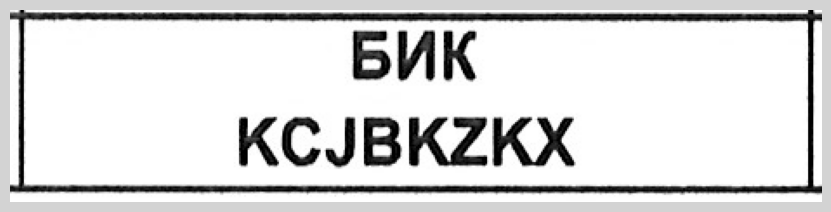

БИК KCJBKZKX

                                09 Counterparty Payment Purpose Code                                


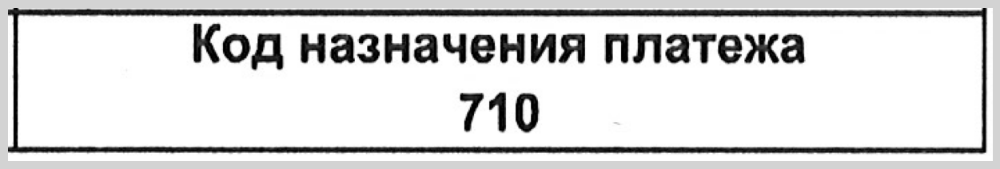

Код назначения платежа 710

                                        04-02 Counterparty 2                                        


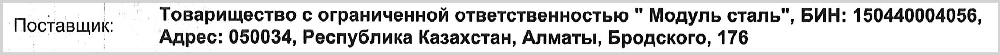

Товарищество с ограниченной ответственностью Модуль сталь БИН: 150440004056, Поставщик: Адрес: 050034, Республика Казахстан, Алматы, Бродского, 176

                                           06 Our Company                                           


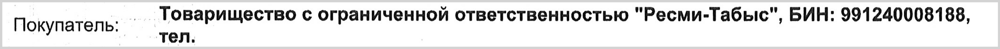

Товарищество с ограниченной ответственностью "Ресми-Табыс", БИН: 991240008188, Покупатель: тел.

                                             01 Receipt                                             


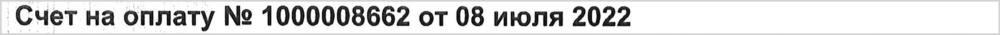

Счет на оплату № 1000008662 от 08 июля 2022

========================================= Распознание классов модели yolo_b22 (OCR) =========================================
                                           06 Our Company                                           


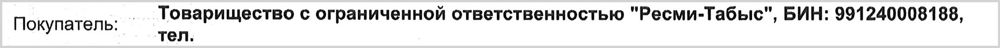

Товарищество с ограниченной ответственностью "Ресми-Табыс", БИН: 991240008188, Покупатель: тел.

                                            05 Contract                                             


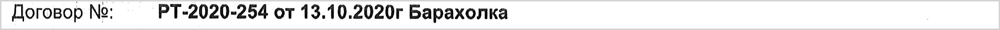

Договор №: PT-2020-254 от 13.10.2020г Барахолка

════════════════════════════════════════════════ Отчёт о постобработке текста из боксов для json файла════════════════════════════════════════════════
─────────────────────────────────────────────────────────────── Словарь без обработки ────────────────────────────────────────────────────────────────
01 Receipt Number : Счет на оплату № 1000008662 от 08 июля 2022
02 Receipt Date   : Счет на оплату № 1000008662 от 08 июля 2022
04 Counterparty   :
	04-01 Name        : Товарищество с ограниченной ответственностью Модуль сталь БИН: 150440004056, Поставщик: Адрес: 050034, Республика Казахстан, Алматы, Бродского, 176
	04-02 BIN         : Товарищество с ограниченной ответственностью Модуль сталь БИН: 150440004056, Поставщик: Адрес: 050034, Республика Казахстан, Алматы, Бродского, 176

05 Contract       : Договор №: PT-2020-254 от 13.10.2020г Барахолка
06 Our Company BIN: Товарищество с ограниченной ответственностью "Ресми-Табыс", БИН: 991240008

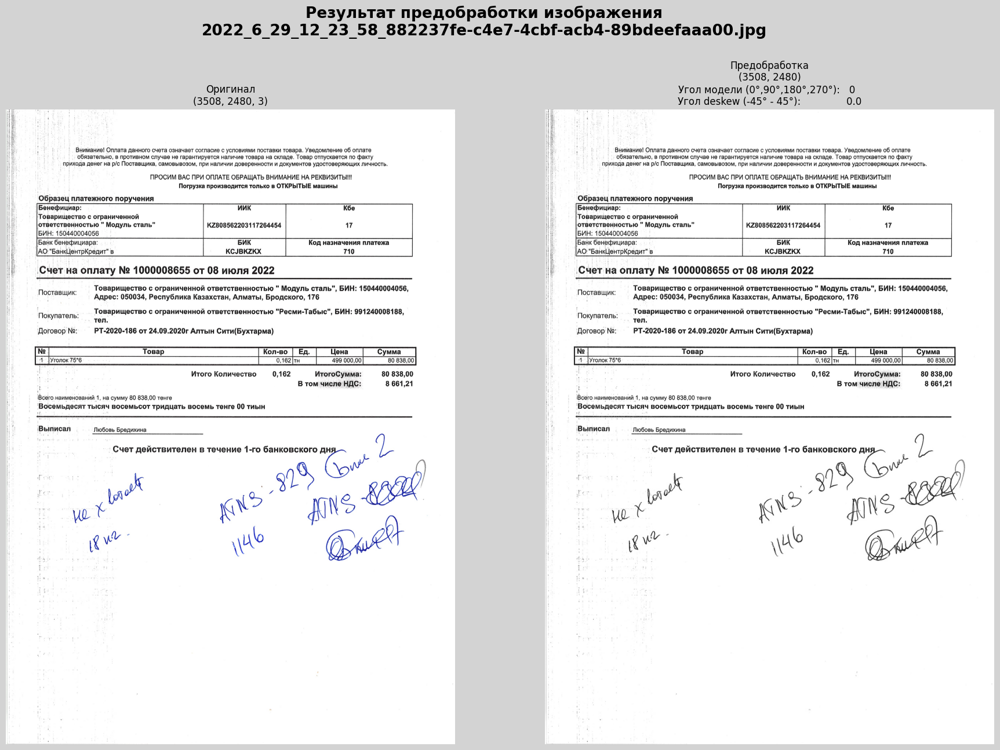

================================== Найденные боксы моделью yolo_b и результат их обработки ==================================


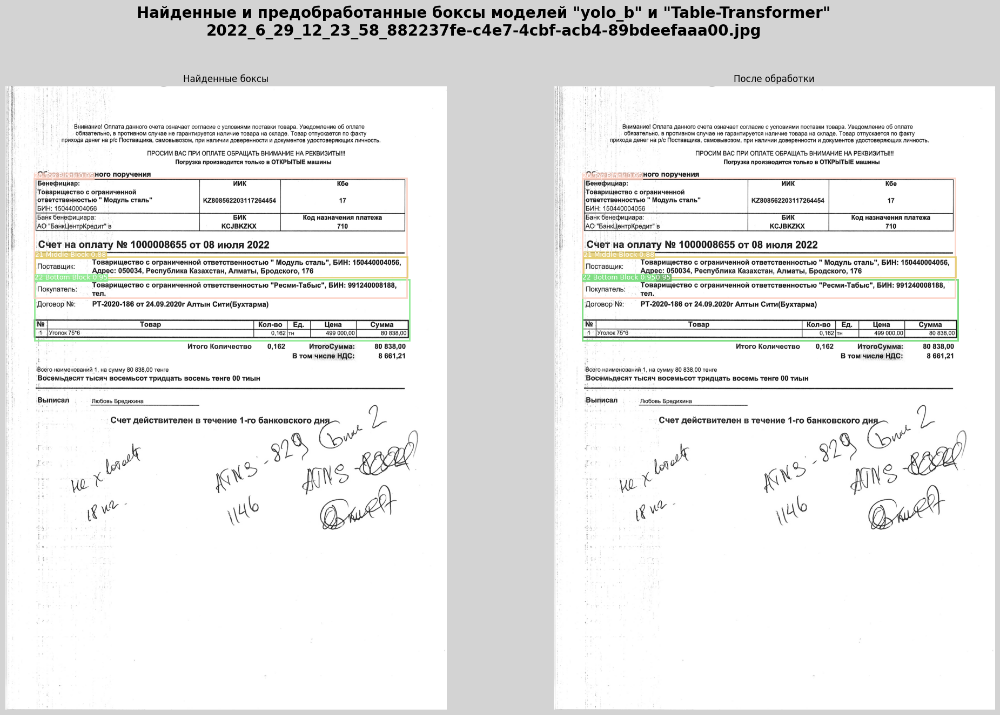

                                    Отчёт о работе модели yolo_b                                    
Найденные классы на изображении: 3/3
Найденные моделью классы: Counter({'22 Bottom Block': 1, '20 Top Block': 1, '21 Middle Block': 1})
Лучшие по confidence классы:
22 Bottom Block......................... 0.95255
20 Top Block............................ 0.94605
21 Middle Block......................... 0.88087
Пропущенных классов нет.
Расширенных боксов нет.

================================= Найденные боксы моделью yolo_b20 и результат их обработки =================================


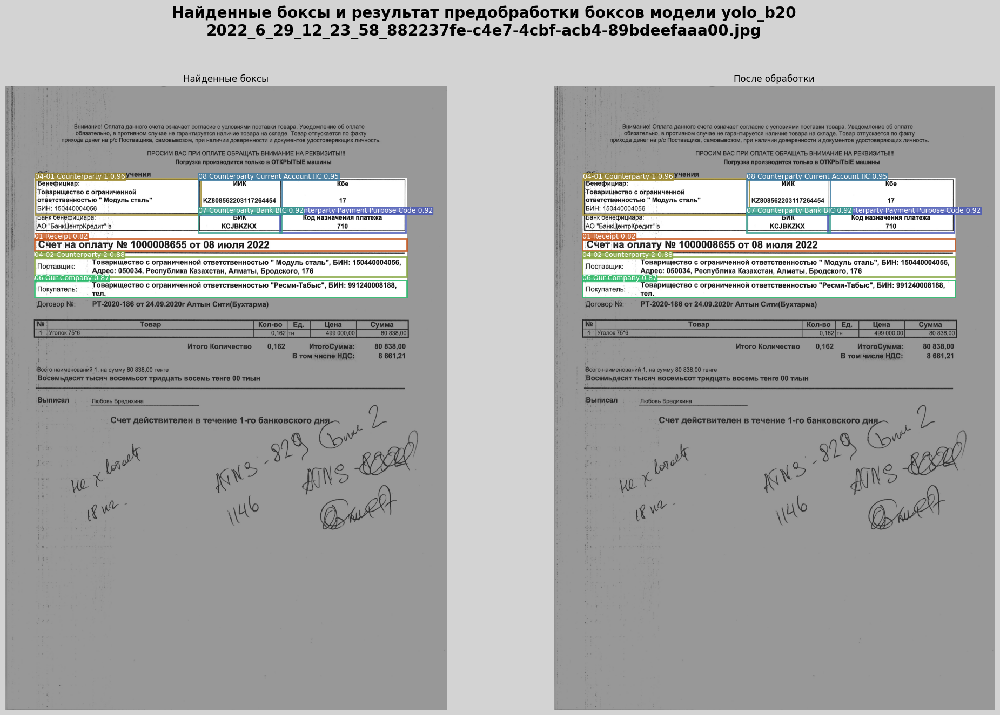

                                   Отчёт о работе модели yolo_b20                                   
Найденные классы на изображении: 7/7
Найденные моделью классы: Counter({'04-01 Counterparty 1': 1, '08 Counterparty Current Account IIC': 1, '09 Counterparty Payment Purpose Code': 1, '07 Counterparty Bank BIC': 1, '04-02 Counterparty 2': 1, '06 Our Company': 1, '01 Receipt': 1})
Лучшие по confidence классы:
04-01 Counterparty 1.................... 0.95670
08 Counterparty Current Account IIC..... 0.94816
09 Counterparty Payment Purpose Code.... 0.91941
07 Counterparty Bank BIC................ 0.91805
04-02 Counterparty 2.................... 0.87974
06 Our Company.......................... 0.87218
01 Receipt.............................. 0.82393
Пропущенных классов нет.
Расширенные на всю ширину изображения классы: ['01 Receipt', '06 Our Company', '04-02 Counterparty 2']

================================= Найденные боксы моделью yolo_b22 и результат их обработки =========================

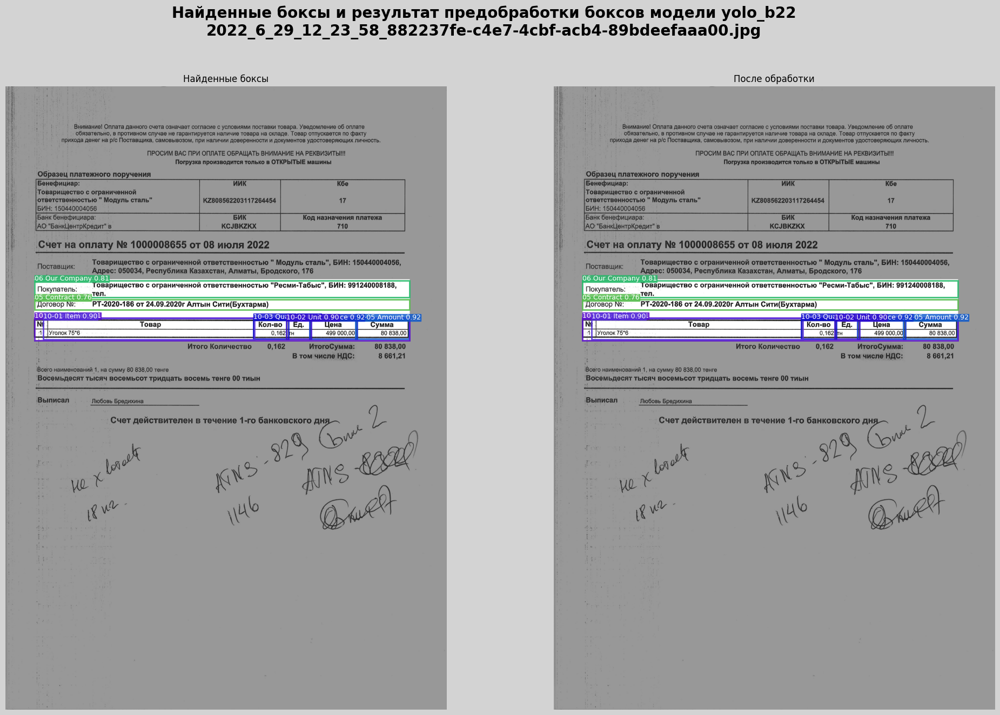

                                   Отчёт о работе модели yolo_b22                                   
Найденные классы на изображении: 8/8
Найденные моделью классы: Counter({'10-05 Amount': 1, '10-04 Price': 1, '10 Items Table': 1, '10-03 Quantity': 1, '10-02 Unit': 1, '10-01 Item': 1, '06 Our Company': 1, '05 Contract': 1})
Лучшие по confidence классы:
10-05 Amount............................ 0.92128
10-04 Price............................. 0.91664
10 Items Table.......................... 0.91285
10-03 Quantity.......................... 0.91001
10-02 Unit.............................. 0.89833
10-01 Item.............................. 0.89792
06 Our Company.......................... 0.80741
05 Contract............................. 0.76209
Пропущенных классов нет.
Расширенные на всю ширину изображения классы: ['06 Our Company', '05 Contract']

======================================================================== Отчёт о дублированных боксах =============================================

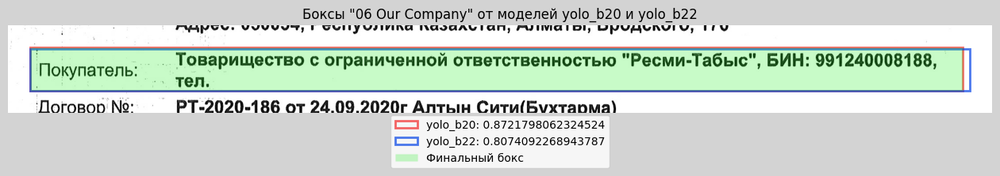


                                                               Боксы "21 Middle Block" и "04-02 Counterparty 2"                                                                


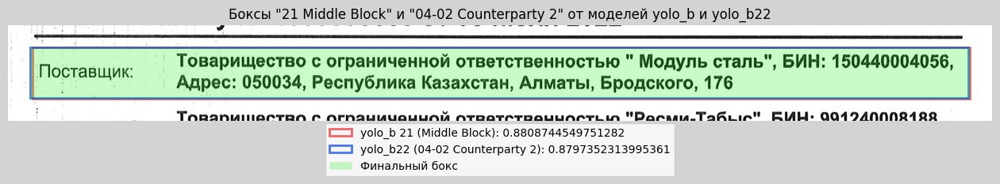

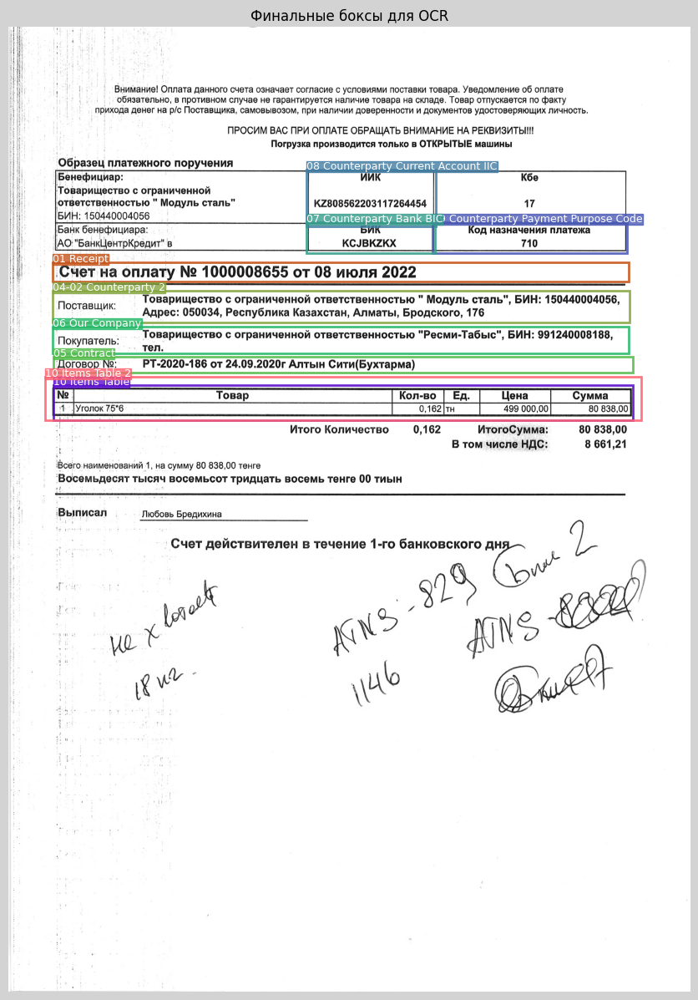

‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒ Распазнание ячеек таблицы ‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒
=========================================== Распознание таблицы (10 Items Table) ============================================
------------------------------------------- Распазнание ячеек таблицы через YOLO --------------------------------------------


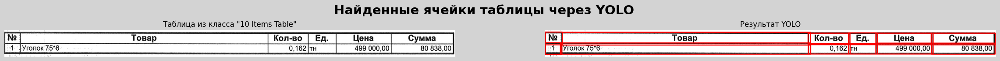

,№,Товар,Кол-во,Ед.,Цена,Сумма
0,,Уголок 75*6,"0,162",тн,"499 000,00","80 838,00"



------------------------------------- Распазнание ячеек таблицы через Table-Transformer -------------------------------------


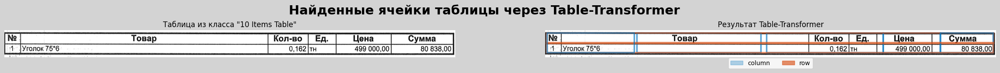

,№,Товар,Кол-во Ед.,Цена,Сумма
0,Уголок 75*6,,"0,162 тн","499 000,00","80 838,00"



========================================== Распознание таблицы (10 Items Table 2) ===========================================
------------------------------------------- Распазнание ячеек таблицы через YOLO --------------------------------------------
*Нет найденных ячеек в таблице*

------------------------------------- Распазнание ячеек таблицы через Table-Transformer -------------------------------------
*Нет найденных ячеек в таблице*

‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒ Финальный датафрейм таблицы ‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒


,№,Товар,Кол-во,Ед.,Цена,Сумма
0,Уголок 75*6,Уголок 75*6,"0,162",тн,"499 000,00","80 838,00"



========================================== Распознание классов модели yolo_b (OCR) ==========================================
*Нет боксов для распознания OCR*

========================================= Распознание классов модели yolo_b20 (OCR) =========================================
                                08 Counterparty Current Account IIC                                 


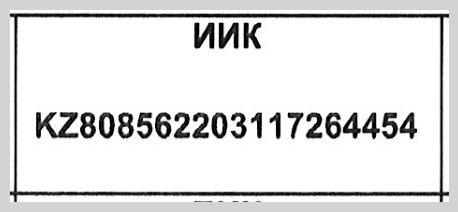

ИИК KZ808562203117264454

                                09 Counterparty Payment Purpose Code                                


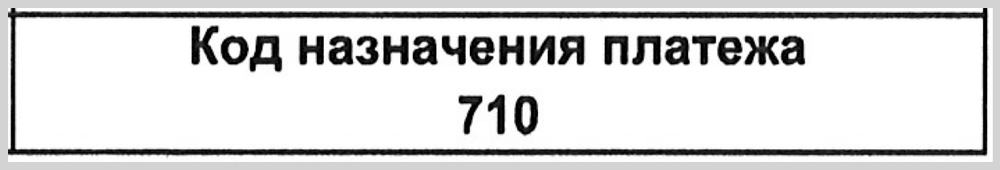

Код назначения платежа 710

                                      07 Counterparty Bank BIC                                      


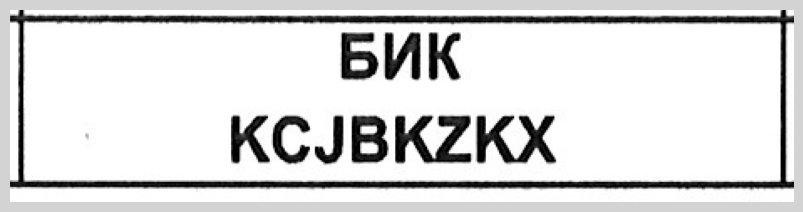

БИК KCJBKZKX

                                        04-02 Counterparty 2                                        


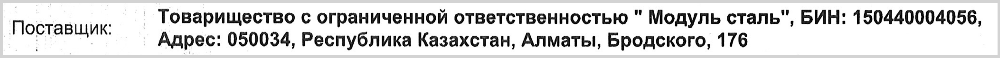

Товарищество с ограниченной ответственностью Модуль сталь БИН: 150440004056, Поставщик: Адрес: 050034, Республика Казахстан, Алматы, Бродского, 176

                                           06 Our Company                                           


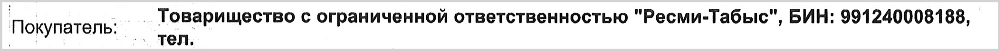

Товарищество с ограниченной ответственностью "Ресми-Табыс", БИН: 991240008188, Покупатель: тел.

                                             01 Receipt                                             


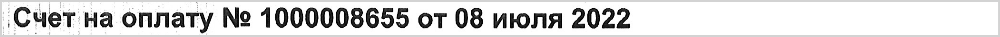

Счет на оплату № 1000008655 от 08 июля 2022

========================================= Распознание классов модели yolo_b22 (OCR) =========================================
                                           06 Our Company                                           


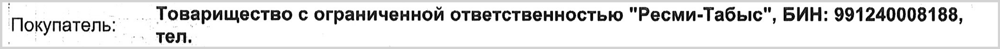

Товарищество с ограниченной ответственностью "Ресми-Табыс", БИН: 991240008188, Покупатель: тел.

                                            05 Contract                                             


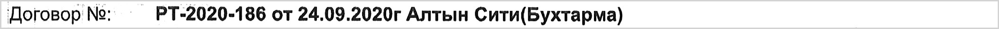

Договор №: PT-2020-186 от 24.09.2020г Алтын Сити(Бухтарма)

════════════════════════════════════════════════ Отчёт о постобработке текста из боксов для json файла════════════════════════════════════════════════
─────────────────────────────────────────────────────────────── Словарь без обработки ────────────────────────────────────────────────────────────────
01 Receipt Number : Счет на оплату № 1000008655 от 08 июля 2022
02 Receipt Date   : Счет на оплату № 1000008655 от 08 июля 2022
04 Counterparty   :
	04-01 Name        : Товарищество с ограниченной ответственностью Модуль сталь БИН: 150440004056, Поставщик: Адрес: 050034, Республика Казахстан, Алматы, Бродского, 176
	04-02 BIN         : Товарищество с ограниченной ответственностью Модуль сталь БИН: 150440004056, Поставщик: Адрес: 050034, Республика Казахстан, Алматы, Бродского, 176

05 Contract       : Договор №: PT-2020-186 от 24.09.2020г Алтын Сити(Бухтарма)
06 Our Company BIN: Товарищество с ограниченной ответственностью "Ресми-

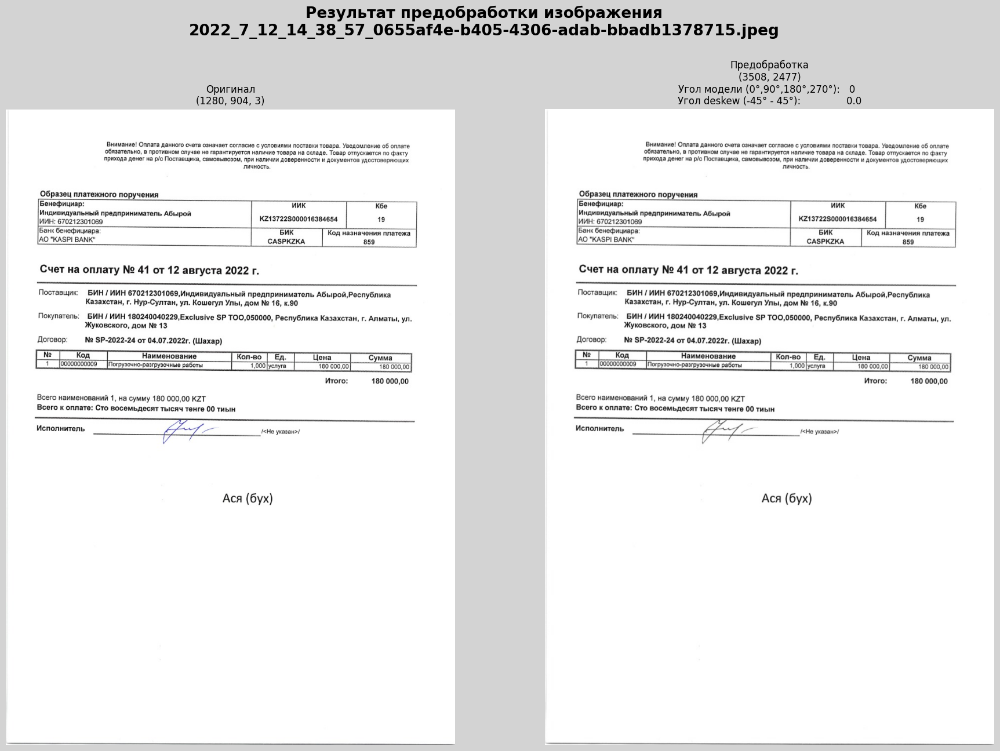

================================== Найденные боксы моделью yolo_b и результат их обработки ==================================


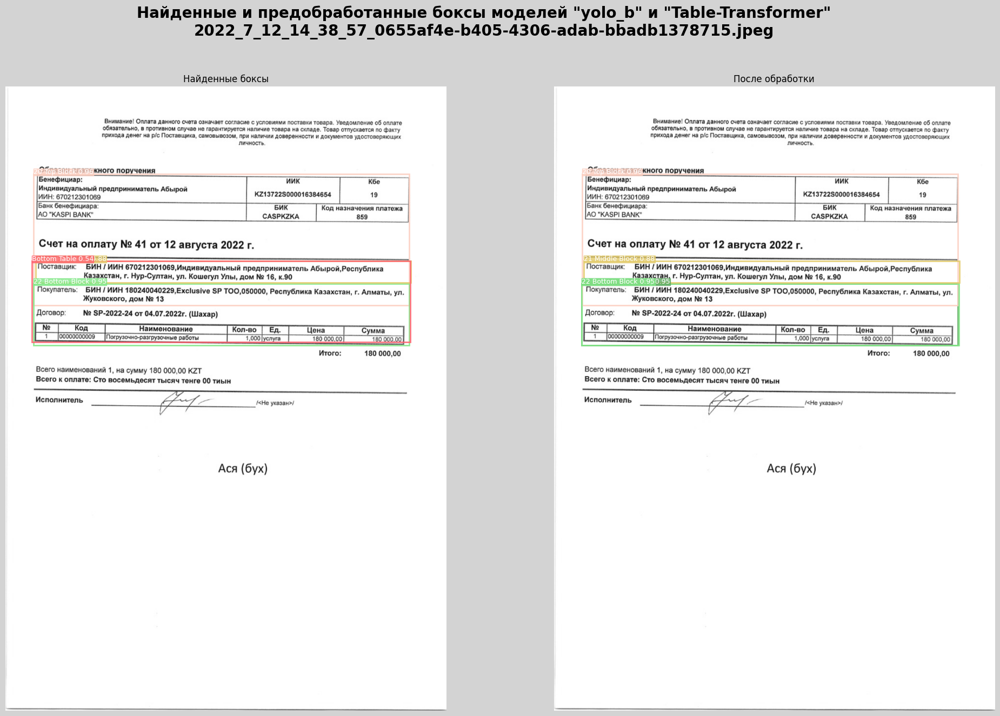

                                    Отчёт о работе модели yolo_b                                    
Найденные классы на изображении: 3/3
Найденные моделью классы: Counter({'20 Top Block': 1, '22 Bottom Block': 1, '21 Middle Block': 1})
Лучшие по confidence классы:
20 Top Block............................ 0.96282
22 Bottom Block......................... 0.95131
21 Middle Block......................... 0.88062
Пропущенных классов нет.
Расширенных боксов нет.

================================= Найденные боксы моделью yolo_b20 и результат их обработки =================================


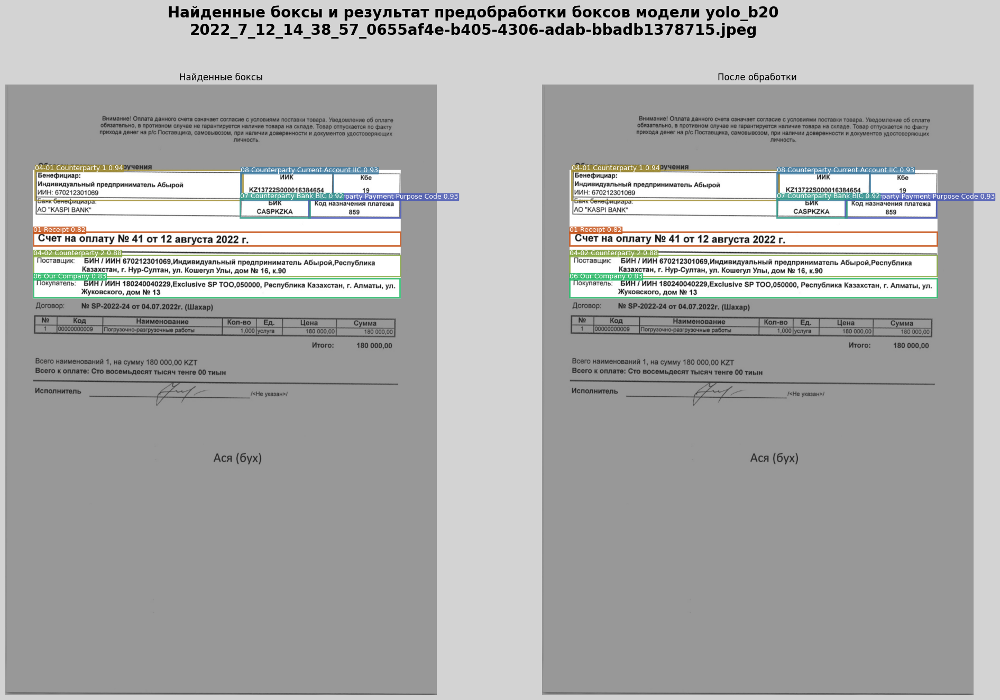

                                   Отчёт о работе модели yolo_b20                                   
Найденные классы на изображении: 7/7
Найденные моделью классы: Counter({'04-01 Counterparty 1': 1, '08 Counterparty Current Account IIC': 1, '09 Counterparty Payment Purpose Code': 1, '07 Counterparty Bank BIC': 1, '04-02 Counterparty 2': 1, '06 Our Company': 1, '01 Receipt': 1})
Лучшие по confidence классы:
04-01 Counterparty 1.................... 0.93719
08 Counterparty Current Account IIC..... 0.93204
09 Counterparty Payment Purpose Code.... 0.92680
07 Counterparty Bank BIC................ 0.92115
04-02 Counterparty 2.................... 0.87730
06 Our Company.......................... 0.83251
01 Receipt.............................. 0.81703
Пропущенных классов нет.
Расширенные на всю ширину изображения классы: ['01 Receipt', '06 Our Company', '04-02 Counterparty 2']

================================= Найденные боксы моделью yolo_b22 и результат их обработки =========================

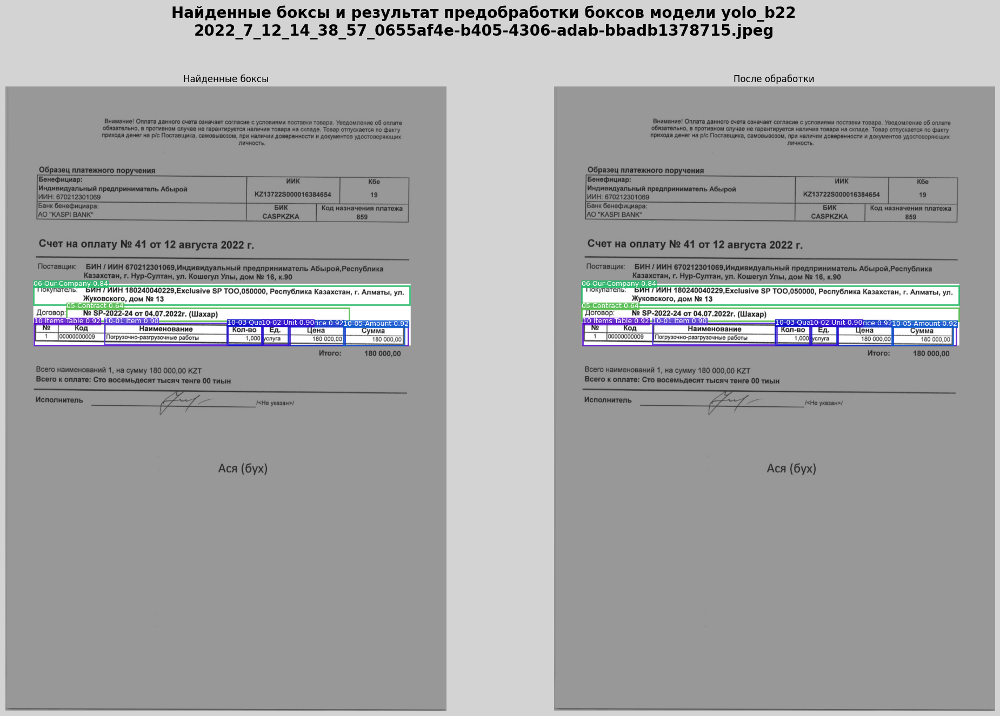

                                   Отчёт о работе модели yolo_b22                                   
Найденные классы на изображении: 8/8
Найденные моделью классы: Counter({'10 Items Table': 1, '10-04 Price': 1, '10-05 Amount': 1, '10-03 Quantity': 1, '10-02 Unit': 1, '10-01 Item': 1, '06 Our Company': 1, '05 Contract': 1})
Лучшие по confidence классы:
10 Items Table.......................... 0.92247
10-04 Price............................. 0.91521
10-05 Amount............................ 0.91510
10-03 Quantity.......................... 0.91281
10-02 Unit.............................. 0.90388
10-01 Item.............................. 0.89940
06 Our Company.......................... 0.84476
05 Contract............................. 0.64021
Пропущенных классов нет.
Расширенные на всю ширину изображения классы: ['06 Our Company', '05 Contract']

======================================================================== Отчёт о дублированных боксах =============================================

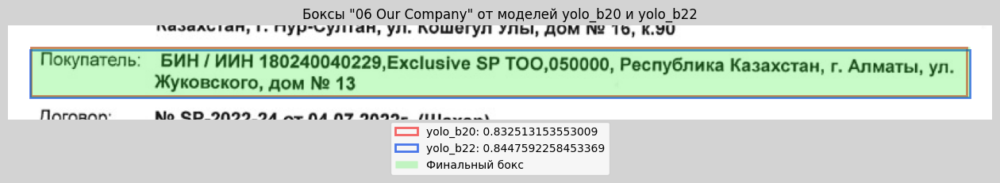


                                                               Боксы "21 Middle Block" и "04-02 Counterparty 2"                                                                


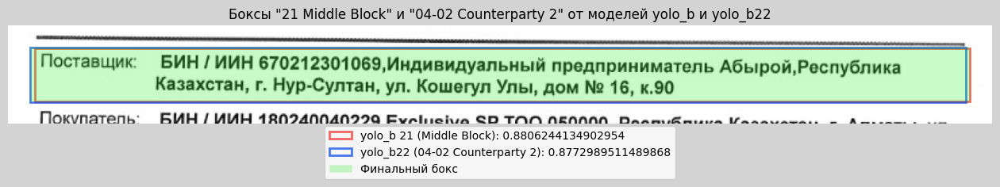

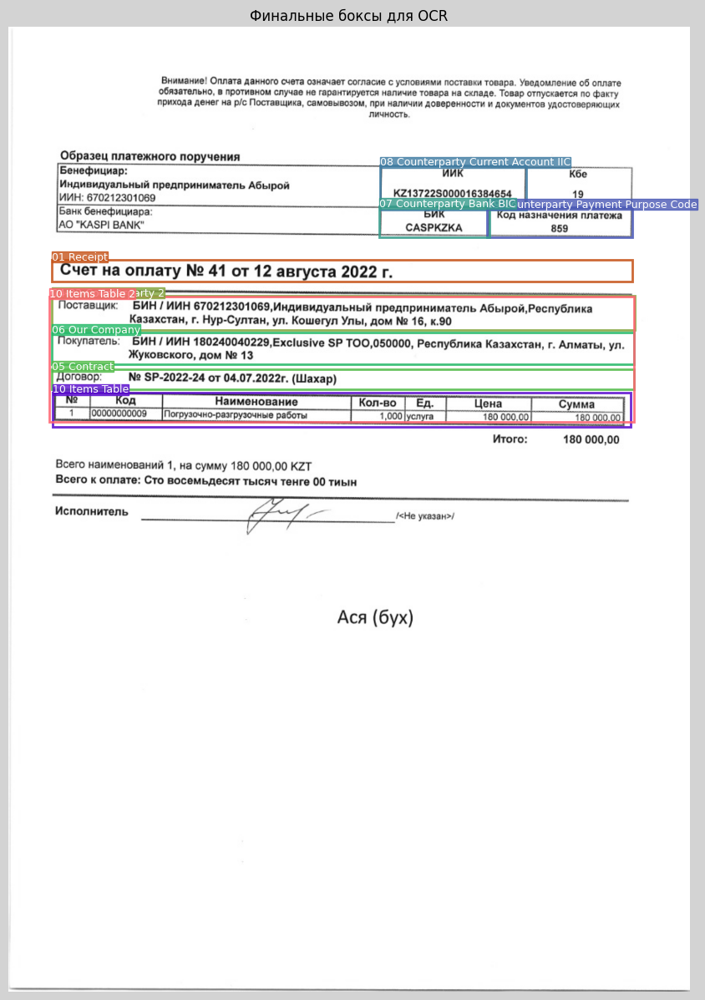

‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒ Распазнание ячеек таблицы ‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒
=========================================== Распознание таблицы (10 Items Table) ============================================
------------------------------------------- Распазнание ячеек таблицы через YOLO --------------------------------------------


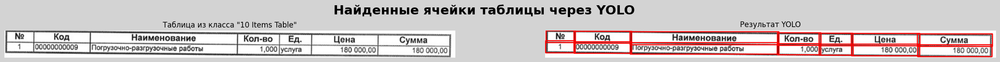

,№,Код,Наименование,Кол-во,Ед.,Цена,Сумма
0,,00000000009,Погрузочно-разгрузочные работы,"1,000",услуга,"180 000,00","180 000,00"



------------------------------------- Распазнание ячеек таблицы через Table-Transformer -------------------------------------


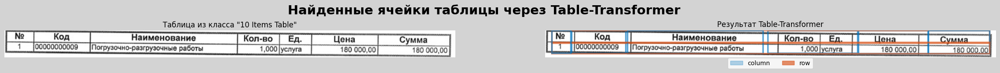

,№,Код,Наименование,Кол-во Ед.,Цена,Сумма
0,,00000000009,Погрузочно-разгрузочные работы,"1,000 услуга","180 000,00","180 000,00"



========================================== Распознание таблицы (10 Items Table 2) ===========================================
------------------------------------------- Распазнание ячеек таблицы через YOLO --------------------------------------------
*Нет найденных ячеек в таблице*

------------------------------------- Распазнание ячеек таблицы через Table-Transformer -------------------------------------
*Нет найденных ячеек в таблице*

‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒ Финальный датафрейм таблицы ‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒


,№,Код,Наименование,Кол-во,Ед.,Цена,Сумма
0,,00000000009,Погрузочно-разгрузочные работы,"1,000",услуга,"180 000,00","180 000,00"



========================================== Распознание классов модели yolo_b (OCR) ==========================================
*Нет боксов для распознания OCR*

========================================= Распознание классов модели yolo_b20 (OCR) =========================================
                                08 Counterparty Current Account IIC                                 


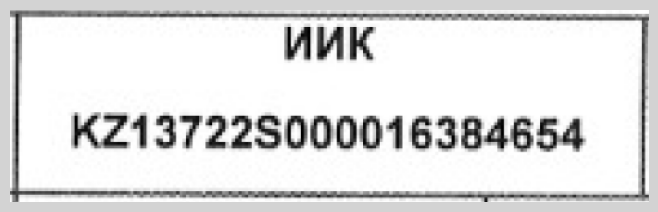

ИИК KZ13722S000016384654

                                09 Counterparty Payment Purpose Code                                


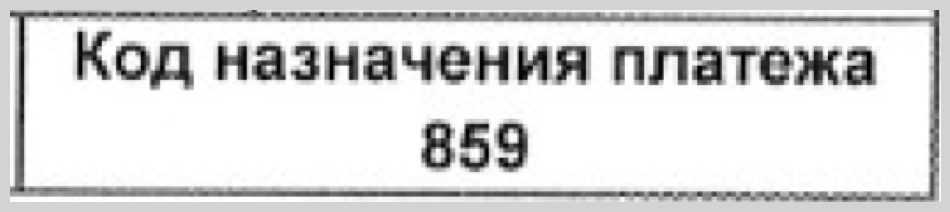

Код назначения платежа 859

                                      07 Counterparty Bank BIC                                      


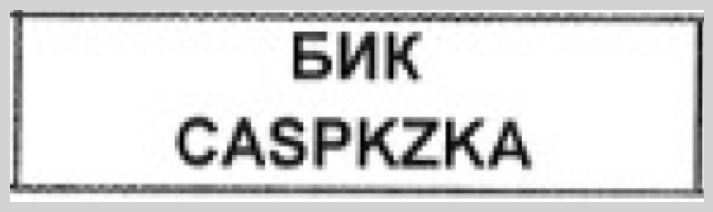

БИК CASPKZKA

                                        04-02 Counterparty 2                                        


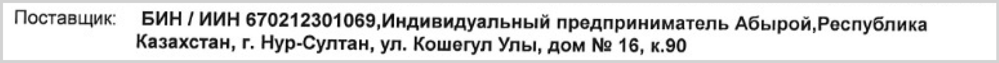

Поставщик: БИН / ИИН 670212301069,Индивидуальный предприниматель Абырой,Республика Казахстан, г. Нур-Султан, ул. Кошегул Улы, дом № 16, к.90

                                           06 Our Company                                           


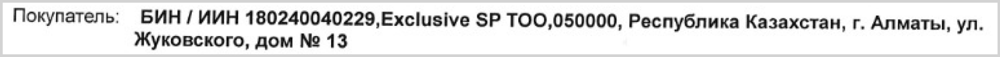

Покупатель: БИН / ИИН 180240040229,Exclusive GP ТОО,050000, Республика Казахстан, г. Алматы, ул. Жуковского, дом № 13

                                             01 Receipt                                             


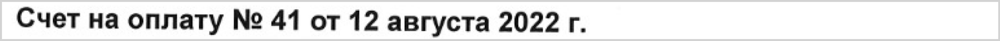

Счет на оплату № 41 от 12 августа 2022 г.

========================================= Распознание классов модели yolo_b22 (OCR) =========================================
                                           06 Our Company                                           


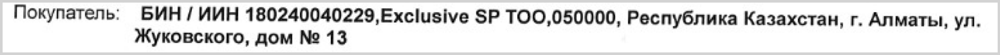

Покупатель: БИН / ИИН 180240040229,Exclusive GP ТОО,050000, Республика Казахстан, г. Алматы, ул. Жуковского, дом № 13

                                            05 Contract                                             


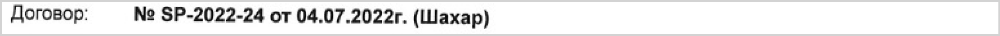

Договор: № SP-2022-24 от 04.07.2022г. (Шахар)

════════════════════════════════════════════════ Отчёт о постобработке текста из боксов для json файла════════════════════════════════════════════════
─────────────────────────────────────────────────────────────── Словарь без обработки ────────────────────────────────────────────────────────────────
01 Receipt Number : Счет на оплату № 41 от 12 августа 2022 г.
02 Receipt Date   : Счет на оплату № 41 от 12 августа 2022 г.
04 Counterparty   :
	04-01 Name        : Поставщик: БИН / ИИН 670212301069,Индивидуальный предприниматель Абырой,Республика Казахстан, г. Нур-Султан, ул. Кошегул Улы, дом № 16, к.90
	04-02 BIN         : Поставщик: БИН / ИИН 670212301069,Индивидуальный предприниматель Абырой,Республика Казахстан, г. Нур-Султан, ул. Кошегул Улы, дом № 16, к.90

05 Contract       : Договор: № SP-2022-24 от 04.07.2022г. (Шахар)
06 Our Company BIN: Покупатель: БИН / ИИН 180240040229,Exclusive GP ТОО,050000, Республика Казахстан, г. Алматы, ул.

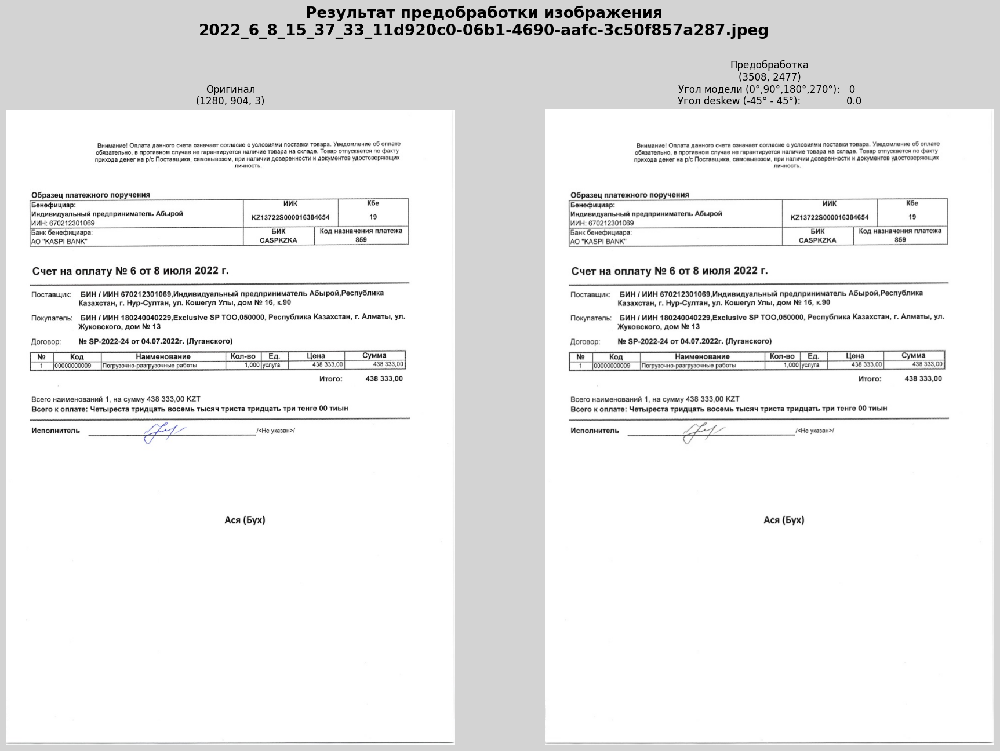

================================== Найденные боксы моделью yolo_b и результат их обработки ==================================


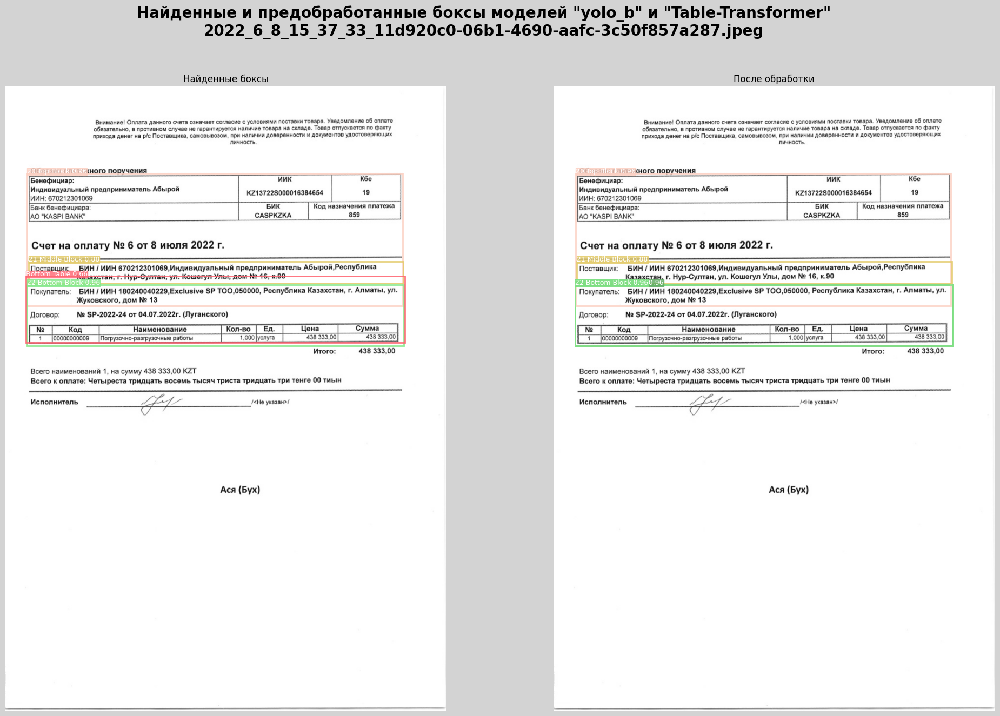

                                    Отчёт о работе модели yolo_b                                    
Найденные классы на изображении: 3/3
Найденные моделью классы: Counter({'20 Top Block': 1, '22 Bottom Block': 1, '21 Middle Block': 1})
Лучшие по confidence классы:
20 Top Block............................ 0.96458
22 Bottom Block......................... 0.96098
21 Middle Block......................... 0.87960
Пропущенных классов нет.
Расширенных боксов нет.

================================= Найденные боксы моделью yolo_b20 и результат их обработки =================================


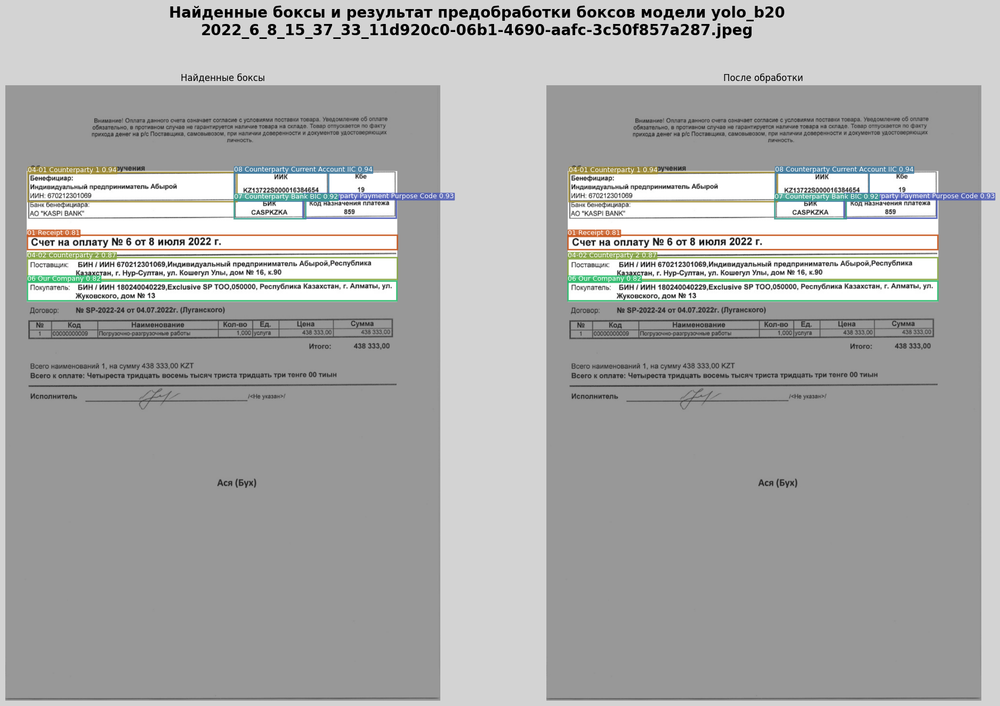

                                   Отчёт о работе модели yolo_b20                                   
Найденные классы на изображении: 7/7
Найденные моделью классы: Counter({'08 Counterparty Current Account IIC': 1, '04-01 Counterparty 1': 1, '09 Counterparty Payment Purpose Code': 1, '07 Counterparty Bank BIC': 1, '04-02 Counterparty 2': 1, '06 Our Company': 1, '01 Receipt': 1})
Лучшие по confidence классы:
08 Counterparty Current Account IIC..... 0.94299
04-01 Counterparty 1.................... 0.93852
09 Counterparty Payment Purpose Code.... 0.93066
07 Counterparty Bank BIC................ 0.92369
04-02 Counterparty 2.................... 0.87311
06 Our Company.......................... 0.81795
01 Receipt.............................. 0.81385
Пропущенных классов нет.
Расширенные на всю ширину изображения классы: ['01 Receipt', '06 Our Company', '04-02 Counterparty 2']

================================= Найденные боксы моделью yolo_b22 и результат их обработки =========================

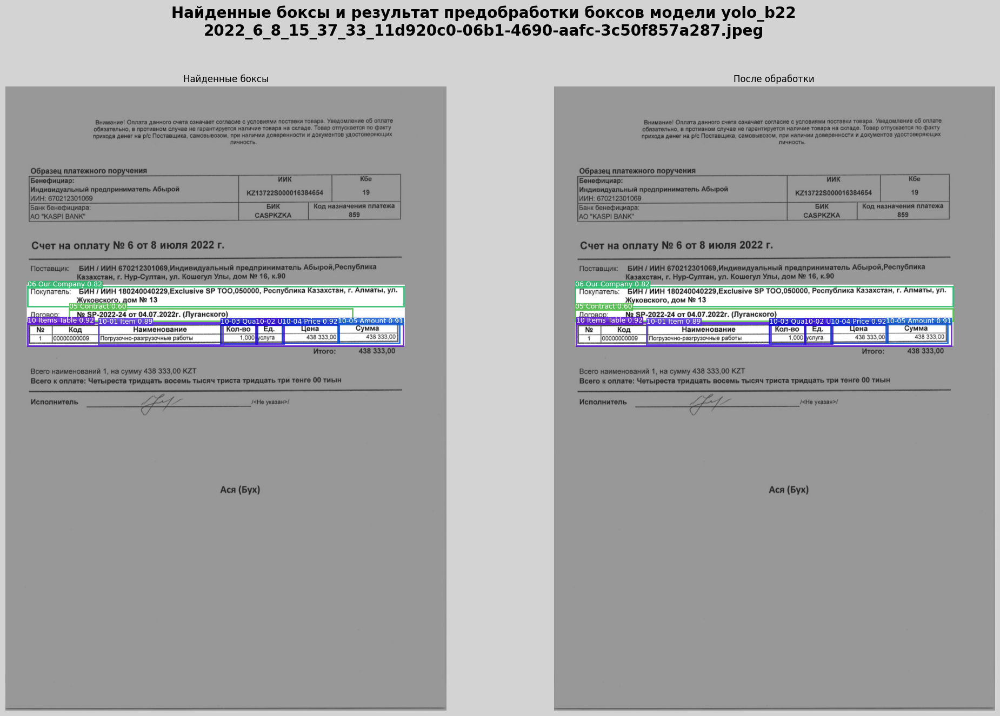

                                   Отчёт о работе модели yolo_b22                                   
Найденные классы на изображении: 8/8
Найденные моделью классы: Counter({'10-03 Quantity': 1, '10-02 Unit': 1, '10-04 Price': 1, '10 Items Table': 1, '10-05 Amount': 1, '10-01 Item': 1, '06 Our Company': 1, '05 Contract': 1})
Лучшие по confidence классы:
10-03 Quantity.......................... 0.93108
10-02 Unit.............................. 0.92227
10-04 Price............................. 0.91965
10 Items Table.......................... 0.91620
10-05 Amount............................ 0.91352
10-01 Item.............................. 0.89328
06 Our Company.......................... 0.81641
05 Contract............................. 0.59703
Пропущенных классов нет.
Расширенные на всю ширину изображения классы: ['06 Our Company', '05 Contract']

======================================================================== Отчёт о дублированных боксах =============================================

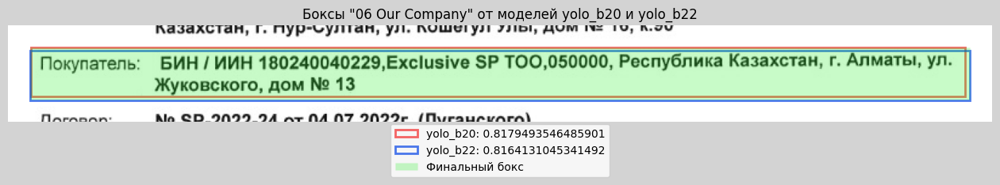


                                                               Боксы "21 Middle Block" и "04-02 Counterparty 2"                                                                


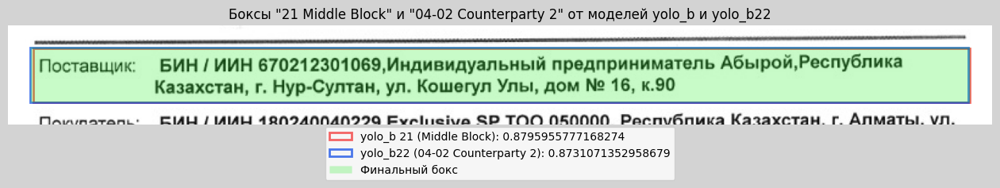

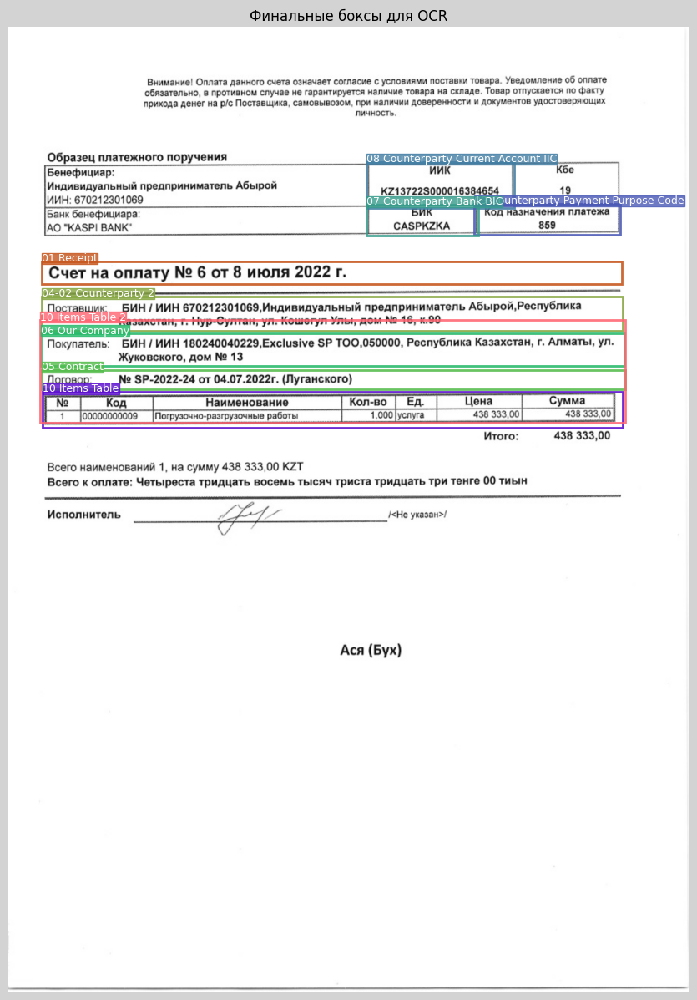

‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒ Распазнание ячеек таблицы ‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒
=========================================== Распознание таблицы (10 Items Table) ============================================
------------------------------------------- Распазнание ячеек таблицы через YOLO --------------------------------------------


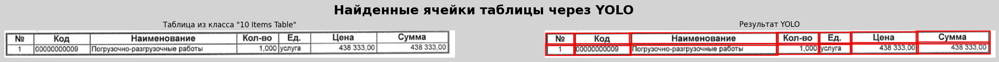

,№,Код,Наименование,Кол-во,Ед.,Цена,Сумма
0,,00000000009,Погрузочно-разгрузочные работы,"1,000",услуга,"438 333,00","438 333,00"



------------------------------------- Распазнание ячеек таблицы через Table-Transformer -------------------------------------


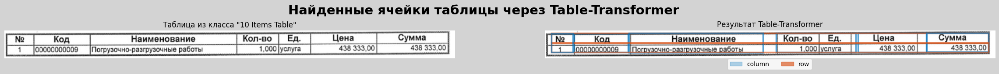

,№,Код,Наименование,Кол-во Ед.,Цена,Сумма
0,,,азгрузочные работы,"1,000 услуга","438 333,00","438 333,00"



========================================== Распознание таблицы (10 Items Table 2) ===========================================
------------------------------------------- Распазнание ячеек таблицы через YOLO --------------------------------------------
*Нет найденных ячеек в таблице*

------------------------------------- Распазнание ячеек таблицы через Table-Transformer -------------------------------------
*Нет найденных ячеек в таблице*

‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒ Финальный датафрейм таблицы ‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒


,№,Код,Наименование,Кол-во,Ед.,Цена,Сумма
0,,00000000009,Погрузочно-разгрузочные работы,"1,000",услуга,"438 333,00","438 333,00"



========================================== Распознание классов модели yolo_b (OCR) ==========================================
*Нет боксов для распознания OCR*

========================================= Распознание классов модели yolo_b20 (OCR) =========================================
                                08 Counterparty Current Account IIC                                 


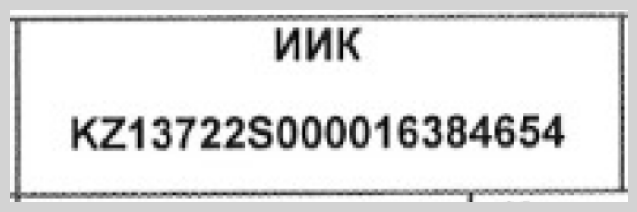

ИИК KZ13722S000016384654

                                09 Counterparty Payment Purpose Code                                


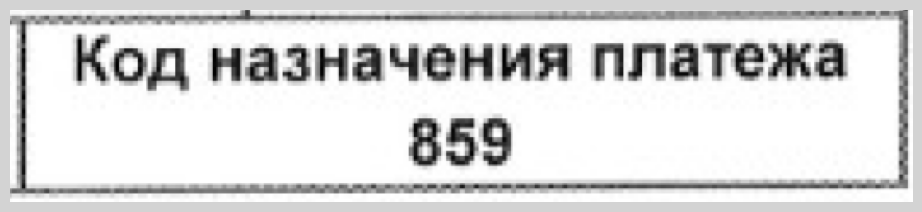

Код назначения платежа 859

                                      07 Counterparty Bank BIC                                      


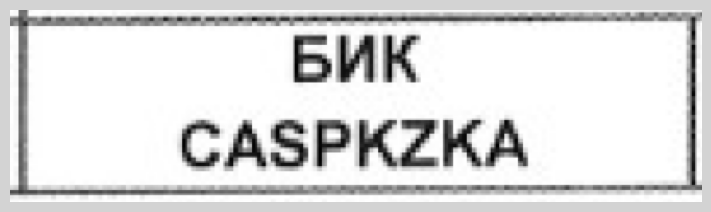

БИК CASPKZKA

                                        04-02 Counterparty 2                                        


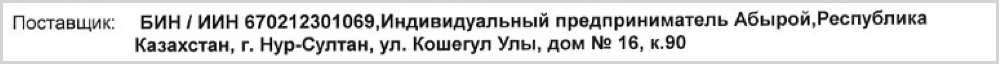

Поставщик: БИИН / ИИН 670212301069,Индивидуальный предприниматель Абырой,Республика Казахстан, г. Нур-Султан, ул. Кошегул Улы, дом № 16, к.90

                                           06 Our Company                                           


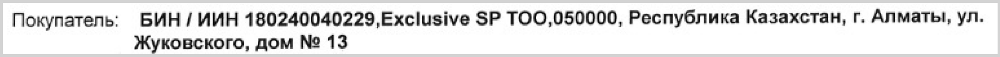

Покупатель: БИН ИИН 180240040229,Exclusive SP ТОО,050000, Республика Казахстан, г. Алматы, ул. Жуковского, дом № 13

                                             01 Receipt                                             


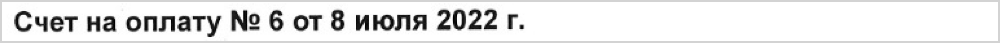

Счет на оплату № 6 от 8 июля 2022 г.

========================================= Распознание классов модели yolo_b22 (OCR) =========================================
                                           06 Our Company                                           


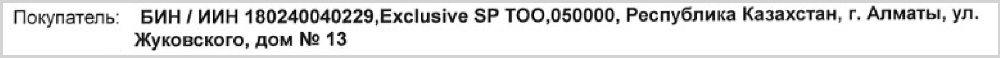

Покупатель: БИН ИИН 180240040229,Exclusive SP ТОО,050000, Республика Казахстан, г. Алматы, ул. Жуковского, дом № 13

                                            05 Contract                                             


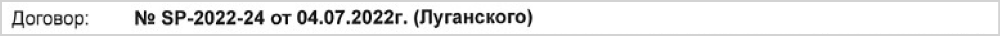

Договор: № SP-2022-24 от 04.07.2022г. (Луганского)

════════════════════════════════════════════════ Отчёт о постобработке текста из боксов для json файла════════════════════════════════════════════════
─────────────────────────────────────────────────────────────── Словарь без обработки ────────────────────────────────────────────────────────────────
01 Receipt Number : Счет на оплату № 6 от 8 июля 2022 г.
02 Receipt Date   : Счет на оплату № 6 от 8 июля 2022 г.
04 Counterparty   :
	04-01 Name        : Поставщик: БИИН / ИИН 670212301069,Индивидуальный предприниматель Абырой,Республика Казахстан, г. Нур-Султан, ул. Кошегул Улы, дом № 16, к.90
	04-02 BIN         : Поставщик: БИИН / ИИН 670212301069,Индивидуальный предприниматель Абырой,Республика Казахстан, г. Нур-Султан, ул. Кошегул Улы, дом № 16, к.90

05 Contract       : Договор: № SP-2022-24 от 04.07.2022г. (Луганского)
06 Our Company BIN: Покупатель: БИН ИИН 180240040229,Exclusive SP ТОО,050000, Республика Казахстан, г. Алматы, ул.

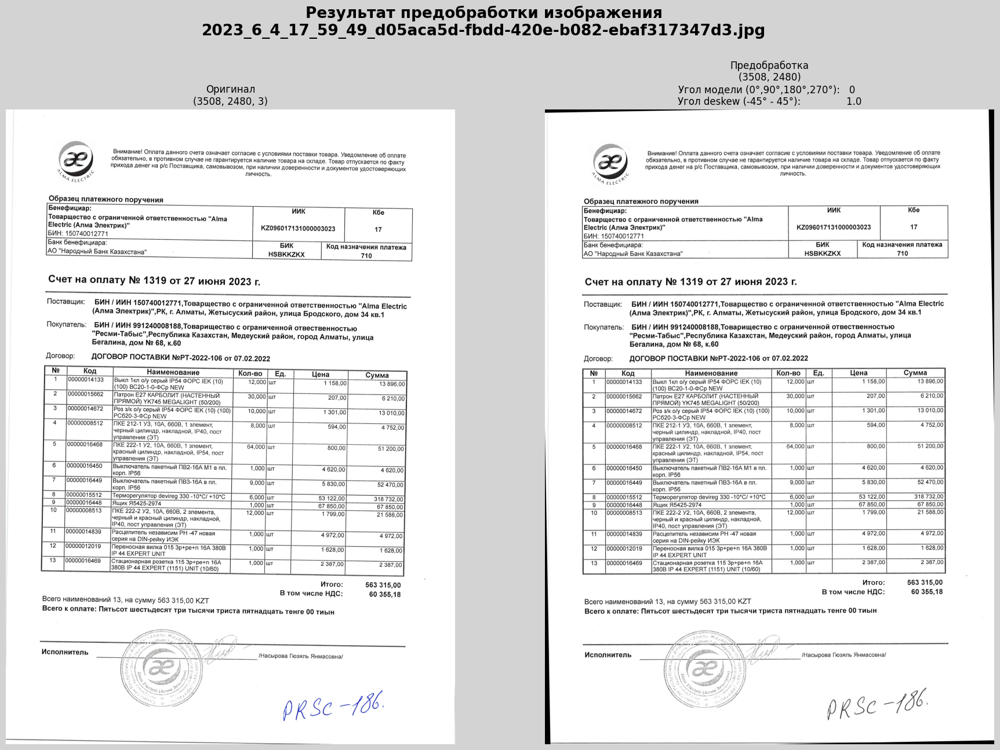

================================== Найденные боксы моделью yolo_b и результат их обработки ==================================


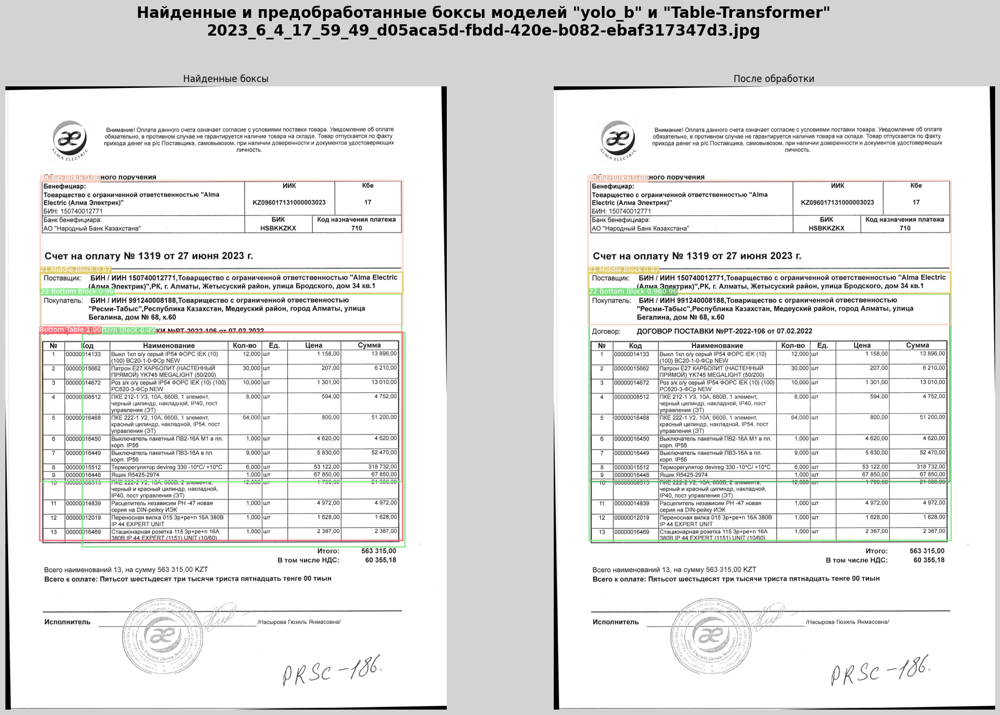

                                    Отчёт о работе модели yolo_b                                    
Найденные классы на изображении: 3/3
Найденные моделью классы: Counter({'22 Bottom Block': 2, '20 Top Block': 1, '21 Middle Block': 1})
Лучшие по confidence классы:
22 Bottom Block......................... 0.96123
20 Top Block............................ 0.95590
21 Middle Block......................... 0.86659
Пропущенных классов нет.
Расширенных боксов нет.

================================= Найденные боксы моделью yolo_b20 и результат их обработки =================================


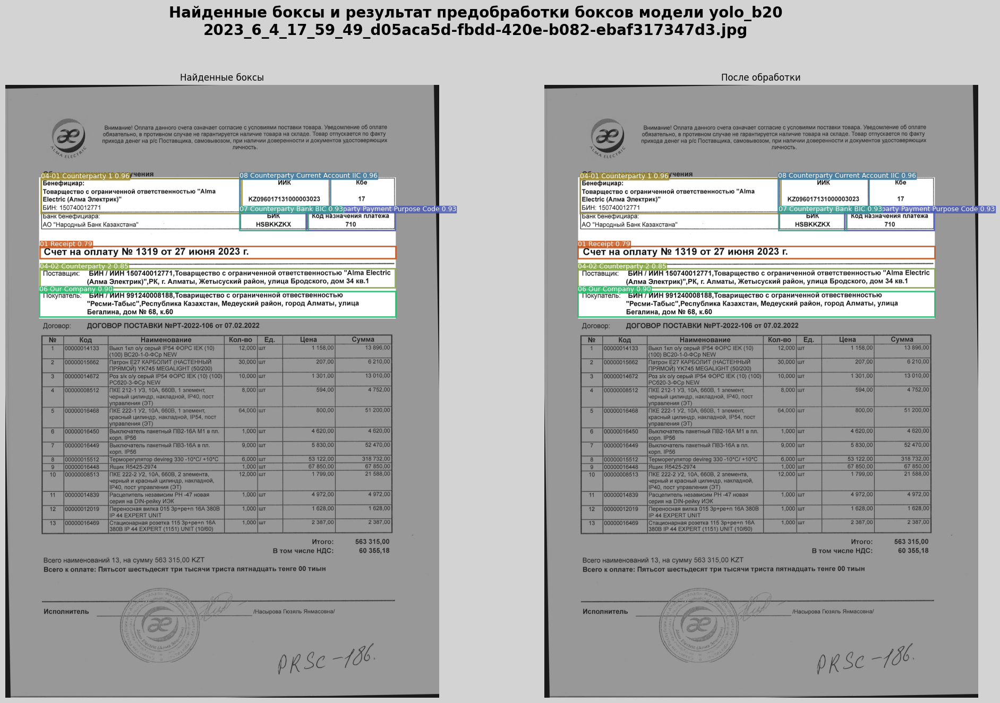

                                   Отчёт о работе модели yolo_b20                                   
Найденные классы на изображении: 7/7
Найденные моделью классы: Counter({'08 Counterparty Current Account IIC': 1, '04-01 Counterparty 1': 1, '09 Counterparty Payment Purpose Code': 1, '07 Counterparty Bank BIC': 1, '06 Our Company': 1, '04-02 Counterparty 2': 1, '01 Receipt': 1})
Лучшие по confidence классы:
08 Counterparty Current Account IIC..... 0.95579
04-01 Counterparty 1.................... 0.95579
09 Counterparty Payment Purpose Code.... 0.93080
07 Counterparty Bank BIC................ 0.93005
06 Our Company.......................... 0.89937
04-02 Counterparty 2.................... 0.85291
01 Receipt.............................. 0.79483
Пропущенных классов нет.
Расширенные на всю ширину изображения классы: ['01 Receipt', '06 Our Company', '04-02 Counterparty 2']

================================= Найденные боксы моделью yolo_b22 и результат их обработки =========================

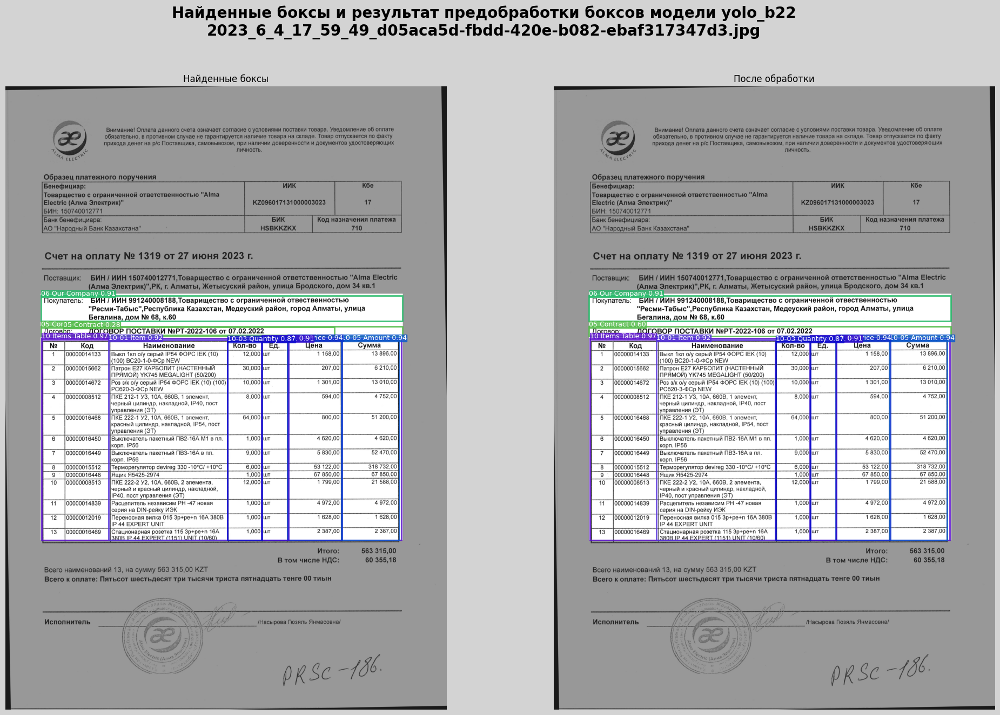

                                   Отчёт о работе модели yolo_b22                                   
Найденные классы на изображении: 8/8
Найденные моделью классы: Counter({'05 Contract': 2, '10 Items Table': 1, '10-05 Amount': 1, '10-04 Price': 1, '10-01 Item': 1, '10-02 Unit': 1, '06 Our Company': 1, '10-03 Quantity': 1})
Лучшие по confidence классы:
10 Items Table.......................... 0.97397
10-05 Amount............................ 0.93574
10-04 Price............................. 0.93552
10-01 Item.............................. 0.91799
10-02 Unit.............................. 0.91139
06 Our Company.......................... 0.90795
10-03 Quantity.......................... 0.87349
05 Contract............................. 0.59744
Пропущенных классов нет.
Расширенные на всю ширину изображения классы: ['06 Our Company', '05 Contract']

======================================================================== Отчёт о дублированных боксах =============================================

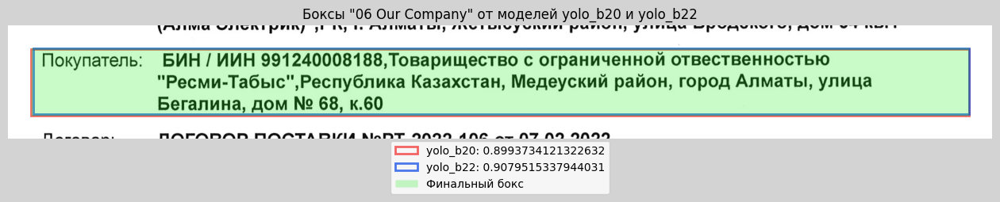


                                                               Боксы "21 Middle Block" и "04-02 Counterparty 2"                                                                


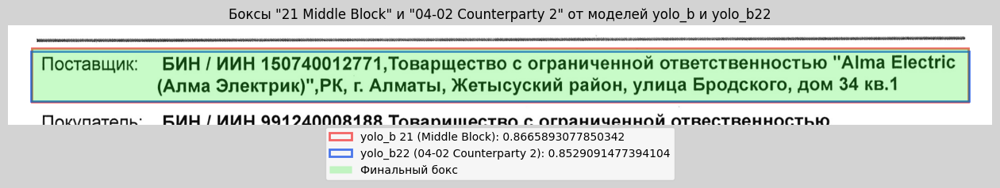

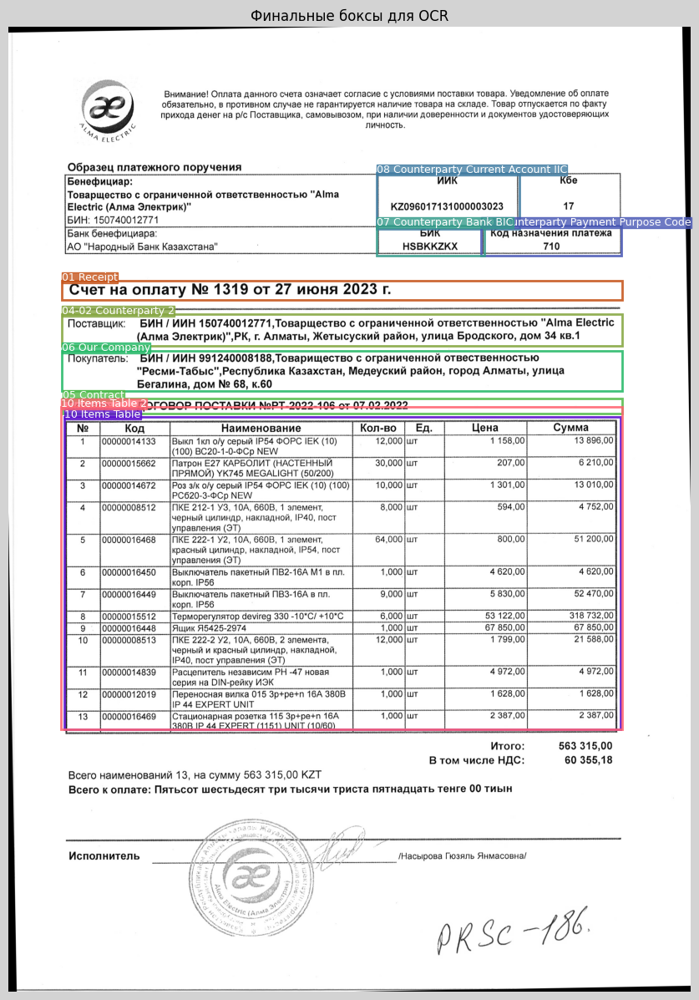

‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒ Распазнание ячеек таблицы ‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒
=========================================== Распознание таблицы (10 Items Table) ============================================
------------------------------------------- Распазнание ячеек таблицы через YOLO --------------------------------------------


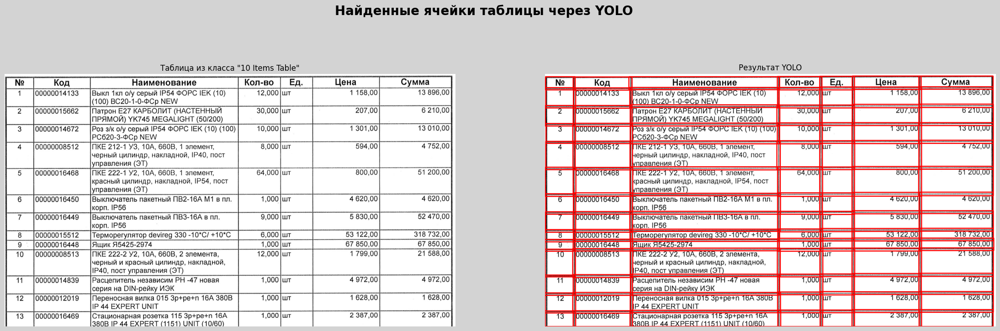

,№,Код,Наименование,Кол-во,Ед.,Цена,Сумма
0,,00000014133,Выкл 1кл о/у серый IР54 ФОРС IЕK (10) (100) ВС20-1-0-ФСр NEW,"12,000",шт,"1 158,00","13 896,00"
1,2,00000015662,Патрон E27 КАРБОЛИТ (НАСТЕННЫЙ ПРЯМОЙ) YK745 MEGALIGHT (50/200),"30,000",шт,"207,00","6 210,00"
2,3,00000014672,Роз з/к о/у серый IP54 ФОРС IЕK (10) (100) РС620-3-ФСр NEW,"10,000",шт,"1 301,00","13 010,00"
3,,00000008512,"ПКЕ 212-1 УЗ, 10A, 660В, 1 элемент, черный цилиндр, накладной, IР40, пост управления (ЭТ)","8,000",шт,"594,00","4 752,00"
4,5,00000016468,"ПКЕ 222-1 У2, 10A, 660В, 1 элемент, красный цилиндр, накладной, IР54, пост управления (ЭТ)","64,000",шт,"800,00","51 200,00"
5,6,00000016450,Выключатель пакетный ПВ2-16A M1 в пл. корп. IР56,"1,000",шт,"4 620,00","620,00"
6,,00000016449,Выключатель пакетный ПВЗ-16А в пл. корп. IР56,"9,000",шт,"5 830,00","52 470,00"
7,8,00000015512,Терморегулятор devireg 330 -10*C/ +10*С,"6,000",шт,"53 122,00","318 732,00"
8,9,00000016448,Ящик Я5425-2974,"1,000",шт,"67 850,00","67 850,00"
9,10,00000008513,"ПКЕ 222-2 У2, 10A, 660В, 2 элемента, черный и красный цилиндр, накладной, Р40, пост управления (ЭТ)","12,000",шт,"1 799,00","21 588,00"



------------------------------------- Распазнание ячеек таблицы через Table-Transformer -------------------------------------


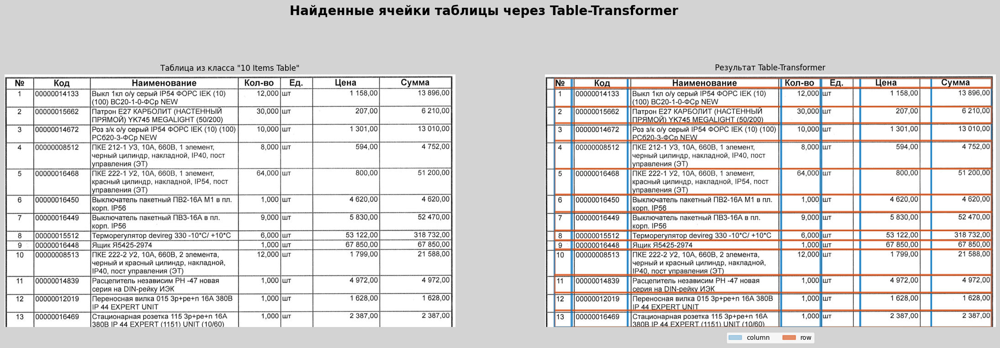

,№,Код,Наименование,Кол-во,Ед.,Цена,Сумма
0,,00000014133,Выкл 1кл о/у серый IР54 ФОРС IЕK (10) 100) BВС20-1-0-ФСр NEW,"12,000",,"1 158,00","13 896,00"
1,2,00000015662,Патрон E27 КАРБОЛИТ (НАСТЕННЫЙ ПРЯМОЙ) YK745 MEGALIGHT (50/200),"30,000",шт,"207,00","6 210,00"
2,3,00000014672,Роз з/к о/у серый IР54 ФОРС IЕK (10) (100) РСб20-3-ФСр NEW,"10,000",шт,"1 301,00","13 010,00"
3,4,00000008512,"ПКЕ 212-1 УЗ, 10A, 660В, 1 элемент, черный цилиндр, накладной, IР40, пост управления (ЭТ)","8,000",шт,"594,00","4 752,00"
4,5,00000016468,"ПКЕ 222-1 У2, 10A, 660В, 1 элемент, красный цилиндр, накладной, IP54, пост управления (ЭТ)","64,000",шт,"800,00","51 200,00"
5,6,00000016450,Выключатель пакетный ПВ2-16A M1 в пл. корп. IР56,"1,000",шт,"4 620,00","620,00"
6,7,00000016449,Выключатель пакетный ПВЗ-16А в пл. корп. IР56,"9,000",шт,"5 830,00","52 470,00"
7,8,00000015512,Терморегулятор devireg 330 -10*C/ +10*C,"6,000",шт,"53 122,00","318 732,00"
8,9,00000016448,Ящик Я5425-2974,"1,000",шт,"67 850,00","67 850,00"
9,10,00000008513,"ПКЕ 222-2 У2, 10A, 660В, 2 элемента, черный и красный цилиндр, накладной, IР40, пост управления (ЭТ)","12,000",шт,"799,00","21 588,00"



========================================== Распознание таблицы (10 Items Table 2) ===========================================
------------------------------------------- Распазнание ячеек таблицы через YOLO --------------------------------------------
*Нет найденных ячеек в таблице*

------------------------------------- Распазнание ячеек таблицы через Table-Transformer -------------------------------------
*Нет найденных ячеек в таблице*

‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒ Финальный датафрейм таблицы ‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒‒


,№,Код,Наименование,Кол-во,Ед.,Цена,Сумма
0,,00000014133,Выкл 1кл о/у серый IР54 ФОРС IЕK (10) (100) ВС20-1-0-ФСр NEW,"12,000",шт,"1 158,00","13 896,00"
1,2,00000015662,Патрон E27 КАРБОЛИТ (НАСТЕННЫЙ ПРЯМОЙ) YK745 MEGALIGHT (50/200),"30,000",шт,"207,00","6 210,00"
2,3,00000014672,Роз з/к о/у серый IP54 ФОРС IЕK (10) (100) РС620-3-ФСр NEW,"10,000",шт,"1 301,00","13 010,00"
3,4,00000008512,"ПКЕ 212-1 УЗ, 10A, 660В, 1 элемент, черный цилиндр, накладной, IР40, пост управления (ЭТ)","8,000",шт,"594,00","4 752,00"
4,5,00000016468,"ПКЕ 222-1 У2, 10A, 660В, 1 элемент, красный цилиндр, накладной, IР54, пост управления (ЭТ)","64,000",шт,"800,00","51 200,00"
5,6,00000016450,Выключатель пакетный ПВ2-16A M1 в пл. корп. IР56,"1,000",шт,"4 620,00","620,00"
6,7,00000016449,Выключатель пакетный ПВЗ-16А в пл. корп. IР56,"9,000",шт,"5 830,00","52 470,00"
7,8,00000015512,Терморегулятор devireg 330 -10*C/ +10*С,"6,000",шт,"53 122,00","318 732,00"
8,9,00000016448,Ящик Я5425-2974,"1,000",шт,"67 850,00","67 850,00"
9,10,00000008513,"ПКЕ 222-2 У2, 10A, 660В, 2 элемента, черный и красный цилиндр, накладной, Р40, пост управления (ЭТ)","12,000",шт,"1 799,00","21 588,00"



========================================== Распознание классов модели yolo_b (OCR) ==========================================
*Нет боксов для распознания OCR*

========================================= Распознание классов модели yolo_b20 (OCR) =========================================
                                08 Counterparty Current Account IIC                                 


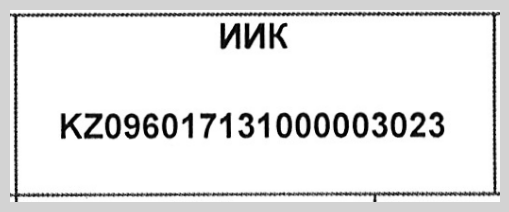

ИИК KZ096017131000003023

                                09 Counterparty Payment Purpose Code                                


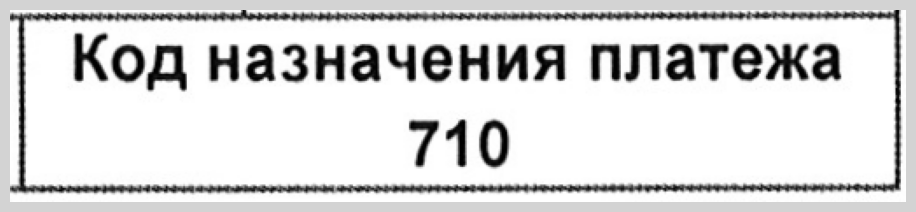

назначения платежа 710 Код

                                      07 Counterparty Bank BIC                                      


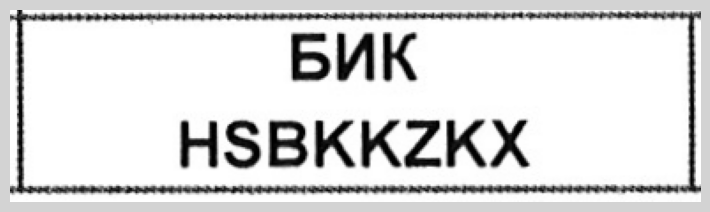

БИК HSBKKZKX

                                           06 Our Company                                           


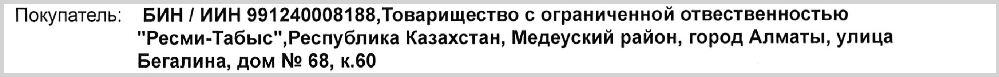

Покупатель: БИН / ИИН 991240008188,Товарищество с ограниченной отвественностью "Ресми-Табыс",Республика Казахстан, Медеуский район, город Алматы, улица Бегалина, дом № 68, к.60

                                        04-02 Counterparty 2                                        


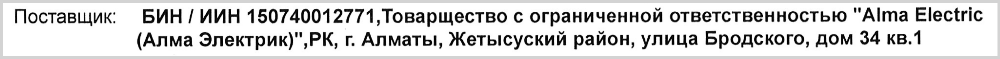

Поставщик: БИН / ИИН 150740012771,Товарщество с ограниченной ответственностью "Alma Electric (Алма Электрик)",РК, г. Алматы, Жетысуский район, улица Бродского, дом 34 кв.1

                                             01 Receipt                                             


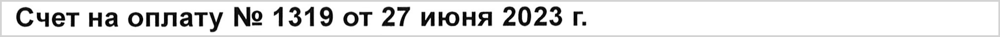

Счет на оплату № 1319 от 27 июня 2023 г.

========================================= Распознание классов модели yolo_b22 (OCR) =========================================
                                           06 Our Company                                           


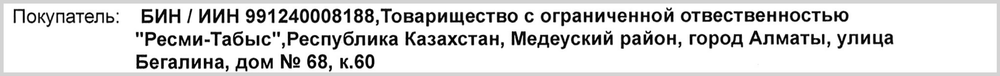

Покупатель: БИН / ИИН 991240008188,Товарищество с ограниченной отвественностью "Ресми-Табыс",Республика Казахстан, Медеуский район, город Алматы, улица Бегалина, дом № 68, к.60

                                            05 Contract                                             


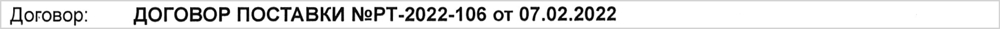

Договор: ДОГОВОР ПОСТАВКИ №PT-2022-106 от 07.02.2022

════════════════════════════════════════════════ Отчёт о постобработке текста из боксов для json файла════════════════════════════════════════════════
─────────────────────────────────────────────────────────────── Словарь без обработки ────────────────────────────────────────────────────────────────
01 Receipt Number : Счет на оплату № 1319 от 27 июня 2023 г.
02 Receipt Date   : Счет на оплату № 1319 от 27 июня 2023 г.
04 Counterparty   :
	04-01 Name        : Поставщик: БИН / ИИН 150740012771,Товарщество с ограниченной ответственностью "Alma Electric (Алма Электрик)",РК, г. Алматы, Жетысуский район, улица Бродского, дом 34 кв.1
	04-02 BIN         : Поставщик: БИН / ИИН 150740012771,Товарщество с ограниченной ответственностью "Alma Electric (Алма Электрик)",РК, г. Алматы, Жетысуский район, улица Бродского, дом 34 кв.1

05 Contract       : Договор: ДОГОВОР ПОСТАВКИ №PT-2022-106 от 07.02.2022
06 Our Company BIN: Покупатель: БИН / ИИН 

In [ ]:
# У класса ResultDisplay есть функция show_all_results, которая показывает все результаты
result_display = ResultDisplay()

for img_cls in context.images:
    result_display.show_all_results(img_cls)